In [1]:
from pathlib import Path
import nibabel as nib
import numpy as np
import os
import sys
import matplotlib.pyplot as plt
from scipy.signal import hilbert
from cmath import phase
# from numpy.linalg import eig as eigenvectors
import pandas as pd
from datetime import date
import random
import matplotlib as mpl
import pickle
import scipy
import mat73
# from statannotations.Annotator import Annotator
import seaborn as sns
from tqdm import tqdm

from numpy.linalg import eigh as eigenvectors #compute real eigenvec and eigenvals (only for symmetric or Hermitian matrices)
from scipy.sparse.linalg import eigsh # BAD - but I don't know why
import networkx as nx
from sklearn import linear_model

# PCA
from sklearn.decomposition import PCA
import pandas as pd

# K-MEANS
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.metrics import homogeneity_score, completeness_score, v_measure_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.mixture import GaussianMixture
from scipy.stats import multivariate_normal as mvn
from sklearn.preprocessing import MinMaxScaler

# Stat test
from scipy.stats import ttest_ind, ttest_1samp, pearsonr
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm

# Similaritys
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial.distance import euclidean
import sklearn

# Normalization
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from scipy.spatial import distance

# from nilearn import plotting
from scipy.cluster.vq import vq
from numpy.linalg import norm

# statistics
import pingouin as pg
from statannotations.Annotator import Annotator

from scipy.stats import zscore
# from scipy.stats import norm # to compute p-value
from sklearn.utils import shuffle

# ENIGMA PLOTS
sys.path.append('../src')
from utils_neuromaps_brain import plot_adjustments, truncate_colormap, normal_view, full_view, compose_full_view

from utils_stat import cohen, annotate_D, conf_int_pval, conf_int_pval_pair
from utils_graph import graph_metrics, modularity_macroareas, cort_subcort_connectivity, homotopic_connectivity
from utils import utri2mat, mov_av_smooth, find_the_min, boool
from utils_plot import plot_ordered_fc
    
# NILEARN
from nilearn import plotting

from skimage.metrics import structural_similarity as ssim

import h5py
from scipy.stats import bootstrap

In [2]:
# Get data path
cwd = Path(os.getcwd())
pardir = str(cwd.parent.absolute())
projdir = os.path.dirname(pardir)
projdir = os.path.dirname(projdir)
pardir, projdir

('/home/alessio/projects/Blindsight_LEIDA', '/home/alessio')

In [3]:
sns.__version__

'0.11.2'

In [4]:
# !pip uninstall seaborn
# # !pip install seaborn==0.11.2 # for statsannotations
# !pip install seaborn==0.13.2 # for annotion over heatmaps

In [5]:
n_sub = 33

# Load pre-computed stuff

In [6]:
# Filterd states per time point
with open('output/AB_15052024/new_state_labels_sub_K.pickle', 'rb') as handle:
    new_state_labels_sub_K = pickle.load(handle)

In [7]:
# Percolation thresholds
with open('output/AB_15052024/boot_percolation_opt_thresh.pickle', 'rb') as handle:
    boot_opt_threshes = pickle.load(handle)

## Load atlas

In [8]:
# Shafer
path = pardir+'/data/atlas/schafer/Schaefer2018_200Parcels_7Networks_plus_TIAN_SC_LGN_order_FSLMNI152_2.4mm.nii.gz'
path_lab = pardir+'/data/atlas/schafer/Schaefer2018_200Parcels_7Networks_plus_TIAN_SC_LGN.csv'
atlas_ = nib.load(path)
atlas = atlas_.get_fdata()
atlas_header = atlas_.header
atlas_affine = atlas_.affine
print(atlas.shape)


atlas_labels = pd.read_csv(path_lab, delimiter=';')
# atlas_labels.rename(columns = {0:'from', 1:'hemisphere',2:'network',3:'super network',4:'area',5:'count'}, inplace = True)
# atlas_labels.replace('Diano', 'Tian', inplace=True)
# bastardi = np.unique(atlas_labels[atlas_labels['from']=='Tian']['network'].values)
# for basta in bastardi:
#     atlas_labels.replace(basta, 'subcortical', inplace=True)
# nodes_labels = atlas_labels['area'].values

# n_area = []
# for n,a in zip(atlas_labels['network'].values, atlas_labels['area'].values):
#     n_area.append(n +'-'+a)
# atlas_labels['n_area'] = n_area

atlas_labels

(75, 90, 75)


,ROI_label,ROI_name,ROI_network,Hemisphere
0,1,LH_Vis_1,Vis,LH
1,2,LH_Vis_2,Vis,LH
2,3,LH_Vis_3,Vis,LH
3,4,LH_Vis_4,Vis,LH
4,5,LH_Vis_5,Vis,LH
...,...,...,...,...
231,232,LH_pCAU,Subcortical,LH
232,233,LH_SC,Subcortical,LH
233,234,RH_SC,Subcortical,RH
234,235,LH_LGN,Subcortical,LH


In [9]:
# atlas_labels.loc[atlas_labels['super network']=='Subcortical']

In [10]:
atlas_labels.columns

Index(['ROI_label', 'ROI_name', 'ROI_network', 'Hemisphere'], dtype='object')

In [11]:
# Divides the nodes in macro areas
# Divide areas for network
net = np.unique(atlas_labels['ROI_network'].values)
net_idx = {}
net_dic = {} # Area index associated to each macro area (as dictionary keys)
net_list = [] # same as mas_dic, but as a concatenation of list
for ne_idx, ne in enumerate(net):
    net_dic[ne] = atlas_labels.index[atlas_labels['ROI_network']==ne].tolist()
    net_list.append(atlas_labels.index[atlas_labels['ROI_network']==ne].tolist())

In [12]:
mas_list = {} # nodes belonging to each of the 18 network (indexes of the nodes)
for n in net: # Loop over network
    mas_list[n] = atlas_labels.loc[atlas_labels['ROI_network']==n].index.values

mas_dic = {} # keys as supernetwork, number of areas per super network as values
for n in net:
    mas_dic[n] = mas_list[n].shape[0]


## - Load phase locking matrices

In [13]:
# Vector indicating subject at each time points
path =pardir + '/data/AB_15052024/time_all.pkl'
with open(path, 'rb') as pickle_file:
    time_all = pickle.load(pickle_file)
print(time_all.shape)


(1, 14223)


In [14]:
# # Load flattened upper triangular Phase Locking matrices
# path =pardir + '/data/MD/PL_upper.pkl'
# with open(path, 'rb') as pickle_file:
#     plm = pickle.load(pickle_file)

# print(plm.shape)
# print(utri2mat(plm[0]).shape)

# # Matrices reconstruction
# plm_tc = np.empty((0, utri2mat(plm[0]).shape[0], utri2mat(plm[0]).shape[1]))
# for tp in plm: # loop over time points:
#     plm_tc = np.concatenate((plm_tc, np.expand_dims(utri2mat(tp), axis=0)))
# print(plm_tc.shape)

# # Open a file and use dump()
# path = pardir + '/data/MD/PL_full.pkl'
# with open(path, 'wb') as file:
#     # A new file will be created
#     pickle.dump(plm_tc, file)

In [15]:
# Load full matrix
path =pardir + '/data/AB_15052024/PL.mat'
PL = mat73.loadmat(path)
# PL = scipy.io.loadmat(path)

In [16]:
plm_tc = np.transpose(PL['PL_all_alessio'], (2,0,1))

In [17]:
T = plm_tc.shape[0]/n_sub
plm_tc.shape

(14223, 236, 236)

### Plottini

In [ ]:
# Cool FC matrix plots

tp = [0,100,400] # time points I want to plot

N=int(atlas.max()) # Number of areas

dic = {}
for i,n in enumerate(np.unique(atlas_labels['super network'].to_numpy())):
    dic[n] = i

super_area_indx = [dic[a] for a in atlas_labels['super network'].to_numpy()]
super_area_indx = np.asarray(super_area_indx)

alpha=1

# Add an additional color for the first 16 elements
colors = [
          mpl.colors.to_rgba('purple',alpha), #Attention
          mpl.colors.to_rgba('lightblue',alpha), #Auditive
          mpl.colors.to_rgba('green',alpha), #Control  
          mpl.colors.to_rgba('violet',alpha),#Default
          mpl.colors.to_rgba('yellow',alpha), #Language
          mpl.colors.to_rgba('orange',alpha), #Somatomotor
          mpl.colors.to_rgba('gray', alpha),  # Subcortical
          mpl.colors.to_rgba('red',alpha), #Visual
         ]

n_bin = np.unique(list(atlas_labels['super network'])).shape[0] # Increment number of bins
cmap_name = 'my_list'
cmap = mpl.colors.LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bin)


# family = atlas_shafer_labels['Super Area'].to_numpy()
family = super_area_indx
# familiy = df_sorted["yeo"].to_numpy()



# Define your labels for each color
groups_labels = ["t="+str(t) for t in tp]
labels = ['ATT', 'AUD', 'CONT', 'DEF', 'LAN', 'SOM', 'SUB','VIS']

matrices = [plm_tc[t] for t in tp] # list of your matrices


vmin = min(matrix.min() for matrix in matrices)
vmax = max(matrix.max() for matrix in matrices)
vtot = max(vmax,abs(vmin))

cmap_ = plt.get_cmap('viridis')
fig, axs = plt.subplots(nrows=1, ncols=len(matrices), figsize=(21, 7))
for i in range(len(matrices)):
    # Plot the matrix
    im = axs[i].imshow(matrices[i], vmin=-vtot, vmax=vtot, cmap='coolwarm')
    axs[i].set_title(groups_labels[i])
    axs[i].set_xticks([])
    axs[i].set_yticks([])

    # Plot the family color bar at the bottom of the matrix
    cax_bottom = axs[i].inset_axes([0, -0.03, 1, 0.05])  # adjust [left, bottom, width, height] as needed
    cax_bottom.imshow(family[np.newaxis, :], aspect='auto', cmap=cmap)
    cax_bottom.set_yticks([])
    cax_bottom.set_xticks([])
    
    
    # Set the boundaries to match your data
    boundaries = [0]  # start with 0
    
    # Add the boundary for the first color
    boundaries.append(16)
    
    # Add the boundaries for the rest of the colors
    for i in range(2, n_bin+1):
        boundaries.append(boundaries[-1] + 10)
    
    # Create a color bar legend with labels
    cax_legend = fig.add_axes([0.92, 0.2, 0.02, 0.6])  # adjust [left, bottom, width, height] as needed
    norm = mpl.colors.BoundaryNorm(boundaries, cmap.N)
    cb = mpl.colorbar.ColorbarBase(cax_legend, cmap=cmap, norm=norm, 
                                   ticks=np.array(boundaries[:-1]) + np.diff(boundaries) / 2,  # set ticks at the middle of boundaries
                                   orientation='vertical')

    cb.set_ticklabels(labels, fontsize=15)  # set fontsize to desired value
    
# Add common colorbar
cbar_ax = fig.add_axes([0.07, 0.2, 0.01, 0.65]) # Adjust as necessary.
fig.colorbar(im, cax=cbar_ax, orientation='vertical')

plt.savefig('output/MD_05122023/PL_matrix.png',
            dpi=200)

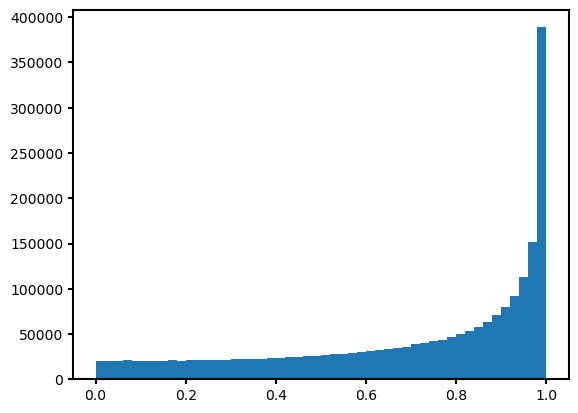

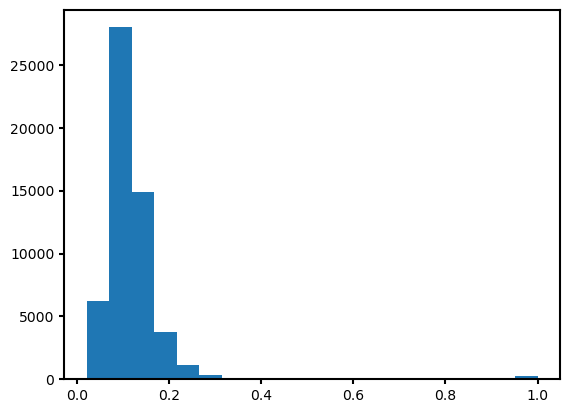

In [85]:
# The phase locking matrices assume values between -1 and 1. When I perform percolation, the threshold has to start from -1
fig = plt.figure()
plt.hist(np.abs(plm_tc[0:40]).flatten(), bins=50);
# plt.hist(np.abs(plm_tc[0:40]).mean(axis=0).flatten(), bins=50);

# PERCHè AVEVO THRESHOLDATO LE MATRICI DI PHASE LOCKING?


ex = np.copy(np.abs(plm_tc[0:600]))
ex[np.where(ex<0.99)] = 0
fig = plt.figure()
plt.hist(ex.mean(axis=0).flatten(), bins=20);

# Load eigenvector decomposition

In [18]:
# # Load eigenvectors
# path =pardir + '/data/MD_13112023/LEiDA_data.mat'
path = pardir + '/data/AB_15052024/data_V1.mat'
# Ev_ = mat73.loadmat(path)
Ev_ = scipy.io.loadmat(path)

In [19]:
Ev = Ev_['data']
print(Ev.shape)

(14223, 236)


### Plottini

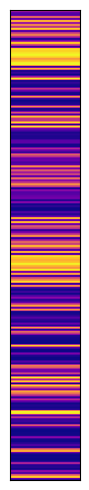

In [49]:
x = [m for m in range(Ev[200].shape[0])]
y = Ev[200]

fig, ax = plt.subplots(nrows=1, figsize=(1,5))

extent = [x[0]-(x[1]-x[0])/2., x[-1]+(x[1]-x[0])/2.,0,1]
ax.imshow(np.expand_dims(y, axis=1), cmap="plasma", aspect="auto", extent=extent)
ax.set_yticks([])
ax.set_xticks([])

ax.set_xlim(extent[0], extent[1])
plt.tight_layout()

# plt.savefig('output/GraphAnal/EigenVector_example.png', dpi=200)


## Subjects classification

In [20]:
classif = pd.read_excel(pardir+'/data/AB_15052024/davide_class_blindsight.xlsx')
# classif.drop(labels='Unnamed: 3', axis=1, inplace=True)
# new = classif['NEW ID'].values
# old = classif['OLD ID'].values
group = classif['CLASS'].values
time_points = int(time_all.shape[1]/len(group))
group_dic = {'C':0, 'B':1, 'NB':2}

groups_num = []
for idx,g in enumerate(['C', 'B', 'NB']):
    groups_num.append(np.sum(group==g))

# Group label for each time point
group_labels = np.empty((0, 1))  # [t*1]
# for c in group:
for c in group:
    cc = group_dic[c]
    sub_lab = np.full((time_points,1), cc)
    group_labels = np.concatenate((group_labels, sub_lab))
print(group_labels.shape)

# # Remove bad subjects
# new_V1 = np.empty((0, n_rois))
# for i in old:
#     m = V1[time_points*i:time_points*(i+1),:]
#     new_V1 = np.concatenate((new_V1, m))
# print(new_V1.shape)

(14223, 1)


In [21]:
classif

,NEW ID,OLD ID,FILE,CLASS,ID,gabor all,Average % correct task,Average % correct control
0,0,0,H001_rest_STD_ants.nii.gz,B,H001,NaN,100.0,NaN
1,1,1,H002_rest_STD_ants.nii.gz,NB,H002,NaN,35.0,NaN
2,2,2,H005_rest_STD_ants.nii.gz,NB,H005,NaN,60.0,NaN
3,3,3,H006_rest_STD_ants_flipped.nii.gz,NB,H006,NaN,55.0,NaN
4,4,4,H008_rest_STD_ants_flipped.nii.gz,B,H008,NaN,85.0,NaN
5,5,5,H009_rest_STD_ants.nii.gz,NB,H009,NaN,55.0,NaN
6,6,6,H010_rest_STD_ants_flipped.nii.gz,NB,H010,NaN,65.0,NaN
7,7,7,R006_rest_STD_ants.nii.gz,NB,R006,NaN,40.0,NaN
8,10,8,R011_rest_STD_ants.nii.gz,NB,R011,NaN,65.0,NaN
9,11,9,R013_rest_STD_ants_flipped.nii.gz,NB,R013,NaN,45.0,NaN


In [22]:
subjects_code = classif['ID'].values
subjects_group = classif['CLASS'].values
n_sub = len(subjects_code)

In [23]:
subjects_group

array(['B', 'NB', 'NB', 'NB', 'B', 'NB', 'NB', 'NB', 'NB', 'NB', 'B', 'B',
       'B', 'B', 'B', 'B', 'C', 'C', 'C', 'C', 'C', 'C', 'C', 'C', 'C',
       'C', 'C', 'C', 'C', 'C', 'C', 'C', 'C'], dtype=object)

# Load K-means results

In [24]:
# state_labels
path = pardir + '/data/AB_15052024/clustering_res.mat'
kmeans_leida_ = mat73.loadmat(path)
print(kmeans_leida_.keys())
kmeans_leida = kmeans_leida_['Kmeans_results']
# kmeans_leida = kmeans_leida_['Kmeans_results']
K_max = len(kmeans_leida) + 3
print(kmeans_leida[0].keys())

dict_keys(['Kmeans_results', 'mal_dist_kmean'])
dict_keys(['C', 'D', 'IDX', 'SUMD'])


In [25]:
# K = 6
# k = K - 2 # MD start to cluster from K=2
# # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
# state_labels = kmeans_leida[k]['IDX']
# print(state_labels.shape, state_labels.max())
# centroids = kmeans_leida[k]['centers']
# print(centroids.shape)

# Centroid representation

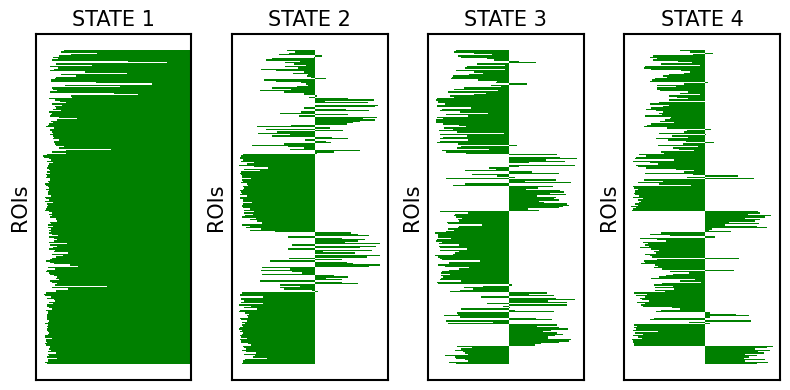

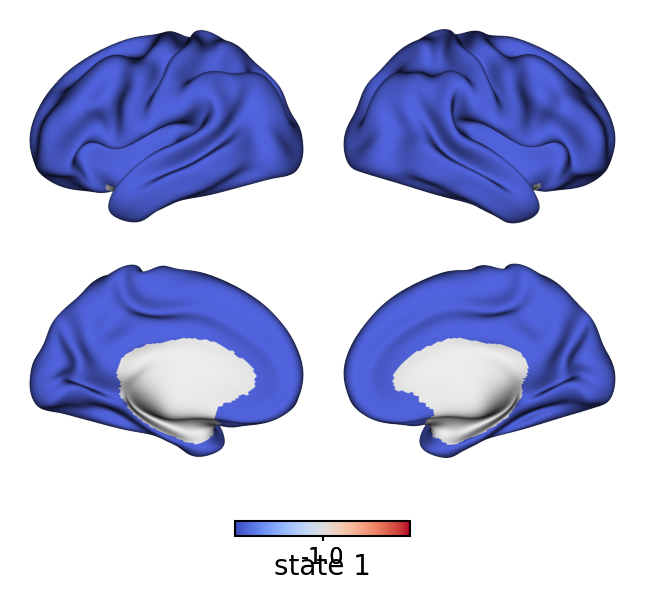

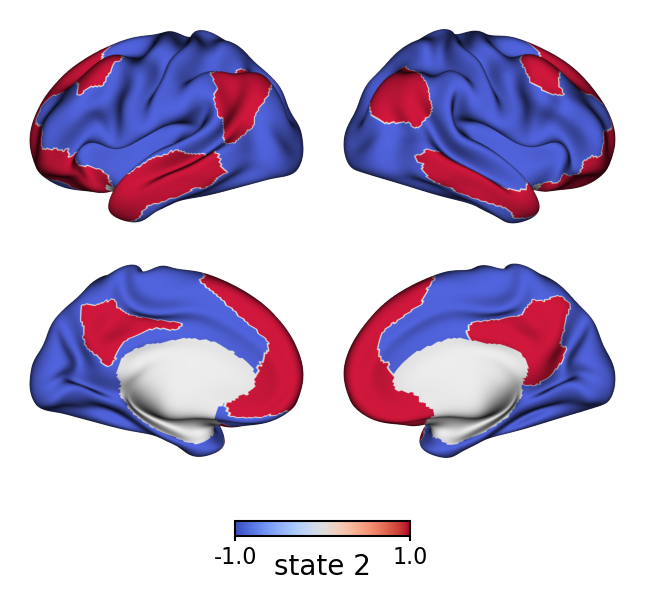

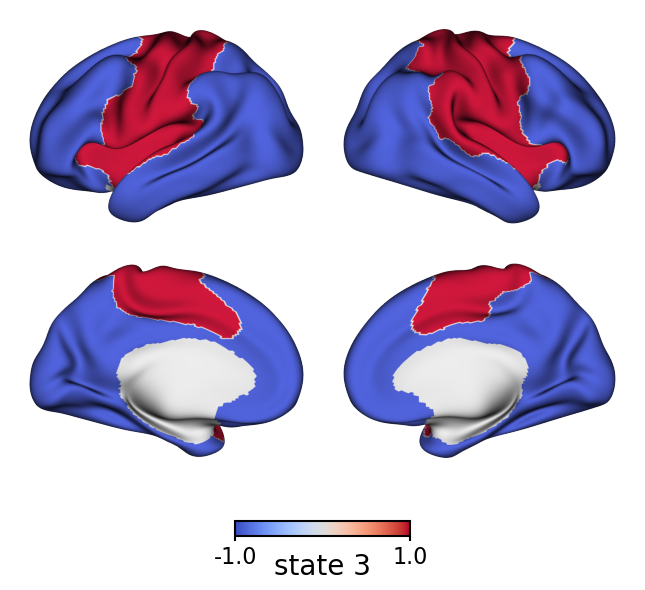

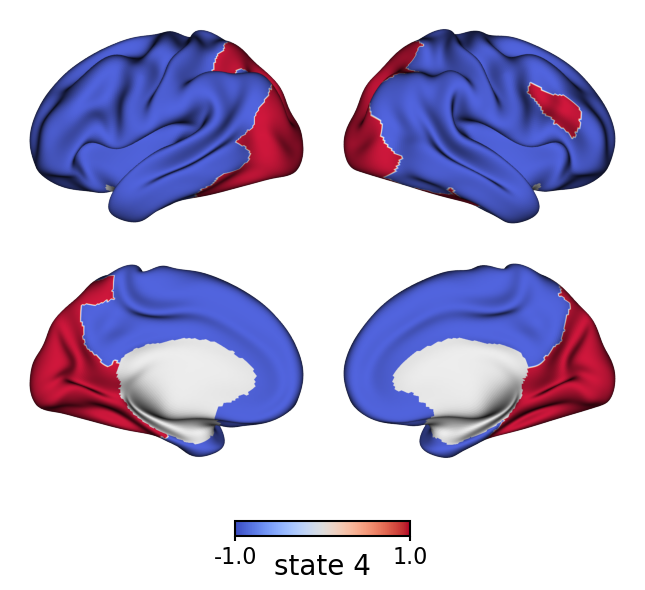

In [78]:
###############################
### Centroids visualization ###
###############################
cmap_ ='PiYG'
cmap_ ='coolwarm'

K = 4
k = K-2
kmeans_leida[k].keys()
centroids = kmeans_leida[k]['C']

# PLot CENTROIDS
fig, axs = plt.subplots(1, K, figsize=(8,4))
for i,ax in enumerate(axs.flat):
    ax.set_title('STATE {}' .format(i+1), fontsize=15)
    # ax.barh(range(centroids[k_].shape[0]), -centroids[k_], height=1);
    # #              tick_label=nodes_labels)
    ax.barh(range(centroids[i].shape[0]), centroids[i], height=1, color='green');
    # ax.barh(range(centroids[i].shape[0]), centroids[i], height=1, color='purple');
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_ylabel('ROIs', fontsize=15)
    fig.tight_layout()   

for i in range(K):
    # ax.set_title('STATE {}' .format(i+1), fontsize=15)
    # ax.barh(range(centroids[k_].shape[0]), -centroids[k_], height=1);
    # #              tick_label=nodes_labels)
    centroids_ = np.empty((236,))
    centroids_[np.where(centroids[i]>0)[0]] = 1
    centroids_[np.where(centroids[i]<=0)[0]] = -1
    normal_view(centroids_[:200], parcellation_name='schaefer', parcellation=200, surftype='inflated', cmap=cmap_,
                q_thresh=0.02, center_cbar=False, exp_form=False, xlabel='state '+str(i+1) )


In [80]:
# Subcortical in the states?
for i in range(K):
    print(np.sum(centroids[i][200:]>0))


0
3
3
2


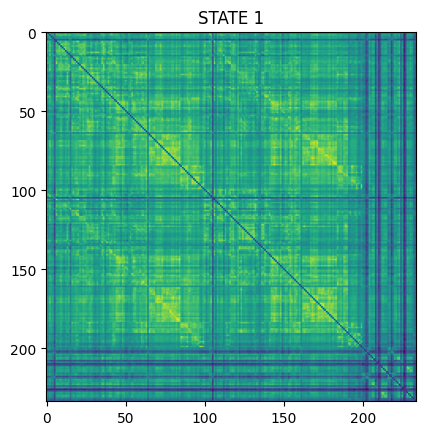

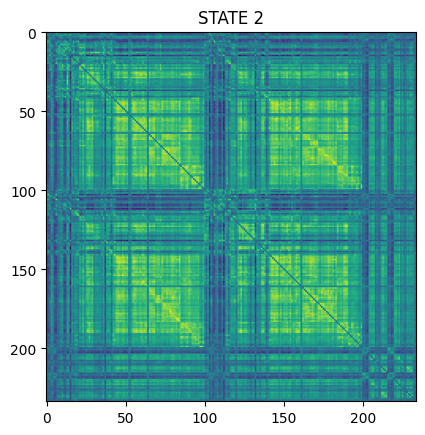

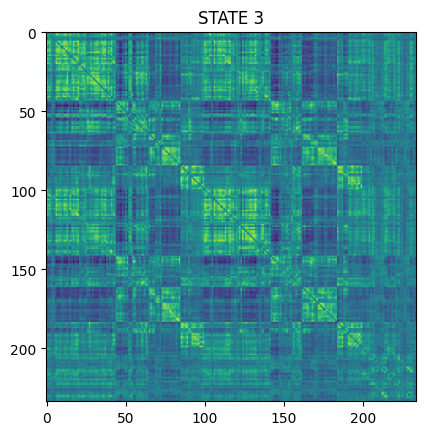

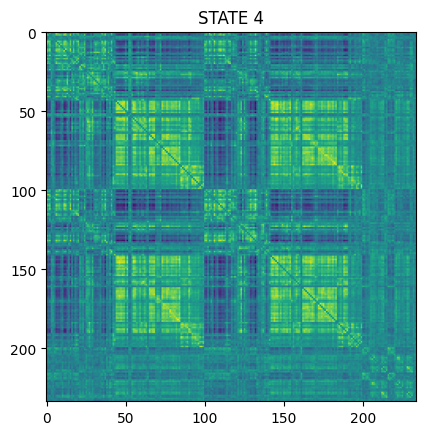

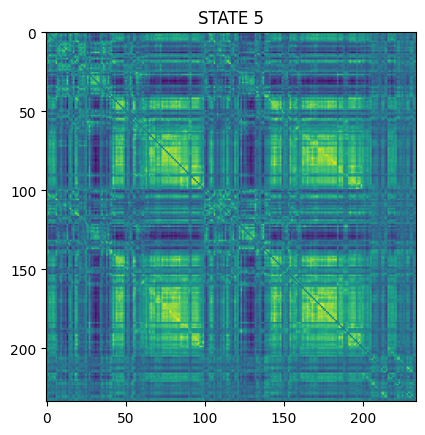

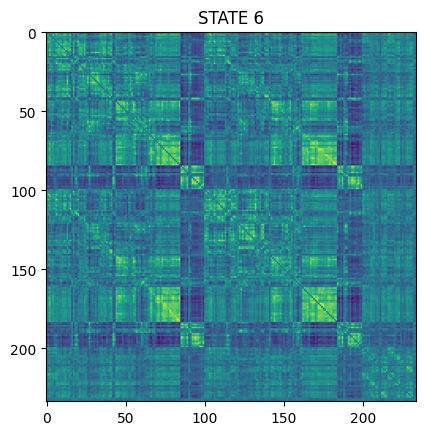

In [771]:
for i in range(K):
    fig = plt.figure()
    whe = np.where(state_labels==i+1)
    plt.imshow(np.mean(plm_tc[whe], axis=0))
    plt.title('STATE '+str(i+1))
    plt.savefig('output/GraphAnal/26092023/K'+str(K)+'/Average_PL_K'+str(i+1)+'.png', dpi=200)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

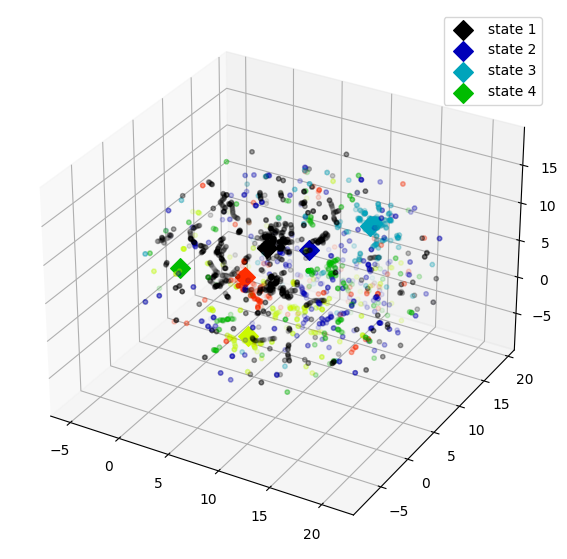

In [29]:
# import umap
fit = umap.UMAP(n_components=3)
X_embedded = fit.fit_transform(Ev, state_labels)
C_embedded = fit.transform(centroids)

# pca = sklearn.decomposition.PCA(n_components=3)
# X_embedded = pca.fit_transform(Ev)
# C_embedded = pca.transform(centroids)

lab = ['state 1', 'state 2', 'state 3','state 4']


# 3D
fig = plt.figure(figsize=(8,7))
ax = fig.add_subplot(projection='3d')
for i in range(K):
    ax.scatter3D(C_embedded[i,0], C_embedded[i,1], C_embedded[i,2], s=100, alpha=1, c=colors[i], marker='D')
plt.legend(lab)
ax.scatter(X_embedded[:,0], X_embedded[:,1], X_embedded[:,2], s=10, alpha=.03, c=colors_series)


# # 2D
# fig = plt.figure(figsize=(8,7))
# for i in range(K):
#     plt.scatter(C_embedded[i,0], C_embedded[i,1], s=80, alpha=1, c=colors[i])
# plt.legend(lab)
# plt.scatter(X_embedded[:,0], X_embedded[:,1], s=1, alpha=.3, c=state_labels, cmap='jet')

# plt.savefig('output/GraphAnal/tp_representation_PCA.png', dpi=200)

# Chose a threshold for Mahalanobis distance

## Group-wise

In [226]:
mal_dist_kmean = kmeans_leida_['mal_dist_kmean'] # List with 9 elements, k from 2 to 10
kmean_res = kmeans_leida_['Kmeans_results']

In [83]:
%%time
mal_dist_kmean_ = np.copy(mal_dist_kmean)
thresholds = [0,1,2]
silhouette_allstates = []
n_of_vec_allstates = []
thresholds_allstates = []
n_of_vec_perstate_allstates = []
for k_,mal_dist in enumerate(mal_dist_kmean): # Loop over number of states
    thresholds_ = np.linspace(min,max,n)[::-1]
    silhouette = []
    n_of_vec = []
    n_of_vec_perstate = []
    thresholds = []
    if k_==4-2:
        print(k_+2, ' STATE')
        # mal_dist is a dict: 'IDX' represent the state of each time point, 'raw' represent the the distance of each time
        # point (grouped by state) from it's centroid.
    
        # COMPUTE THE RANGE FOR THE DISTANCE THRESHOLD
        max = 0
        min = 10000000
        for s in mal_dist['raw']: # Loop over the states
            # print(len(s['k']))
            if s['k'].max() > max:
                max = s['k'].max()
            if s['k'].min() < min:
                min = s['k'].min()
            # print(s['k'].shape, max,min)
    
        # DEFINE THRESHOLD VALUES
        n = 1000
    
        empty_state = False
        for pi,thresh in enumerate(thresholds_):
            if pi%100==0:
                print(pi, '/'+str(n))
            idx = np.empty((0,), dtype=np.dtype(int)) # I have to concatenate together the idexes of each state
            state_idx = np.empty((0,), dtype=np.dtype(int))
            perstate = [] # number of vec left in each state
            for s_i,s in enumerate(mal_dist['raw']): # Loop over the states
                pos = np.where(s['k']<thresh)[0] # which points have a distance below the thresholds
                idx_ = s['kind'][pos].astype(int) # Indx of the tp with respect to the concatenated indexing
                idx_ = [m-1 for m in idx_] # -1 Because indexing in s['kind'] start from 1
                state_idx_ = mal_dist['IDX'][idx_].astype(int) # state index of the points (eigenvectors) below the threshold
                # print(np.asarray(idx_).shape, state_idx_.shape)
                if len(idx_)!=0:
                    idx = np.concatenate((idx, idx_), dtype=np.dtype(int))
                    state_idx = np.concatenate((state_idx, state_idx_), dtype=np.dtype(int))
                    perstate.append(state_idx_.shape)
                else:
                    empty_state = True
            # print(idx.shape, state_idx.shape)
    
            # compute silhouette score
            if not empty_state:
                silhouette.append(silhouette_score(Ev[idx], state_idx))
                n_of_vec.append(idx.shape[0])
                thresholds.append(thresh)
                n_of_vec_perstate.append(perstate)
            else:
                break
                # When I reach a threshold which empty at least a state I step to explores the threshold values

    silhouette_allstates.append(silhouette)
    n_of_vec_allstates.append(n_of_vec)
    thresholds_allstates.append(thresholds)
    n_of_vec_perstate_allstates.append(n_of_vec_perstate)
    # print('\n')
with open('output/AB_15052024/dist_opt_silhouette_allstates.pickle', 'wb') as handle:
    pickle.dump(silhouette_allstates, handle, protocol=pickle.HIGHEST_PROTOCOL)
with open('output/AB_15052024/dist_opt_n_of_vec_allstates.pickle', 'wb') as handle:
    pickle.dump(n_of_vec_allstates, handle, protocol=pickle.HIGHEST_PROTOCOL)
with open('output/AB_15052024/dist_opt_thresholds_allstates.pickle', 'wb') as handle:
    pickle.dump(thresholds_allstates, handle, protocol=pickle.HIGHEST_PROTOCOL)
with open('output/AB_15052024/dist_opt_n_of_vec_perstate_allstatess.pickle', 'wb') as handle:
    pickle.dump(n_of_vec_perstate_allstates, handle, protocol=pickle.HIGHEST_PROTOCOL)

4  STATE
0 /1000
100 /1000
200 /1000
300 /1000
400 /1000
500 /1000
600 /1000
700 /1000
800 /1000
CPU times: user 1h 8s, sys: 4h 22s, total: 5h 30s
Wall time: 30min 27s


In [85]:
with open('output/AB_15052024/dist_opt_silhouette_allstates.pickle', 'rb') as handle:
    silhouette_allstates = pickle.load(handle)
with open('output/AB_15052024/dist_opt_n_of_vec_allstates.pickle', 'rb') as handle:
    n_of_vec_allstates = pickle.load(handle)
with open('output/AB_15052024/dist_opt_thresholds_allstates.pickle', 'rb') as handle:
    thresholds_allstates = pickle.load(handle)
with open('output/AB_15052024/dist_opt_n_of_vec_perstate_allstatess.pickle', 'rb') as handle:
    n_of_vec_perstate_allstates = pickle.load(handle)

In [84]:
# for i, thresholds in enumerate(thresholds_allstates):
#     fig, (ax1, ax3) = plt.subplots(1,2, figsize=(10,2.5))
#     plt.suptitle('K = '+str(i+2))
#     ax1.plot(thresholds, silhouette_allstates[i], color='tab:blue', linewidth=3)
#     ax1.set_ylabel('Silhouette', fontsize=15, color='tab:blue')
#     ax1.tick_params(axis='y', labelcolor='tab:blue')
#     ax2 = ax1.twinx()
#     ax2.plot(thresholds, n_of_vec_allstates[i], color='tab:red', linewidth=3)
#     # ax2.invert_yaxis()
#     ax2.set_ylabel('# of vec inside clusters', fontsize=12, color='tab:red')
#     ax2.tick_params(axis='y', labelcolor='tab:red')
#     ax1.set_xlabel('Distance threshold', fontsize=15)

#     for k__,n_of_vec_perstate in enumerate(np.asarray(n_of_vec_perstate_allstates[i])[:,:,0].transpose()):
#         ax3.plot(thresholds, n_of_vec_perstate/n_of_vec_perstate[0], label='state '+str(k__+1))
#     ax3.set_xlabel('Distance threshold', fontsize=15)
#     ax3.set_ylabel('frac of vec left', fontsize=12)
#     ax3.yaxis.tick_right()
#     ax3.yaxis.set_label_position("right")
#     ax3.legend(loc='lower right')
#     plt.subplots_adjust( 
#                         wspace=0.4, 
#                         hspace=0.4)
        
#     # fig.tight_layout

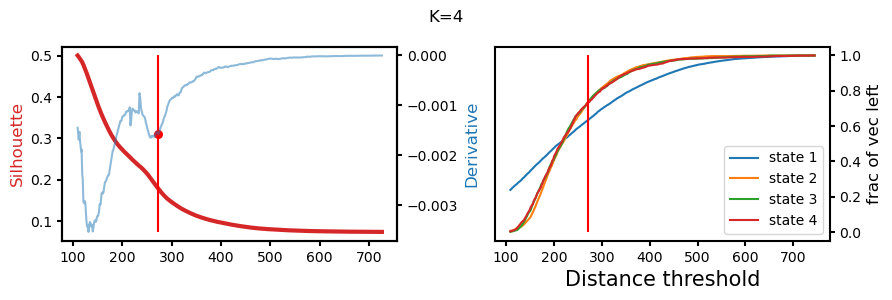

In [86]:
# Compute the optimal threshold
# Maybe it's better if I smooth the silhouette curve before
tol = 0.00001
win = 25
opt_threshes_norm = []
for i, thresholds in enumerate(thresholds_allstates):
    x_norm = 0
    if i==K-2:
        x = thresholds
        y = silhouette_allstates[i] # curves
        x_, y_smooth = mov_av_smooth(x, y, win)
        dydx = np.gradient(y_smooth, x_) # first derivative
        # d2ydx2 = np.gradient(dydx, x) # second derivative
        # x_,dydx_ = mov_av_smooth(x, dydx, win) # smoothed first derivative
        # d2ydx2_ = np.gradient(dydx_, x_) # derivative of the smoothed first derivative
    
        x_min, y_min = find_the_min(x_,dydx, tol)
        x_norm = (x_min-np.min(thresholds))/(np.max(thresholds)-np.min(thresholds)) # min-max normalization
        
    
        # fig = plt.figure()
        # plt.plot(x,y)
        # plt.plot(x_, y_smooth)
        
        fig,axs = plt.subplots(1,2, figsize=(9,3))
        fig.suptitle('K='+str(i+2))
        axs[0].plot(x_,y_smooth, color='tab:red', linewidth=3)
        # axs.plot(x_,dydx_, linewidth=2, color='tab:blue')
        axs[0].set_ylabel('Silhouette', fontsize=12, color='tab:red')
        axs[0].vlines(x_min, np.min(y_smooth), np.max(y_smooth), color='r')
        ax = axs[0].twinx()
        ax.plot(x_, dydx, alpha=0.5)
        ax.set_ylabel('Derivative', fontsize=12, color='tab:blue')
        ax.set_xlabel('Threshold', fontsize=12)
        ax.scatter(x_min, y_min, s=30, color='r')
        # axs.plot(x,d2ydx2, alpha=0.5)
        # axs.plot(x_,d2ydx2_, linewidth=2, color='tab:blue')
        plt.tight_layout()
        # plt.savefig('output/MD_05122023/dist_thresh_sil_K'+str(i+2)+'_state.png',
        #             dpi=200)
    
        for k__,n_of_vec_perstate in enumerate(np.asarray(n_of_vec_perstate_allstates[i])[:,:,0].transpose()):
            axs[1].plot(thresholds, n_of_vec_perstate/n_of_vec_perstate[0], label='state '+str(k__+1))
        axs[1].set_xlabel('Distance threshold', fontsize=15)
        axs[1].set_ylabel('frac of vec left', fontsize=12)
        axs[1].yaxis.tick_right()
        axs[1].yaxis.set_label_position("right")
        axs[1].legend(loc='lower right')
        axs[1].vlines(x_min, 0,1, color='r')
        plt.subplots_adjust( 
                            wspace=0.4, 
                            hspace=0.4)
    
        plt.tight_layout(pad=1.0)

    # plt.savefig('output/MD_05122023/dist_thresh_sil_K'+str(i+2)+'_state_with_frac.png',
    #             dpi=200)
    opt_threshes_norm.append(x_norm) 
# with open('output/MD_05122023/dist_opt_threshes_n'+str(n)+'.pickle', 'wb') as handle:
#     pickle.dump(opt_threshes, handle, protocol=pickle.HIGHEST_PROTOCOL)
with open('output/AB_15052024/dist_opt_threshes_n'+str(n)+'_norm.pickle', 'wb') as handle:
    pickle.dump(opt_threshes_norm, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [87]:
with open('output/AB_15052024/dist_opt_threshes_n1000_norm.pickle', 'rb') as handle:
    opt_threshes_norm = pickle.load(handle)

In [56]:
# # Define new state indexes, with points above the threshold assigned to the baseline state
# state_labels_list = [] # State indexes for each state
# for k_,mal_dist in enumerate(mal_dist_kmean): # Loop over number of states
#     thresh = opt_threshes[k_]
#     idx = np.empty((0,))
#     for s_i,s in enumerate(mal_dist['raw']): # Loop over the states
#         pos = np.where(s['k']>thresh)[0] # which points have a dist above the thresholds - they become part of the baseline state
#         idx_ = s['kind'][pos].astype(int) # Indx of the tp with respect to the concatenated indexing
#         idx_ = [int(m-1) for m in idx_] # -1 Because indexing in s['kind'] start from 1
#         idx = np.concatenate((idx_, idx), axis=0)
#     # print(np.asarray(idx).astype(int).shape)
#     # print(np.unique(k['IDX']))
#     state_idx = np.array([s for s in kmean_res[k_]['IDX']]) # state index
#     state_idx[np.array(idx).astype(int)] = 0
#     # print(np.unique(state_idx))
#     state_labels_list.append(state_idx)

## Subject-wise analysis

In [211]:
mal_dist_kmean = kmeans_leida_['mal_dist_kmean'] # List with 9 elements, k from 2 to 10
kmean_res = kmeans_leida_['Kmeans_results']

In [225]:
%%time
# thresholds = [0,1,2]
print('cane')

mal_dist_kmean_ = np.copy(mal_dist_kmean)
silhouette_sub_K = []
n_of_vec_sub_K = []
thresholds_sub_K = []
n_of_vec_perstate_sub_K = []
for k_,mal_dist in enumerate(mal_dist_kmean_): # Loop over number of states
    silhouette_sub = []
    n_of_vec_sub = []
    thresholds_sub = []
    n_of_vec_perstate_sub = []
    if k_==4-2:
        print(k_+2, ' STATE')
        state_labels = np.copy(kmeans_leida[k_]['IDX']) # Index of the state for each time point
        # mal_dist is a dict: 'IDX' represent the state of each time point, 'raw' represent the the distance of each time
        # point (grouped by state) from it's centroid.
    
        # # COMPUTE THE RANGE FOR THE DISTANCE THRESHOLD
        # max = 0
        # min = 10000000
        # for s in mal_dist: # Loop over the states
        #     # print(len(s['k']))
        #     if s['k'].max() > max:
        #         max = s['k'].max()
        #     if s['k'].min() < min:
        #         min = s['k'].min()
        #     # print(s['k'].shape, max,min)

        # CONCATENATE ALL THE STATES
        all_k = np.empty((0,)) # Here I store the distance value of each time point
        all_kind = np.empty((0,)) # Here I store the index of each time point with respect to the the whole time series of concatenated subjects
        for s in mal_dist['raw']: # Loop over the states
            all_k = np.concatenate((all_k, s['k']), axis=0)
            all_kind = np.concatenate((all_kind, s['kind']), axis=0)

        print(all_k.shape, all_kind.shape)
        # REORDER THE TIME SERIES
        right_order = np.argsort(all_kind)
        all_kind_orederd = all_kind[right_order]
        all_k_ordered = all_k[right_order]
    
        # DEFINE THRESHOLD VALUES
        n = 1000
        thresholds_ = np.linspace(min,max,n)[::-1]
    
        
        for sub in range(n_sub):
            print('SUB - '+subjects_code[sub])
            sub_dist = all_k_ordered[int(sub*T):int((sub+1)*T)] # single subject distance-per-time point
            sub_state = state_labels[int(sub*T):int((sub+1)*T)] # single subject state per time point
            if subjects_code[sub]=='R024':
                print(sub_dist[np.where(sub_state==4)[0]])
            sub_Ev = Ev[int(sub*T):int((sub+1)*T)]
            # print(sub_dist.shape, sub_state.shape)
            silhouette = []
            n_of_vec = []
            n_of_vec_perstate = [[] for _ in range(k_+2)]
            threshold = []
            empty_state = False
            for pi,thresh in enumerate(thresholds_):
                ## Progress bar
                # if pi%500==0:
                #     print(pi, '/'+str(n))
                    
                # for st in range(k_+2): # Loop over the states
                pos = np.where(sub_dist<thresh)[0] # which points have a distance below the thresholds
                # idx = s['kind'][pos].astype(int) # Indx of the tp with respect to the concatenated indexing
                # idx = [m-1 for m in idx] # -1 Because indexing in s['kind'] start from 1
                state_idx = sub_state[pos].astype(int) # state index of the points (eigenvectors) below the threshold
                # print(np.asarray(pos).shape, np.asarray(state_idx).shape)
    
                states_sum = []
                states_sum_all = 0
                for st in range(k_+2): # Loop over the states
                    # Check if one of the state has no more time points
                    states_sum.append(np.sum(state_idx==st+1))
                    states_sum_all += np.sum(state_idx==st+1)
                if any(np.asarray(states_sum)==0):
                    empty_state=True
                    print(thresh)
                    print(states_sum)
                    
                else:
                    for st, pino in enumerate(states_sum):
                        n_of_vec_perstate[st].append(pino)
                        
        
                # compute silhouette score
                if not empty_state:
                    silhouette.append(silhouette_score(sub_Ev[pos], state_idx))
                    n_of_vec.append(pos.shape[0])
                    threshold.append(thresh)
                else:
                    break
                    # When I reach a threshold which empty at least a state I step to explores the threshold values
        
            silhouette_sub.append(silhouette)
            n_of_vec_sub.append(n_of_vec)
            thresholds_sub.append(threshold)
            n_of_vec_perstate_sub.append(n_of_vec_perstate)
    silhouette_sub_K.append(silhouette_sub)
    n_of_vec_sub_K.append(n_of_vec_sub)
    thresholds_sub_K.append(thresholds_sub)
    n_of_vec_perstate_sub_K.append(n_of_vec_perstate_sub)

cane
4  STATE
(14223,) (14223,)
SUB - H001
156.49451069855297
[38, 4, 8, 0]
SUB - H002
200.0587148034568
[24, 67, 0, 13]
SUB - H005
226.73067650033673
[64, 40, 46, 0]
SUB - H006
136.04600673094507
[6, 0, 1, 1]
SUB - H008
312.9700193202484
[304, 31, 0, 6]
SUB - H009
226.73067650033673
[91, 58, 52, 0]
SUB - H010
162.71796842782496
[4, 5, 0, 27]
SUB - R006
220.50721877106474
[306, 0, 11, 8]
SUB - R011
272.96207677492856
[309, 35, 34, 0]
SUB - R013
137.82413751073705
[47, 0, 4, 6]
SUB - R014
244.51198429825664
[217, 110, 0, 2]
SUB - R017
134.26787595115306
[54, 25, 0, 2]
SUB - R018
174.2758184964729
[58, 0, 7, 22]
SUB - R020
160.93983764803298
[45, 15, 0, 14]
SUB - R023
218.72908799127273
[238, 39, 0, 19]
SUB - R024
[270.04588405 232.43766895 217.94542748 224.80747863 244.48023763]
217.84002260137675
[247, 95, 3, 0]
SUB - 23M
169.83049154699293
[231, 15, 0, 13]
SUB - 24F
216.06189182158477
[0, 29, 19, 106]
SUB - 32M
156.49451069855297
[143, 0, 37, 17]
SUB - 41F
220.50721877106474
[27, 0, 3

H001 347.69079470856553
H002 380.08726981660027
H005 399.9218464133562
H006 332.48428598438596
H008 464.0536440762004
H009 399.9218464133562
H010 352.31886258114196
R006 395.29377854077984
R011 434.30177918106654
R013 333.8065910908364
R014 413.1448974778602
R017 331.16198087793555
R018 360.9138457730695
R020 350.9965574746915
R023 393.97147343432937
R024 393.3103208811042
23M 357.6080830069435
24F 391.98801577465383
32M 347.69079470856553
41F 395.29377854077984
69M 382.73188002950104
71M 385.3764902424018
73M 374.79804939079867
112SUB 393.3103208811042
164SUB 348.3519472617907


/tmp/ipykernel_905427/392189856.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax3) = plt.subplots(1,2, figsize=(10,2.5))


C001 462.07018641652485
C002 460.74788131007443
C003 651.1598166389316
C004 551.9869336551518
C005 355.6246253472679
C006 325.21160789890877
C007 331.8231334311607
C008 342.40157428276393


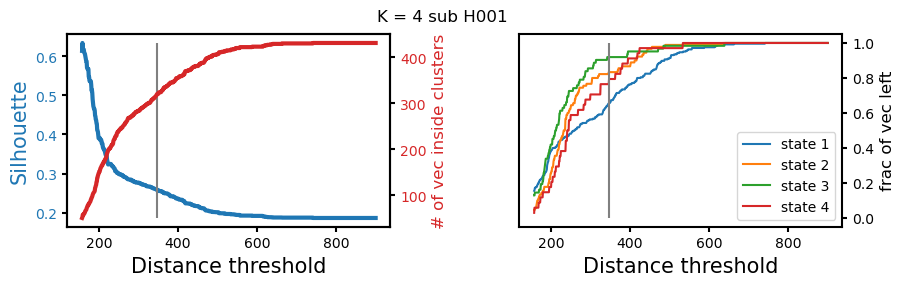

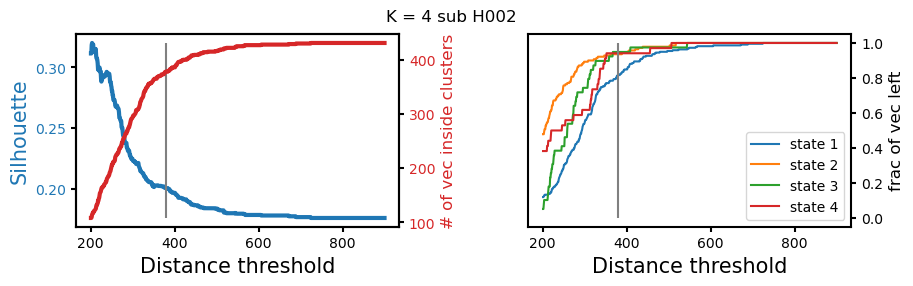

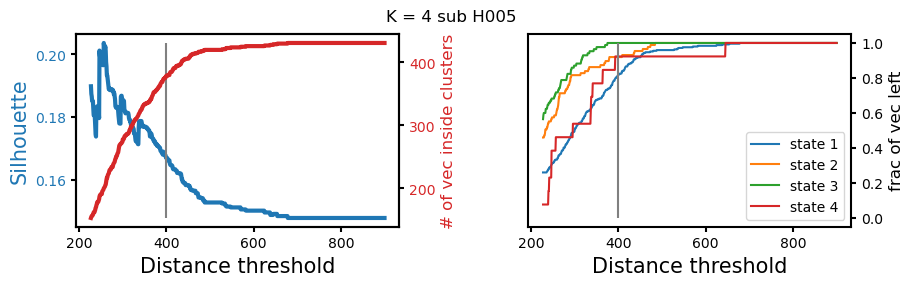

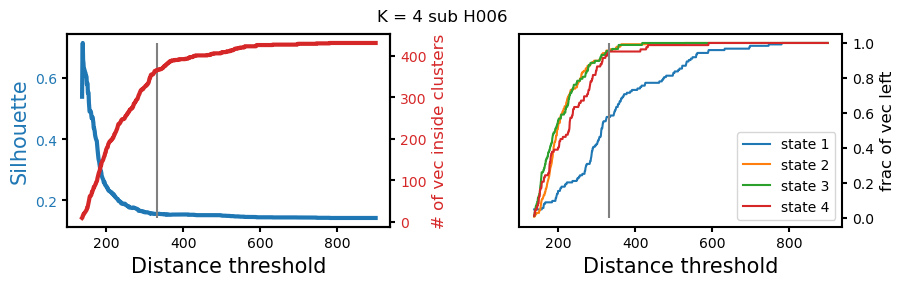

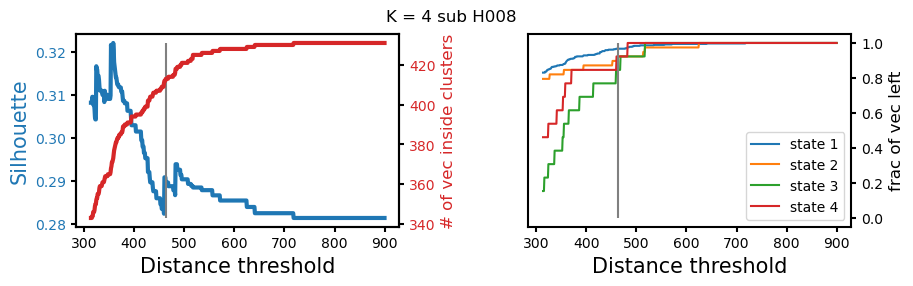

...

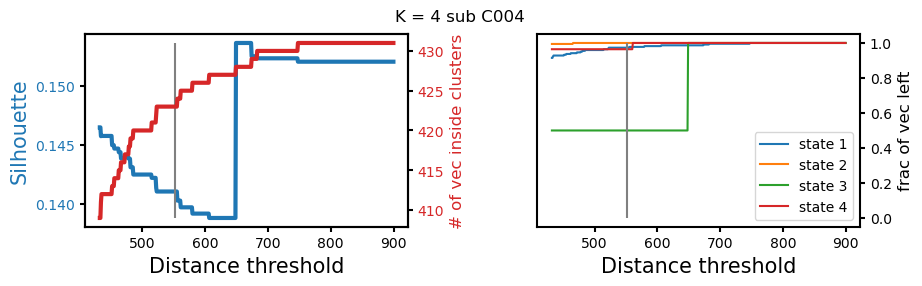

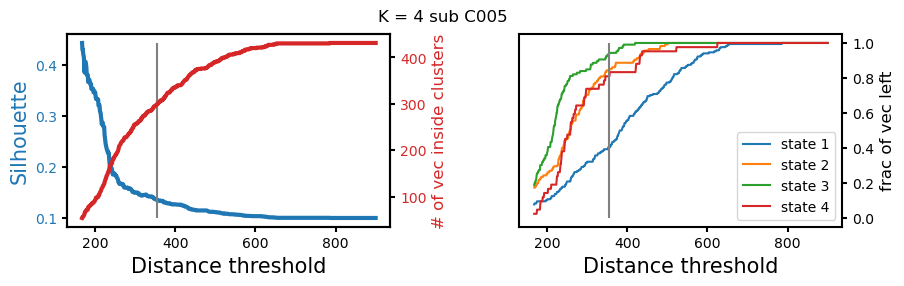

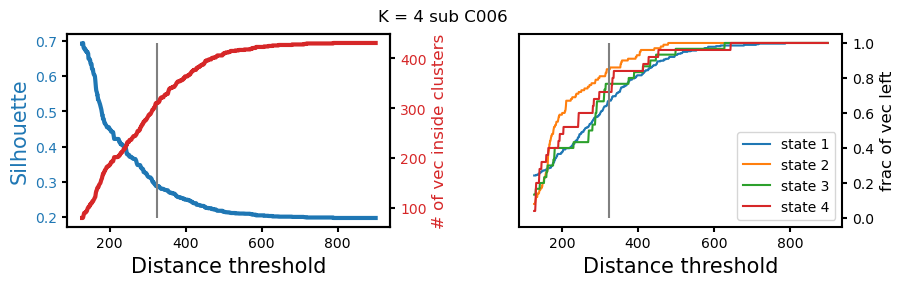

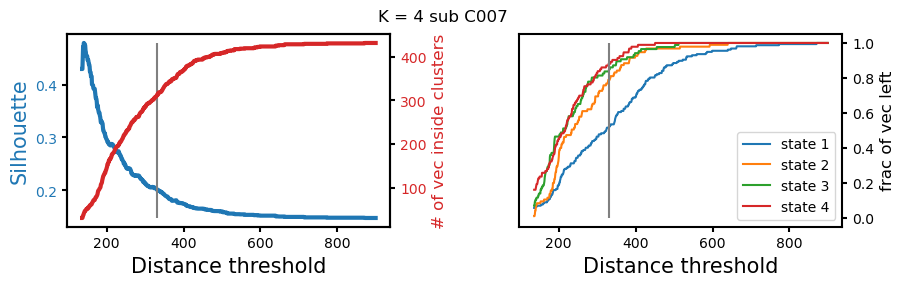

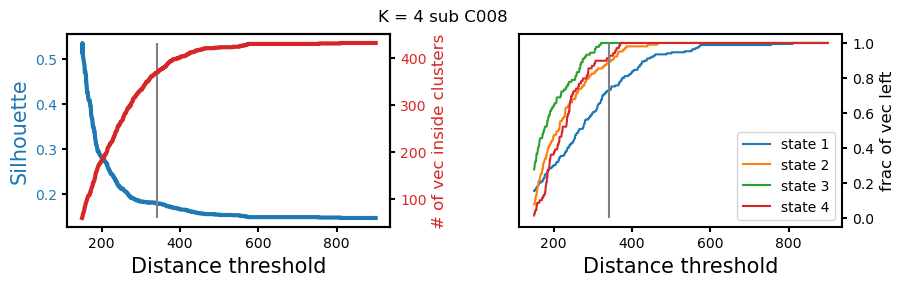

In [227]:
# PLOT
thresh_orig_sub_K = []
for state, thresholds_sub in enumerate(thresholds_sub_K):
    thresh_orig_sub = []
    if state==4-2:
        thresh_norm = opt_threshes_norm[state]
        for sub, thresholds in enumerate(thresholds_sub):
            if len(thresholds)==0:
                thresh_orig = 10000
            else:
                thresh_orig = (np.max(thresholds)-np.min(thresholds))*thresh_norm + np.min(thresholds)
                print(subjects_code[sub], thresh_orig)
    
                fig, (ax1, ax3) = plt.subplots(1,2, figsize=(10,2.5))
                plt.suptitle('K = '+str(state+2)+' sub '+subjects_code[sub])
                ax1.plot(thresholds, silhouette_sub_K[state][sub], color='tab:blue', linewidth=3)
                ax1.set_ylabel('Silhouette', fontsize=15, color='tab:blue')
                ax1.tick_params(axis='y', labelcolor='tab:blue')
                ax1.vlines(thresh_orig, np.min(silhouette_sub_K[state][sub]), np.max(silhouette_sub_K[state][sub]), color='grey')
                ax2 = ax1.twinx()
                ax2.plot(thresholds, n_of_vec_sub_K[state][sub], color='tab:red', linewidth=3)
                # ax2.invert_yaxis()
                ax2.set_ylabel('# of vec inside clusters', fontsize=12, color='tab:red')
                ax2.tick_params(axis='y', labelcolor='tab:red')
                ax1.set_xlabel('Distance threshold', fontsize=15)
            
                for k__, n_of_vec_perstate in enumerate(n_of_vec_perstate_sub_K[state][sub]):
                    ax3.plot(thresholds, n_of_vec_perstate/n_of_vec_perstate[0], label='state '+str(k__+1))
                ax3.vlines(thresh_orig, 0, 1, color='grey')
                ax3.set_xlabel('Distance threshold', fontsize=15)
                ax3.set_ylabel('frac of vec left', fontsize=12)
                ax3.yaxis.tick_right()
                ax3.yaxis.set_label_position("right")
                ax3.legend(loc='lower right')
                plt.subplots_adjust( 
                                    wspace=0.4, 
                                    hspace=0.4)
            thresh_orig_sub.append(thresh_orig)
    thresh_orig_sub_K.append(thresh_orig_sub)

In [258]:
# # Compute the optimal threshold
# # Maybe it's better if I smooth the silhouette curve before
# tol = 0.00003
# win = 75
# opt_threshes_sub_K = []
# for state, thresholds_sub in enumerate(thresholds_sub_K):
#     opt_threshes_sub = []
#     if state==(2):
#         for sub, thresholds in enumerate(thresholds_sub):
#             x = thresholds
#             y = silhouette_sub_K[state][sub] # curves
            
#             x_, y_smooth = mov_av_smooth(x, y, win)
#             dydx = np.gradient(y_smooth, x_) # first derivative
#             # d2ydx2 = np.gradient(dydx, x) # second derivative
#             # x_,dydx_ = mov_av_smooth(x, dydx, win) # smoothed first derivative
#             # d2ydx2_ = np.gradient(dydx_, x_) # derivative of the smoothed first derivative
        
#             x_min, y_min = find_the_min(x_,dydx, tol)
#             opt_threshes_sub.append(x_min)
        
#             # fig = plt.figure()
#             # plt.plot(x,y)
#             # plt.plot(x_, y_smooth)
            
#             fig,axs = plt.subplots(1,2, figsize=(9,3))
#             fig.suptitle('K='+str(state+2)+' sub '+subjects_code[sub])
#             axs[0].plot(x_,y_smooth, color='tab:red', linewidth=3)
#             # axs.plot(x_,dydx_, linewidth=2, color='tab:blue')
#             axs[0].set_ylabel('Silhouette', fontsize=12, color='tab:red')
#             axs[0].vlines(x_min, np.min(y_smooth), np.max(y_smooth), color='r')
#             ax = axs[0].twinx()
#             ax.plot(x_, dydx, alpha=0.5)
#             ax.set_ylabel('Derivative', fontsize=12, color='tab:blue')
#             ax.set_xlabel('Threshold', fontsize=12)
#             ax.scatter(x_min, y_min, s=30, color='r')
#             # axs.plot(x,d2ydx2, alpha=0.5)
#             # axs.plot(x_,d2ydx2_, linewidth=2, color='tab:blue')
#             plt.tight_layout()
#             # plt.savefig('output/MD_05122023/dist_thresh_sil_K'+str(i+2)+'_state.png',
#             #             dpi=200)
        
#             for k__, n_of_vec_perstate in enumerate(n_of_vec_perstate_sub_K[state][sub]):
#                 axs[1].plot(thresholds, n_of_vec_perstate/n_of_vec_perstate[0], label='state '+str(k__+1))
#             axs[1].set_xlabel('Distance threshold', fontsize=15)
#             axs[1].set_ylabel('frac of vec left', fontsize=12)
#             axs[1].yaxis.tick_right()
#             axs[1].yaxis.set_label_position("right")
#             axs[1].legend(loc='lower right')
#             axs[1].vlines(x_min, 0,1, color='r')
#             plt.subplots_adjust( 
#                                 wspace=0.4, 
#                                 hspace=0.4)
        
#             plt.tight_layout(pad=1.0)
    
#         opt_threshes_sub_K.append(opt_threshes_sub)
        
#         # plt.savefig('output/MD_05122023/dist_thresh_sil_K'+str(i+2)+'_state_with_frac.png',
#         #             dpi=200)
    
#     # with open('output/MD_05122023/dist_opt_threshes_n'+str(n)+'.pickle', 'wb') as handle:
#     #     pickle.dump(opt_threshes, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [173]:
# state_labels
path = pardir + '/data/AB_15052024/clustering_res.mat'
kmeans_leida_ = mat73.loadmat(path)
print(kmeans_leida_.keys())
kmeans_leida = kmeans_leida_['Kmeans_results']
# kmeans_leida = kmeans_leida_['Kmeans_results']
K_max = len(kmeans_leida) + 3
print(kmeans_leida[0].keys())

dict_keys(['Kmeans_results', 'mal_dist_kmean'])
dict_keys(['C', 'D', 'IDX', 'SUMD'])


In [228]:
# Define new state indexes, with points above the threshold assigned to the baseline state
mal_dist_kmean_ = np.copy(mal_dist_kmean)

new_state_labels_sub_K = [] # State indexes for each state
for state, thresh_orig_sub in enumerate(thresh_orig_sub_K):
    mal_dist = mal_dist_kmean_[state]
    state_labels = np.copy(kmeans_leida[state]['IDX']) # Index of the state for each time point
    new_state_labels_sub = np.empty((0,)) # State indexes for each sub
    if state==4-2:
        # CONCATENATE ALL THE STATES
        all_k = np.empty((0,)) # Here I store the distance value of each time point
        all_kind = np.empty((0,)) # Here I store the index of each time point with respect to the the whole time series of concatenated subjects
        for s in mal_dist['raw']: # Loop over the states
            all_k = np.concatenate((all_k, s['k']), axis=0)
            all_kind = np.concatenate((all_kind, s['kind']), axis=0)
        print(all_k.shape, all_kind.shape)
        # REORDER THE TIME SERIES
        right_order = np.argsort(all_kind)
        all_k_ordered = all_k[right_order]
        
        for sub, thresh_orig in enumerate(thresh_orig_sub):
            print('SUB - '+subjects_code[sub])
            sub_dist = all_k_ordered[int(sub*T):int((sub+1)*T)] # single subject distance-per-time point
            sub_state = state_labels[int(sub*T):int((sub+1)*T)] # single subject state per time point
            sub_Ev = Ev[int(sub*T):int((sub+1)*T)]
            if subjects_code[sub]=='R024':
                print(thresh_orig)
                print(sub_dist[np.where(sub_state==4)[0]])
    
            pos_0 = np.where(sub_dist>thresh_orig)[0] # which points have a dist above the thresholds - they become part of the baseline state
            print(np.sum(pos_0.shape), sub_dist.min())
            sub_state[pos_0] = 0
            print(np.sum(sub_state==1), np.sum(sub_state==2), np.sum(sub_state==3), np.sum(sub_state==4))
    
            new_state_labels_sub = np.concatenate((new_state_labels_sub, sub_state), axis=0) # State indexes for each state
        print(new_state_labels_sub.shape)


    # print(np.unique(state_idx))
    new_state_labels_sub_K.append(new_state_labels_sub)

with open('output/AB_15052024/new_state_labels_sub_K.pickle', 'wb') as handle:
    pickle.dump(new_state_labels_sub_K, handle, protocol=pickle.HIGHEST_PROTOCOL)

(14223,) (14223,)
SUB - H001
111 92.63704313479735
161 75 57 27
SUB - H002
53 118.3786155204079
178 131 37 32
SUB - H005
53 109.91047131977585
201 80 85 12
SUB - H006
65 98.5773518219704
71 133 84 78
SUB - H008
18 66.8108877675886
354 36 11 12
SUB - H009
52 61.814795012383165
173 132 63 11
SUB - H010
137 105.70225246570737
56 83 64 91
SUB - R006
24 33.24487631204346
354 17 22 14
SUB - R011
12 35.417760307369804
336 41 36 6
SUB - R013
77 76.66513975010855
172 87 39 56
SUB - R014
20 24.006169763651343
281 114 7 9
SUB - R017
64 54.95990941517821
147 128 57 35
SUB - R018
106 89.88596930006798
128 76 55 66
SUB - R020
90 80.58668874435303
199 78 33 31
SUB - R023
42 48.786807135961006
268 70 18 33
SUB - R024
393.3103208811042
[270.04588405 232.43766895 217.94542748 224.80747863 244.48023763]
6 50.18791854803436
297 117 6 5
SUB - 23M
32 11.576852145505535
297 45 26 31
SUB - 24F
89 109.54348776905361
67 94 43 138
SUB - 32M
34 12.966624912119785
219 71 60 47
SUB - 41F
67 57.33532125713101
114 42

In [229]:
with open('output/AB_15052024/new_state_labels_sub_K.pickle', 'rb') as handle:
    new_state_labels_sub_K = pickle.load(handle)

# Compare the FC of each state with the "Global" FC

/tmp/ipykernel_905427/216949280.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(nrows=1, ncols=N_mat, figsize=(4*N_mat, 4))


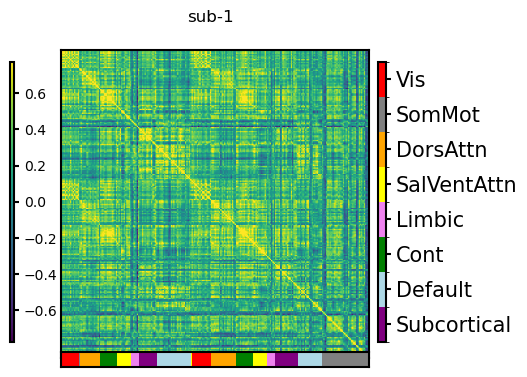

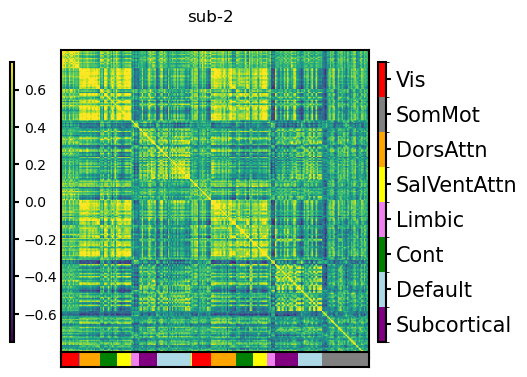

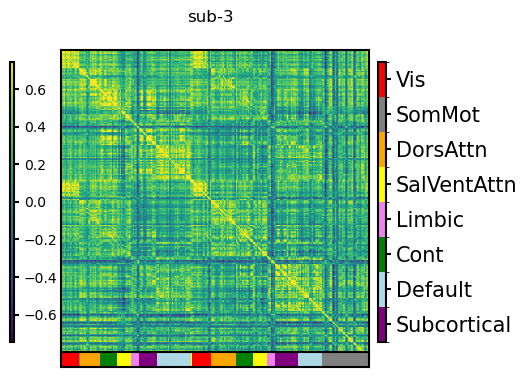

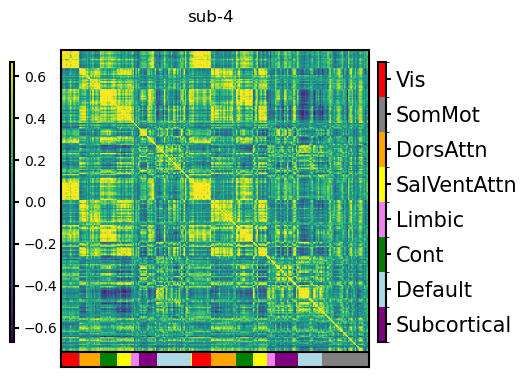

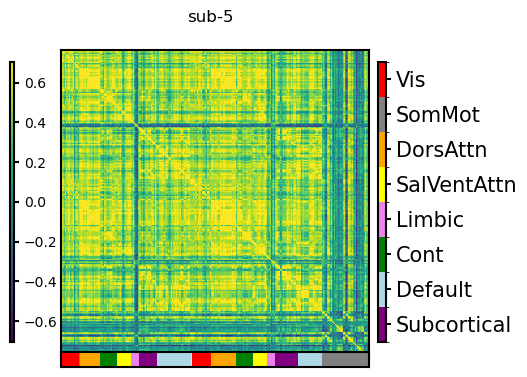

...

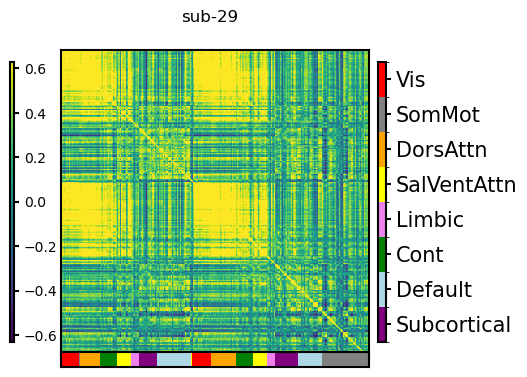

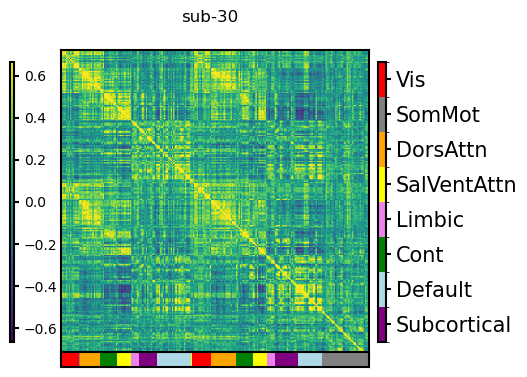

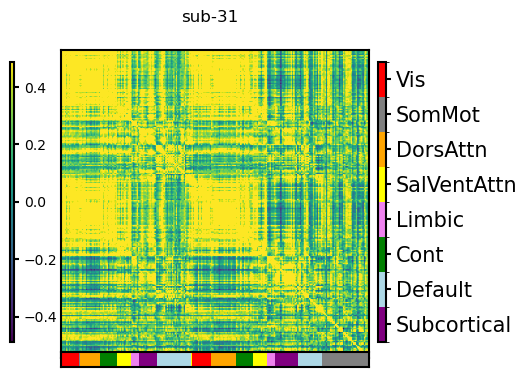

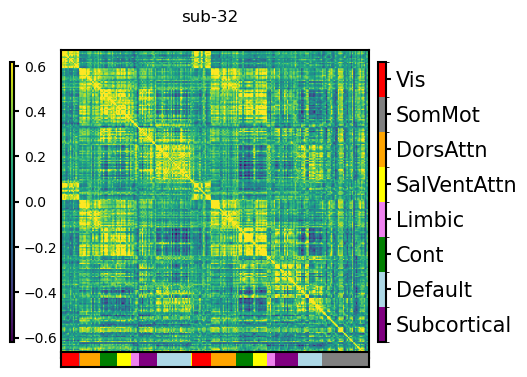

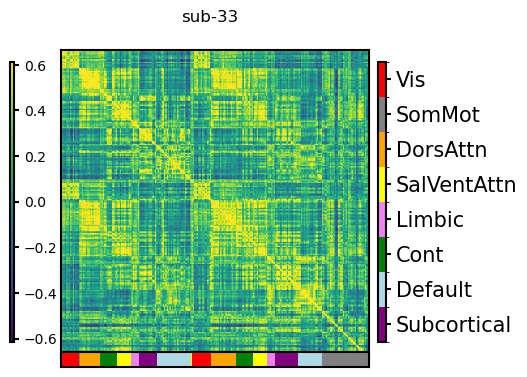

In [136]:
all_fc_global = []
for s in range(n_sub): # Loop over subject
    sub_pl_all = plm_tc[int(s*T):int((s+1)*T)]
    # print(sub_pl_all.shape)
    plot_ordered_fc(sub_pl_all.mean(axis=0)[np.newaxis,:,:], [''],'sub-'+str(s+1) ,atlas, atlas_labels)
    all_fc_global.append(sub_pl_all)

### Without thresholding

In [171]:
max = lambda a,b:a if a > b else b

(14223,)
(33, 236, 236)
(33, 236, 236)
(33, 236, 236)
(33, 236, 236)


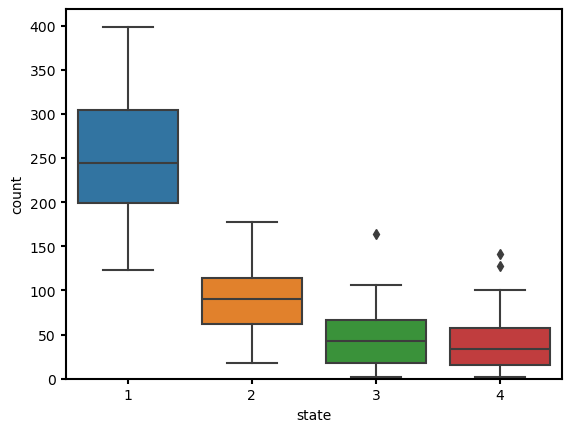

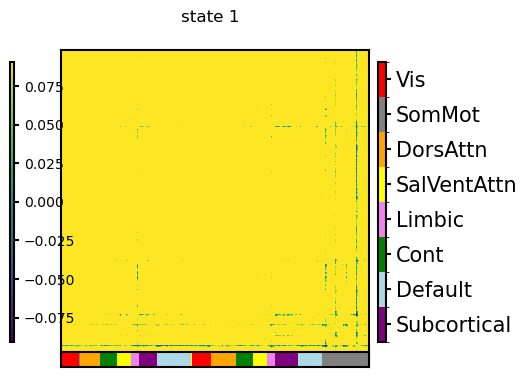

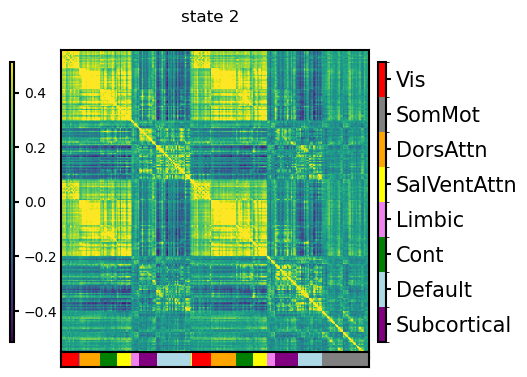

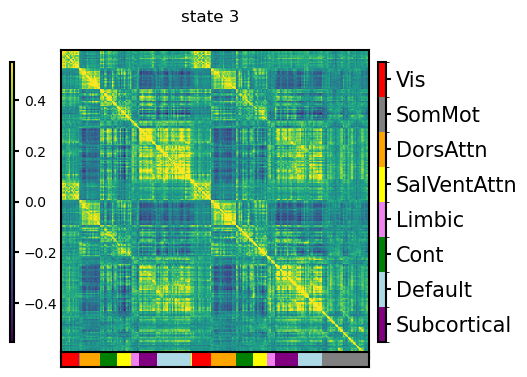

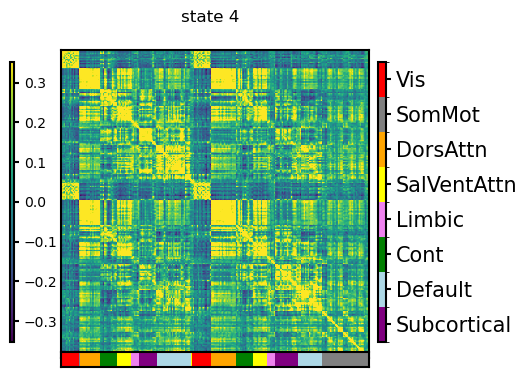

In [176]:
# Chose a number of state
K=4

k = K - 2 # MD start to cluster from K=2
state_labels = kmeans_leida[k]['IDX'] # Index of the state for each time point
print(state_labels.shape)

state_count_dic = {'count':[], 'state':[], 'sub':[]}
for s in range(n_sub): # Loop over subject
    sub = state_labels[int(s*T):int((s+1)*T)]
    # Count how many time points belong to each state, for each suject
    for state in range(K):
        state_count_dic['count'].append(np.sum(sub==state+1))
        state_count_dic['state'].append(state+1)
        state_count_dic['sub'].append(s+1)
        # print(subjects_code[s], state+1 ,np.sum(sub==state+1))

df = pd.DataFrame(state_count_dic)
sns.boxplot(data=df, x='state', y='count')
plt.ylim(0,)

# Compute the mean FC for each state for each subject - and STORE THEM!!!
fc_for_state = [np.empty((0,236,236)) for _ in range(K)]
for s in range(n_sub): # Loop over subject
    sub = state_labels[int(s*T):int((s+1)*T)]
    sub_pl = plm_tc[int(s*T):int((s+1)*T)]
    # Count how many time points belong to each state, for each suject
    for state in range(K):
        state_id = np.where(sub==state+1)
        sub_pl_state = sub_pl[state_id]
        fc_for_state[state] = np.concatenate((fc_for_state[state], sub_pl_state.mean(axis=0)[np.newaxis,:]))
for i,fc in enumerate(fc_for_state):
    plot_ordered_fc(fc.mean(axis=0)[np.newaxis,:,:],[''], 'state '+str(i+1), atlas, atlas_labels)
    print(fc.shape)

(0.0, 1.0373738875813372)

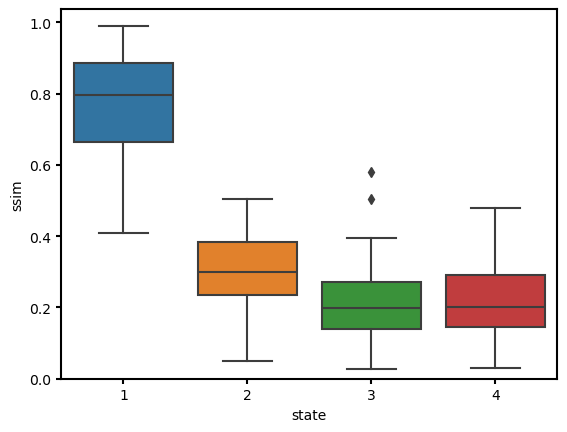

In [155]:
# Subject-wise structural similiraity index between each state and the global average PL
ssim_dic = {'ssim':[], 'state':[], 'sub':[]}
for state in range(K):
    for s in range(n_sub): # Loop over subject
        st_fc = fc_for_state[state][s]
        gl_fc = all_fc_global[s].mean(axis=0)
        ssim_dic['ssim'].append(ssim(gl_fc, st_fc, data_range=1))
        ssim_dic['state'].append(state+1)
        ssim_dic['sub'].append(s+1)

df = pd.DataFrame(ssim_dic)
sns.boxplot(data=df, x='state', y='ssim')
plt.ylim(0,)

### With thresholding

In [232]:
max = lambda a,b:a if a > b else b
def plot_ordered_fc(matrix, matrix_label, suptitle, atlas, atlas_labels, c_map='viridis'):
    """
    matrix: matrix I want to plot
    matrix_label: label of the matrix

    """
    
    N_mat = len(matrix)

    N=int(atlas.max()) # Number of areas
    
    dic = {}
    for i,n in enumerate(np.unique(atlas_labels['ROI_network'].to_numpy())):
        dic[n] = i
    
    super_area_indx = [dic[a] for a in atlas_labels['ROI_network'].to_numpy()]
    super_area_indx = np.asarray(super_area_indx)
    
    alpha=1
    
    # Add an additional color for the first 16 elements
    colors = [
              mpl.colors.to_rgba('purple',alpha), #Attention
              mpl.colors.to_rgba('lightblue',alpha), #Auditive
              mpl.colors.to_rgba('green',alpha), #Control  
              mpl.colors.to_rgba('violet',alpha),#Default
              mpl.colors.to_rgba('yellow',alpha), #Language
              mpl.colors.to_rgba('orange',alpha), #Somatomotor
              mpl.colors.to_rgba('gray', alpha),  # Subcortical
              mpl.colors.to_rgba('red',alpha), #Visual
             ]
    
    n_bin = np.unique(list(atlas_labels['ROI_network'])).shape[0] # Increment number of bins
    cmap_name = 'my_list'
    cmap = mpl.colors.LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bin)
    family = super_area_indx
        
    # Define your labels for each color
    labels = atlas_labels['ROI_network'].unique()[::-1]
        
    vmin = np.min(matrix)
    vmax = np.min(matrix)
    vtot = max(vmax,abs(vmin))

    ### PLOT ###
    cmap_ = plt.get_cmap(c_map)
    fig, axs = plt.subplots(nrows=1, ncols=N_mat, figsize=(4*N_mat, 4))
    fig.suptitle(suptitle)
    for i in range(N_mat):
        if N_mat>1:
            ax = axs[i]
        else:
            ax = axs
        # Plot the matrix
        im = ax.imshow(matrix[i], vmin=-vtot, vmax=vtot, cmap=c_map)
        ax.set_title(matrix_label[i])
        ax.set_xticks([])
        ax.set_yticks([])
    
        # Plot the family color bar at the bottom of the matrix
        cax_bottom = ax.inset_axes([0, -0.03, 1, 0.05])  # adjust [left, bottom, width, height] as needed
        cax_bottom.imshow(family[np.newaxis, :], aspect='auto', cmap=cmap)
        cax_bottom.set_yticks([])
        cax_bottom.set_xticks([])
        
        # Set the boundaries to match your data
        boundaries = [0]  # start with 0
        
        # Add the boundary for the first color
        boundaries.append(16)
        
        # Add the boundaries for the rest of the colors
        for i in range(2, n_bin+1):
            boundaries.append(boundaries[-1] + 10)
        
        # Create a color bar legend with labels
        cax_legend = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # adjust [left, bottom, width, height] as needed
        norm = mpl.colors.BoundaryNorm(boundaries, cmap.N)
        cb = mpl.colorbar.ColorbarBase(cax_legend, cmap=cmap, norm=norm, 
                                       ticks=np.array(boundaries[:-1]) + np.diff(boundaries) / 2,  # set ticks at the middle of boundaries
                                       orientation='vertical')
    
        cb.set_ticklabels(labels, fontsize=15)  # set fontsize to desired value
            
        # Add common colorbar
        cbar_ax = fig.add_axes([0.0, 0.15, 0.01, 0.7]) # Adjust as necessary.
        fig.colorbar(im, cax=cbar_ax, orientation='vertical')
    
    return fig

(14223,)
(33, 236, 236)
(33, 236, 236)
(33, 236, 236)
(33, 236, 236)


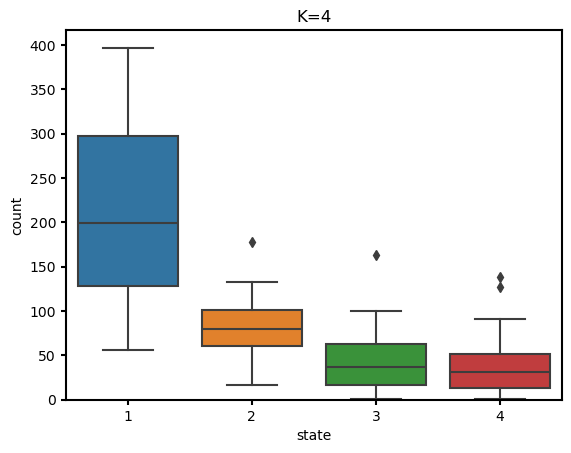

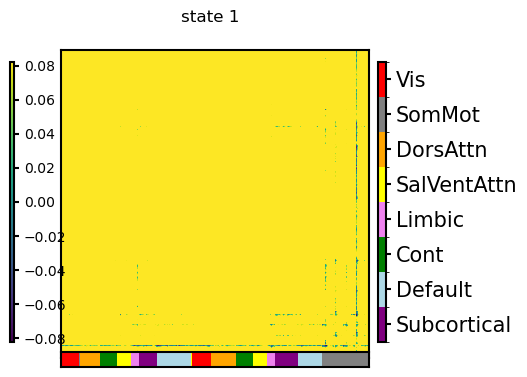

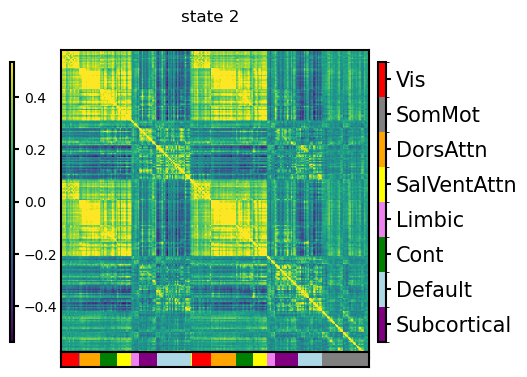

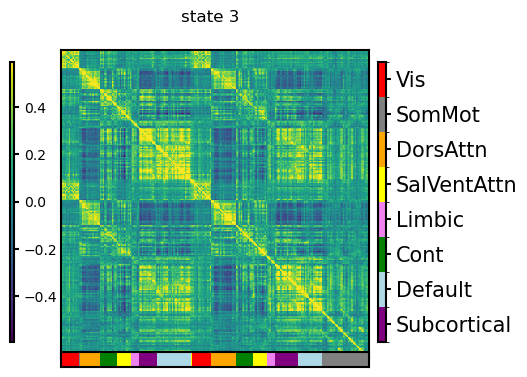

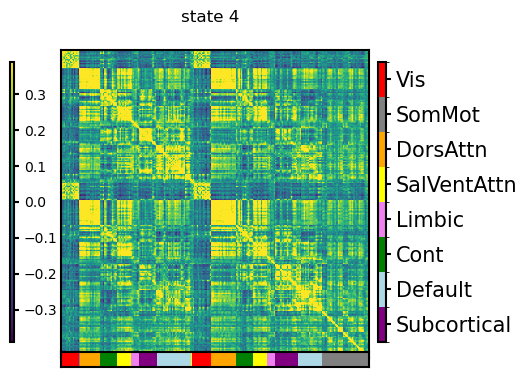

In [233]:
# Chose a number of state
fc_for_state_K = []
for k in range(9):
    K = k + 2 # MD start to cluster from K=2
    fc_for_state = [np.empty((0,236,236)) for _ in range(K)]
    if K == 4:
        state_labels = new_state_labels_sub_K[k] # Index of the state for each time point - thresholded
        print(state_labels.shape)
        
        state_count_dic = {'count':[], 'state':[], 'sub':[]}
        for s in range(n_sub): # Loop over subject
            sub = state_labels[int(s*T):int((s+1)*T)]
            # Count how many time points belong to each state, for each suject
            for state in range(K):
                state_count_dic['count'].append(np.sum(sub==state+1))
                state_count_dic['state'].append(state+1)
                state_count_dic['sub'].append(s+1)
        
        df = pd.DataFrame(state_count_dic)
        fig = plt.figure()
        sns.boxplot(data=df, x='state', y='count')
        plt.ylim(0,)
        plt.title('K='+str(K))
        
        # Compute the mean FC for each state for each subject - and STORE THEM!!!
        for s in range(n_sub): # Loop over subject
            sub = state_labels[int(s*T):int((s+1)*T)]
            sub_pl = plm_tc[int(s*T):int((s+1)*T)]
            # Count how many time points belong to each state, for each suject
            for state in range(K):
                state_id = np.where(sub==state+1)
                # print(np.sum(sub==state+1))
                sub_pl_state = sub_pl[state_id]
                fc_for_state[state] = np.concatenate((fc_for_state[state], sub_pl_state.mean(axis=0)[np.newaxis,:]))
        for i,fc in enumerate(fc_for_state):
            if K==4:
                plot_ordered_fc(fc.mean(axis=0)[np.newaxis,:,:], [''], 'state '+str(i+1), atlas, atlas_labels)
                print(fc.shape)
    fc_for_state_K.append(fc_for_state)

In [234]:
with open('output/AB_15052024/fc_for_state_K_thresholded.pickle', 'wb') as handle:
    pickle.dump(fc_for_state_K, handle, protocol=pickle.HIGHEST_PROTOCOL)

# Comparison between centroids among different K (of the K-means)

## Comparison between centroids among different K (of the K-means)

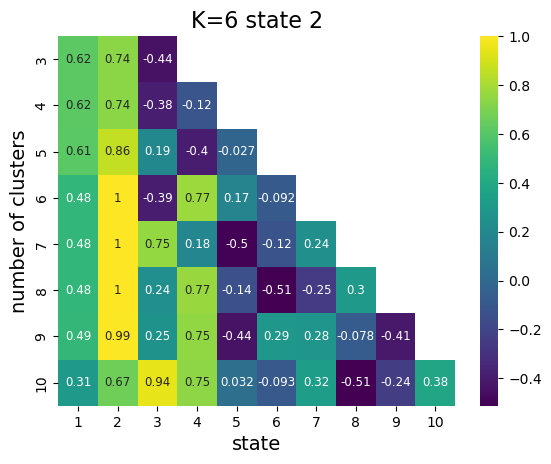

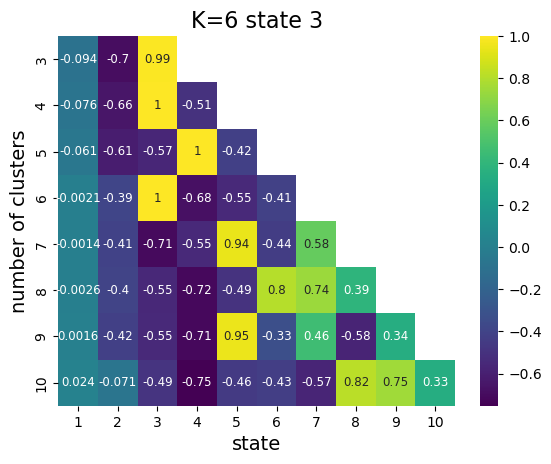

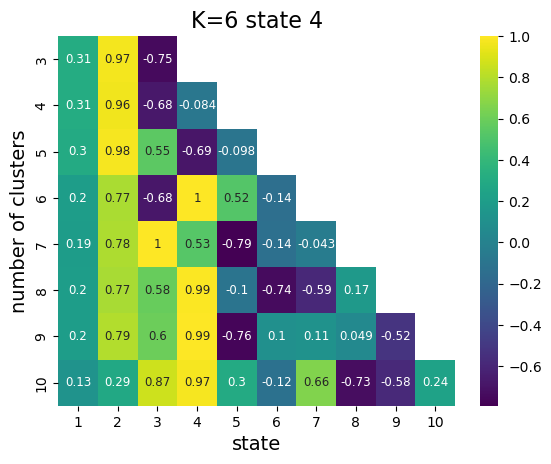

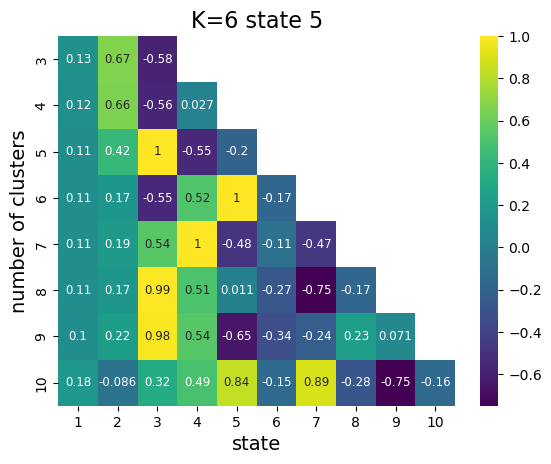

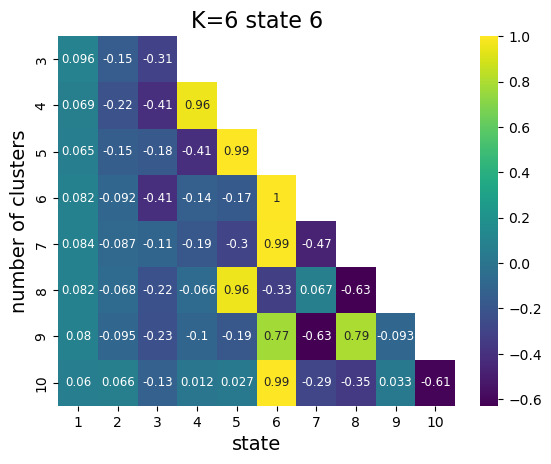

In [180]:
# I take the centroids for K=4 because they seems to be present in all the K clusterings
my_k = 6
centr_4 = kmeans_leida[my_k-2]['C']

K_max = 10


# for iii,c in enumerate(centr_4[1:]): # Loop over the centroids for K=4 (exluding the global signal state)
#     corr_m = np.full((7,10), np.nan)
#     i_ = 0 # the real counter
#     for i,k in enumerate(range(1,K_max-1)): # Loop over the K
#         if i!= my_k-3:
#             centroids = kmeans_leida[k]['C'] # centroids for the current K
#             for c_i,c_ in enumerate(centroids):
#                 corr_m[i_,c_i] = pearsonr(c,c_)[0]
#             i_ += 1
    
#     y_t = [y for y in range(3,10+1) if y!=my_k]
#     x_t = [x+1 for x in range(10)]
#     fig = plt.figure()
#     sns.heatmap(corr_m, xticklabels=x_t, yticklabels=y_t, annot=True, cmap='viridis',annot_kws={'fontsize':8.5})
#     plt.title('K='+str(my_k)+' state '+str(iii+2), fontsize=16)
#     plt.ylabel('number of clusters', fontsize=14)
#     plt.xlabel('state', fontsize=14)

#     plt.savefig('output/MD_05122023/corr_betw_centroids_K'+str(my_k)+'_state'+str(iii+2)+'.png',
#                 dpi=200)


# NOT REMOVING THE ROW OF THE CHOSEN K
for iii,c in enumerate(centr_4[1:]): # Loop over the centroids for K=4 (exluding the global signal state)
    corr_m = np.full((8,10), np.nan)
    i_ = 0 # the real counter
    for i,k in enumerate(range(1,K_max-1)): # Loop over the K
        centroids = kmeans_leida[k]['C'] # centroids for the current K
        for c_i,c_ in enumerate(centroids):
            corr_m[i_,c_i] = pearsonr(c,c_)[0]
        i_ += 1
    
    y_t = [y for y in range(3,10+1)]
    x_t = [x+1 for x in range(10)]
    fig = plt.figure()
    sns.heatmap(corr_m, xticklabels=x_t, yticklabels=y_t, annot=True, cmap='viridis',annot_kws={'fontsize':8.5})
    plt.title('K='+str(my_k)+' state '+str(iii+2), fontsize=16)
    plt.ylabel('number of clusters', fontsize=14)
    plt.xlabel('state', fontsize=14)

    # plt.savefig('output/MD_05122023/corr_betw_centroids_K'+str(my_k)+'_state'+str(iii+2)+'.png',
    #             dpi=200)

## Comparison at fixed K: similarity among mean EV belonging to different states

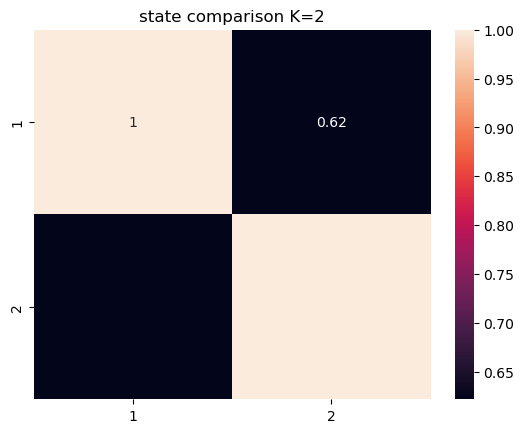

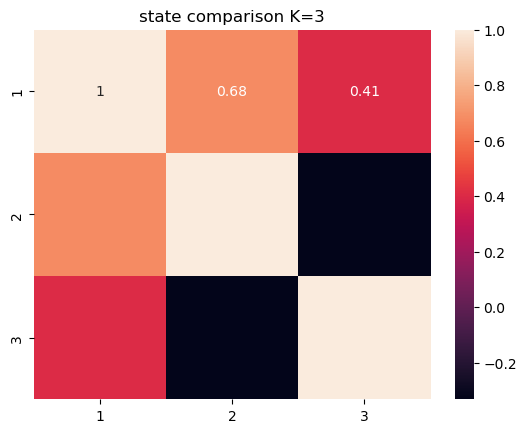

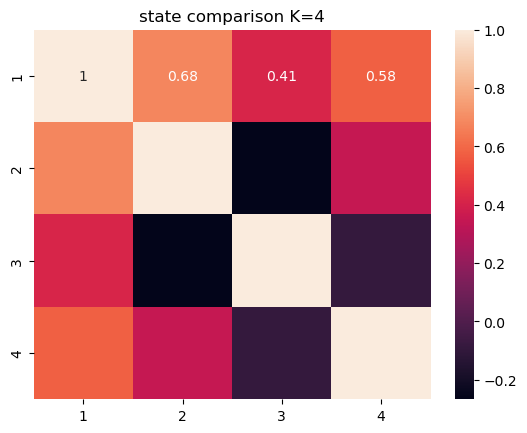

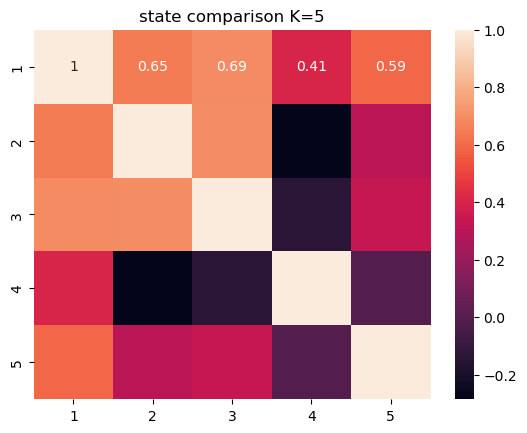

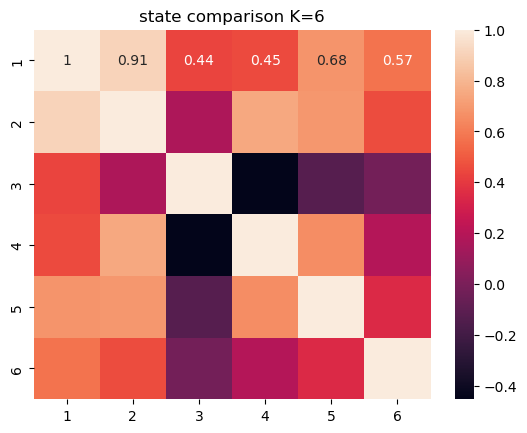

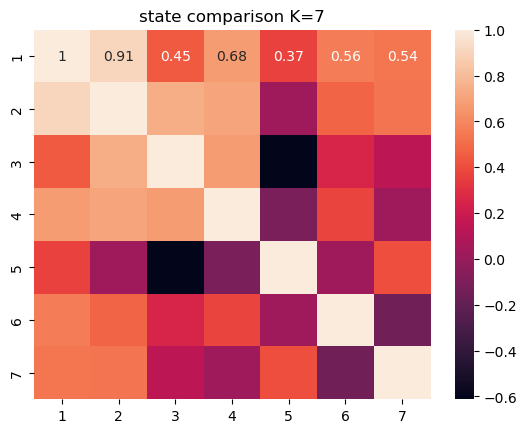

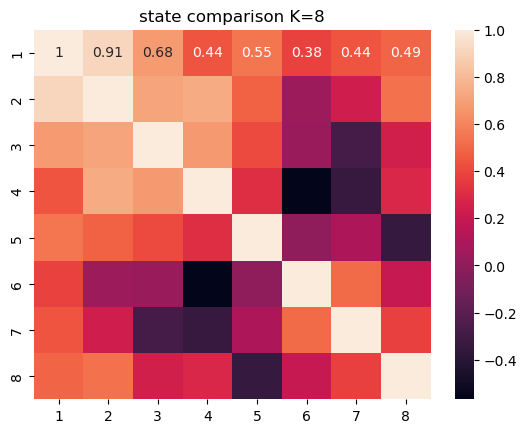

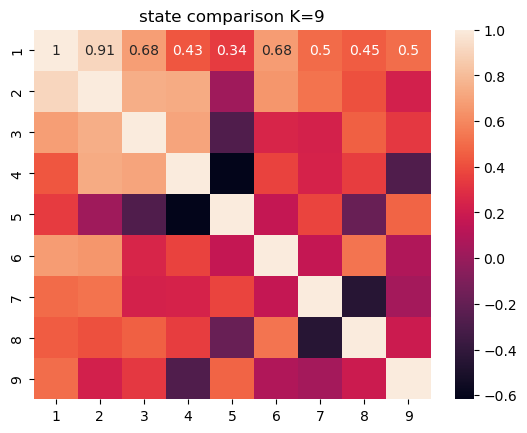

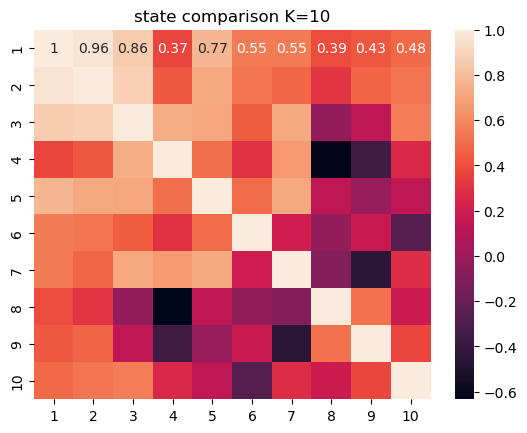

In [23]:
import warnings
warnings.filterwarnings('ignore')

for K in range(2,10+1):
    k = K - 2 # MD start to cluster from K=2
    state_labels = new_state_labels_sub_K[k]
    states = []
    for s in range(1,K+1):
        states.append(Ev[np.where(state_labels==s)].mean(axis=0))
    sim_mat = np.empty((K,K))
    for i in range(K):
        for j in range(K):
            # print(states[i].shape, states[j].shape)
            sim_mat[i,j] = cosine_similarity(states[i].reshape(1, -1), states[j].reshape(1, -1))
    fig = plt.figure()
    tick = [t+1 for t in range(K)]
    sns.heatmap(sim_mat, annot=True, xticklabels=tick, yticklabels=tick)
    plt.title('state comparison K='+str(K))

    # plt.savefig('output/MD_05122023/state_sim_K'+str(K)+'.png',
    #             dpi=200)     

# Goodness of clustering: inter-pattern correlation variance

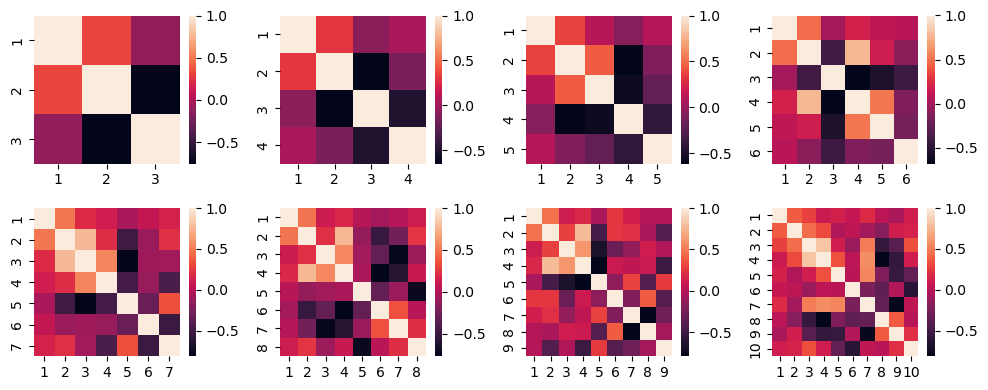

In [45]:
fig,axs = plt.subplots(2,4, figsize=(10,4))
corr_mats = []
for idx,ax in enumerate(axs.flat):
    results = kmeans_leida[idx+1]
    # Compute correlation between centroids of each K
    centrs = results['C'] # centroids
    corr_mat = np.empty((centrs.shape[0],centrs.shape[0]))# Init the corr matrix
    for i in range(centrs.shape[0]):
        for j in range(centrs.shape[0]):
            corr_mat[i,j] = pearsonr(centrs[i], centrs[j])[0]
    tick = [t+1 for t in range(centrs.shape[0])]
    sns.heatmap(corr_mat, ax=ax, xticklabels=tick, yticklabels=tick)
    corr_mats.append(corr_mat)
plt.tight_layout()

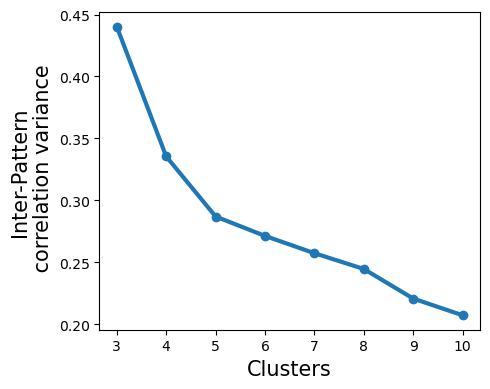

In [46]:
vars = [m.var() for m in corr_mats]
x = [i+3 for i in range(len(corr_mats))]
fig, ax = plt.subplots(1, figsize=(5,4))
ax.plot(x,vars, '-o', linewidth=3)
ax.set_xlabel('Clusters', fontsize=15)
ax.set_ylabel('Inter-Pattern\n correlation variance', fontsize=15)
plt.tight_layout()
plt.savefig('output/MD_05122023/clust_met_ipcv.png',
            dpi=200)

# Goodness of clustering: silhouette

### I use the optimal distance threshold for each K found before

In [235]:
def wcss(points, centroids, state_idx):
    unique_labels = np.unique(state_idx)
    # print(unique_labels)
    sum_sq_distance = 0
    for idx, C in enumerate(unique_labels):
        c = centroids[idx]
        for p in points[np.where(state_idx==C)]:
            sum_sq_distance += norm(p - c)**2
            
    return sum_sq_distance

In [236]:
# Silhouette score evaluation

K_max = 10
silhouettes = []
wcss_ = []
for i,k in enumerate(range(2,K_max+1)):
    print('State '+str(k))
    state_idx = new_state_labels_sub_K[i]

    state_idx_nobase = np.where(state_idx!=0) # Remove the baseline state to compute silhouette score

    state_v = Ev[state_idx_nobase]
    # sub_samp = random.sample([i for i in range(state_v.shape[0])], n)
    sil = silhouette_score(state_v, state_idx[state_idx_nobase])
    # sil = silhouette_score(Ev, state_idx)
    silhouettes.append(sil)
    
    # Sum of Square Distance
    centroids = kmeans_leida[i]['C']
    wcss_.append(wcss(state_v, centroids, state_idx[state_idx_nobase]))
    

State 2


ValueError: Found array with 0 sample(s) (shape=(0, 236)) while a minimum of 1 is required.

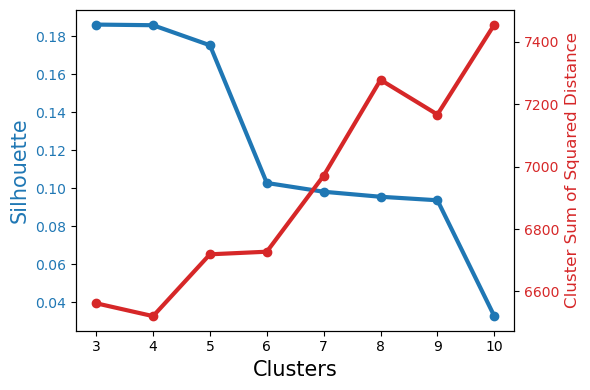

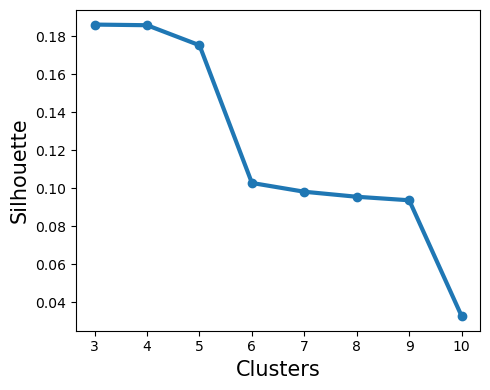

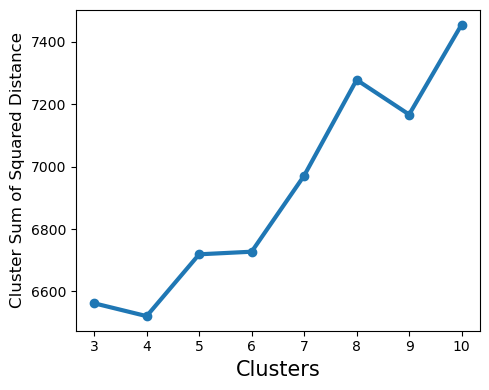

In [96]:
today = date.today()
DATE = today.strftime("%d%m%Y")
# checking if the directory exists or not

metricz = [silhouettes, wcss_]
x = [k for k in range(2,len(kmeans_leida)+2)]
fig, ax1 = plt.subplots(1, figsize=(6,4))
ax1.plot(x[1:], metricz[0][1:], '-o', color='tab:blue', linewidth=3)
ax1.set_ylabel('Silhouette', fontsize=15, color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')
ax2 = ax1.twinx()
ax2.plot(x[1:], metricz[1][1:], '-o', color='tab:red', linewidth=3)
# ax2.invert_yaxis()
ax2.set_ylabel('Cluster Sum of Squared Distance', fontsize=12, color='tab:red')
ax2.tick_params(axis='y', labelcolor='tab:red')
ax1.set_xlabel('Clusters', fontsize=15)
plt.tight_layout()

plt.savefig('output/MD_05122023/clust_met.png',
            dpi=200)

metricz = [silhouettes, wcss_]
x = [k for k in range(2,len(kmeans_leida)+2)]
fig, ax1 = plt.subplots(1, figsize=(5,4))
ax1.plot(x[1:], metricz[0][1:], '-o', color='tab:blue', linewidth=3)
ax1.set_ylabel('Silhouette', fontsize=15,)
ax1.tick_params(axis='y')
ax1.set_xlabel('Clusters', fontsize=15)
plt.tight_layout()
plt.savefig('output/MD_05122023/clust_met_sil.png',
            dpi=200)

fig, ax2 = plt.subplots(1, figsize=(5,4))
ax2.plot(x[1:], metricz[1][1:], '-o', color='tab:blue', linewidth=3)
# ax2.invert_yaxis()
ax2.set_ylabel('Cluster Sum of Squared Distance', fontsize=12)
ax2.tick_params(axis='y')
ax2.set_xlabel('Clusters', fontsize=15)
plt.tight_layout()
plt.savefig('output/MD_05122023/clust_met_cssd.png',
            dpi=200)

In [516]:
# # Cluster visualzation through PCA
# # PCA

# n = 100 # random subsampling for the pca
# reps = 100
# # varss = [0.25,0.5,0.75,0.95]
# varss = [0.95]


# points_maxs = []
# points_mins = []
# points_means = []
# points_maxs_std = []
# points_mins_std = []
# points_means_std = []
# for var in varss:
#     points_max = []
#     points_min = []
#     points_mean = []
#     points_max_std = []
#     points_min_std = []
#     points_mean_std = []
#     print(var)
#     for k in range(3,K_max):
#         k = k-3
#         state_labels = kmeans_leida[k]['IDX']
#         states_idx = np.unique(state_labels)
#         intrinsic_dims = []
#         intrinsic_dims_std = []
#         for s in states_idx: # loop over states
#             intrinsic_dim = []
#             for piru in range(reps):
#                 state_v = Ev[np.where(state_labels==s)]
#                 sub_samp = random.sample([i for i in range(state_v.shape[0])], n)
#                 # PCA
#                 pca = sklearn.decomposition.PCA(n_components=100)
#                 pca.fit(state_v[sub_samp])
#                 V1_pca = pca.transform(state_v[sub_samp])
#                 exp_var_pca = pca.explained_variance_ratio_
#                 cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#                 intrinsic_dim.append(np.where(cum_sum_eigenvalues>var)[0][0])
#             intrinsic_dims.append(np.mean(intrinsic_dim))
#             intrinsic_dims_std.append(np.std(intrinsic_dim))
#         points_max.append(np.max(intrinsic_dims))
#         points_min.append(np.min(intrinsic_dims))
#         points_max_std.append(intrinsic_dims_std[np.argmax(intrinsic_dims)])
#         points_min_std.append(intrinsic_dims_std[np.argmin(intrinsic_dims)])
#         points_mean.append(np.mean(intrinsic_dims))
#         points_mean_std.append(np.std(intrinsic_dims))
# #         print(np.max(intrinsic_dims))
#         #         fig= plt.figure()
#         #         plt.title('PCA explained variance')
#         #         plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
#         #         plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
#         #         plt.ylabel('Explained variance ratio')
#         #         plt.xlabel('Principal component index')
#         #         plt.legend(loc='best')
#         #         plt.tight_layout()
#         #         plt.show()
#     points_mins.append(points_min)
#     points_means.append(points_mean)
#     points_maxs.append(points_max)
#     points_mins_std.append(points_min_std)
#     points_means_std.append(points_mean_std)
#     points_maxs_std.append(points_max_std)

In [517]:
# # plt.plot([x+3 for x in range(len(points_max))], points_max, label='max')
# # plt.plot([x+3 for x in range(len(points_max))], points_min, label='min')
# # plt.plot([x+3 for x in range(len(points_max))], points_mean, label='mean')
# # plt.legend()

# cmap = plt.cm.winter  # define the colormap

# fig = plt.figure()
# plt.title('intrinsic dimension - mean among clusters')
# for i,c in enumerate(points_means):
#     plt.plot([x+3 for x in range(len(c))], (c-np.mean(c))/np.std(c), label=str(varss[i]), color=cmap(i/len(points_means)))
# plt.legend()
    
# fig = plt.figure()
# plt.title('intrinsic dimension - min among clusters')
# for i,c in enumerate(points_mins):
#     plt.plot([x+3 for x in range(len(c))],(c-np.mean(c))/np.std(c), label=str(varss[i]), color=cmap(i/len(points_means)))
# plt.legend()

# fig = plt.figure()
# plt.title('intrinsic dimension - max  among clusters')
# for i,c in enumerate(points_maxs):
#     plt.plot([x+3 for x in range(len(c))], (c-np.mean(c))/np.std(c), label=str(varss[i]), color=cmap(i/len(points_means)))
# plt.legend()

In [518]:
# x = [x+3 for x in range(len(points_mins[-1]))]
# plt.plot([x+3 for x in range(len(points_maxs[-1]))], points_maxs[-1])
# plt.fill_between(x,
#                  np.subtract(points_maxs[-1], points_maxs_std[-1]), 
#                  np.subtract(points_maxs[-1], -np.asarray(points_maxs_std[-1])), alpha=0.2)
# plt.xlabel('K', fontsize=20)
# plt.ylabel('Intrinsic Dimension', fontsize=18);
# plt.title('Maximum of intrinsic dimension among cluster')
# plt.savefig('output/GraphAnal/MaximumIntrinsicDimension.png',
#             dpi=200)

# Chose a K

In [31]:
K = 6
k = K - 2 # MD start to cluster from K=2
# Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
state_labels = state_labels_list[k]
print(state_labels.shape, state_labels.max())
centroids = kmeans_leida[k]['C']
print(centroids.shape)

(14223,) 6.0
(6, 234)


# Some extra info (for a fixed K)

In [525]:
K = 6
k = K - 2 # MD start to cluster from K=2
# Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
state_labels = state_labels_list[k]
print(state_labels.shape, state_labels.max())
centroids = kmeans_leida[k]['C']
print(centroids.shape)

# time points belonging to each state [state x time points]
states_index = []
for s in np.unique(state_labels):
    states_index.append(np.where(state_labels==s))

# Divide states indexes by group
groups_index = []
for g in np.unique(group_labels):
    groups_index.append(np.where(group_labels==g)[0])
    
states_index_groups = [] # [state 1, state2, state 3]
for s in states_index:
    groupz = {0:[], 1:[], 2:[]}
    for t in s[0]:
        groupz[group_labels[t][0]].append(t)
    states_index_groups.append(groupz)

# states_index = # time points belonging to each state [state x time points]
# group_index = # time points belonging to each group [gorups x time points]

# Basic dynamic evaluation: Life Time and Percentage of Occupancy

In [237]:
print(sns.__version__)
import statannotations
print(statannotations.__version__)

0.11.2
0.5.0


(14223,) 4.0
(4, 236)
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 3.33e-03 < p <= 1.67e-02
      **: 3.33e-04 < p <= 3.33e-03
     ***: 3.33e-05 < p <= 3.33e-04
    ****: p <= 3.33e-05

3_C vs. 3_B: Brunner-Munzel test, P_val:5.874e-01 W=-5.536e-01
4_C vs. 4_B: Brunner-Munzel test, P_val:8.056e-01 W=2.511e-01
2_B vs. 2_NB: Brunner-Munzel test, P_val:3.763e-01 W=-9.199e-01
3_B vs. 3_NB: Brunner-Munzel test, P_val:2.071e-01 W=1.323e+00
4_B vs. 4_NB: Brunner-Munzel test, P_val:3.328e-01 W=-1.003e+00
1_C vs. 1_B: Brunner-Munzel test, P_val:2.892e-01 W=1.086e+00
2_C vs. 2_B: Brunner-Munzel test, P_val:7.457e-02 W=1.981e+00
1_B vs. 1_NB: Brunner-Munzel test, P_val:1.548e-01 W=-1.533e+00
3_C vs. 3_NB: Brunner-Munzel test, P_val:3.757e-01 W=9.132e-01
4_C vs. 4_NB: Brunner-Munzel test, P_val:3.929e-01 W=-8.758e-01
2_C vs. 2_NB: Brunner-Munzel test, P_val:5.044e-01 W=6.848e-01
1_C vs. 1_NB: Brunner-Munzel test, P_val:6.688e-01 W=-4.379e-01
p-value annotation legend:
      ns: p 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

C vs. B: Brunner-Munzel test, P_val:6.538e-01 W=-4.578e-01
B vs. NB: Brunner-Munzel test, P_val:6.330e-01 W=4.883e-01
C vs. NB: Brunner-Munzel test, P_val:7.851e-01 W=2.779e-01


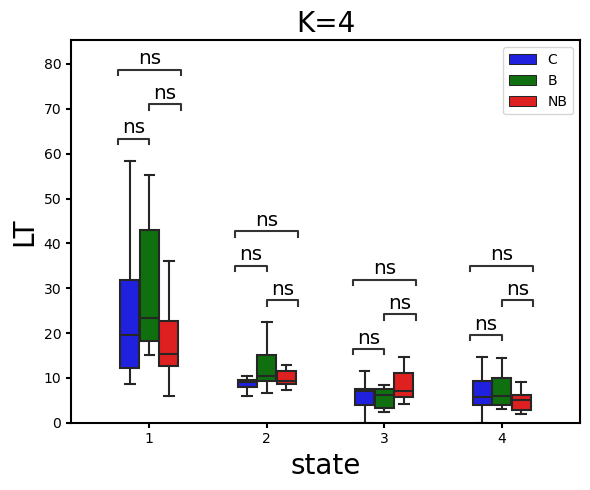

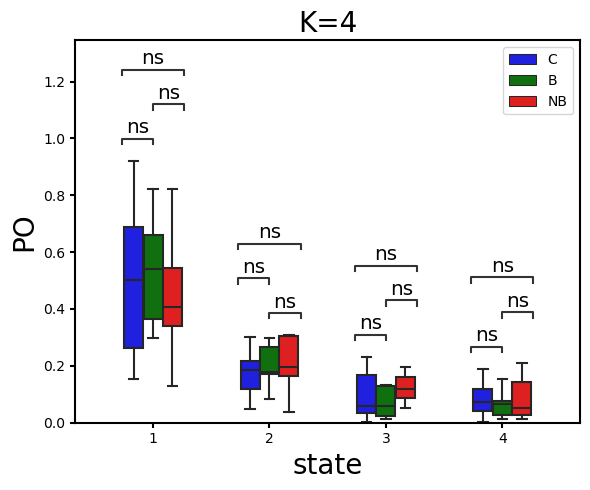

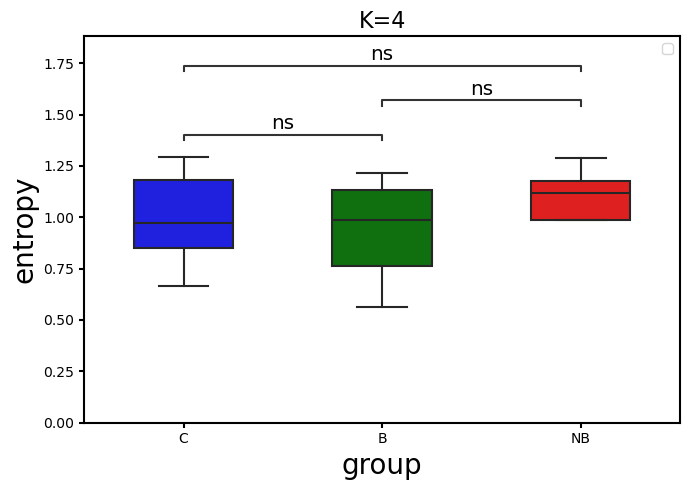

In [238]:
for K in range(2,10+1):
    k = K - 2 # MD start to cluster from K=2
    if K==4:
        # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
        state_labels = new_state_labels_sub_K[k]
        print(state_labels.shape, state_labels.max())
        centroids = kmeans_leida[k]['C']
        print(centroids.shape)
        
        # SOME EXTRA INFOs
        # time points belonging to each state [state x time points]
        states_index = []
        for s in np.unique(state_labels):
            states_index.append(np.where(state_labels==s))
        # Divide states indexes by group
        groups_index = []
        for g in np.unique(group_labels):
            groups_index.append(np.where(group_labels==g)[0])
        states_index_groups = [] # [state 1, state2, state 3]
        for s in states_index:
            groupz = {0:[], 1:[], 2:[]}
            for t in s[0]:
                groupz[group_labels[t][0]].append(t)
            states_index_groups.append(groupz)
        
        # METRICS OF DYNAMICS
        metrics_dic = {'LT': [], 
                       'PO': [],
                       'sub': [],
                       'group': [],
                       'state': []}
        
        for n in range(n_sub):  # Loop over subjects
            ts = state_labels[n*time_points:(n+1)*time_points]
            for s in range(1, K+1): # Loop over state, no baseline state        
                metrics_dic['group'].append(group[n])
                metrics_dic['state'].append(s)
                metrics_dic['sub'].append(n+1)
                # PO
                metrics_dic['PO'].append(np.where(ts==s)[0].shape[0]/time_points)
                
            # AVERAGE LT    
            prev = ts[0]
            counts = {} # all the lifetimes, it's a dic
            for s in range(0, K+1): # Init the dic
                counts[s] = []
                
            count = 0
            for t in ts[1:]:
                if t==prev:
                    count+=1
                else:
                    counts[prev].append(count)
                    count = 0
                    prev = t
                    
            for s in range(1, K+1): # Loop over state, no baseline state   
                if len(counts[s])==0:
                    pino = 0
                else:
                    pino = np.mean(counts[s])
                    
                metrics_dic['LT'].append(pino)
        
        df_metrics = pd.DataFrame(metrics_dic)
        
        ### PLOT ###
        
        metrics = ['LT', 'PO']
        
        state_order = [s for s in range(1,K+1)] # 0 because we start from the baseline state - no baseline state   
        groups_order = ['C', 'B', 'NB']
        pairs = [[(k,'C'),(k,'B')] for k in range(1,K+1)] + \
                 [[(k,'C'),(k,'NB')] for k in range(1,K+1)] + \
                 [[(k,'B'),(k,'NB')] for k in range(1,K+1)]
        my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
        
        annot_test =  'Brunner-Munzel'
        # annot_test = 't-test_ind'
        
        stats = []
        for metrica in metrics:
            hue_plot_params = {
                'data': df_metrics,
                'x': 'state',
                'y': metrica,
                "order": state_order,
                "hue": 'group',
                "hue_order": groups_order,
                "palette": my_pal
            }
        
            fig,ax = plt.subplots(1,1, figsize=(K*1.5,5))
            with sns.plotting_context("notebook", font_scale = 1.2):
                # Create new plot
            #     ax = get_log_ax()
        
                # Plot with seaborn
                sns.boxplot(ax=ax, **hue_plot_params,
                                 showfliers=False,
                                 width=0.5)
                ax.set_xlabel('state',fontsize=20)
                ax.set_ylabel(metrica, fontsize=20)
                ax.set_ylim(0,)
        
                # Add annotations
                annotator = Annotator(ax, pairs, **hue_plot_params)
                annotator.configure(test=annot_test, text_format='star', loc='inside')
                                    # ,comparisons_correction='Benjamini-Hochberg')
                annotator._pvalue_format.pvalue_thresholds =  [[0.0001/3, '****'], [0.001/3, '***'], [0.01/3, '**'], [0.05/3, '*'], [1, 'ns']]
                _, stat = annotator.apply_and_annotate()
            #         annamobbene = annotator.configure(test=annot_test).apply_and_annotate()
        
                # Label and show
                plt.legend(loc='upper right', fontsize=10, bbox_to_anchor=(1.0,1.0))
            plt.title('K='+str(K), fontsize=20)
            plt.tight_layout()
            stats.append(stat)
            # plt.savefig('output/MD_05122023/K'+str(K)+'/'+metrica+'_corr.png',
            #             dpi=200)
    
    
        ### ENTROPY ###
    
        # Compute entropy for the three groups - subject by subject
        entropy_dic = {'entropy': [],
                       'group': []}
        
        for i,g in enumerate(group):
            h = 0
            for p in df_metrics.loc[df_metrics['sub']==i+1]['PO'].values:
                h += p*np.log(p)
            entropy_dic['entropy'].append(-h)
            entropy_dic['group'].append(g)
        
        entropy_df = pd.DataFrame(entropy_dic)
        
        # PLOT
        groups_order = ['C', 'B', 'NB']
        pairs = [['C','B'], ['C','NB'], ['B', 'NB']]
        my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
        
        hue_plot_params = {
            'data': entropy_df,
            'x': 'group',
            'y': 'entropy',
            'order': groups_order,
            'palette': my_pal
        }
        
        fig,ax = plt.subplots(1,1, figsize=(7,5))
        with sns.plotting_context("notebook", font_scale = 1.2):
            # Create new plot
        #     ax = get_log_ax()
        
            # Plot with seaborn
            sns.boxplot(ax=ax, **hue_plot_params,
                             showfliers=False,
                             width=0.5)
            ax.set_xlabel('group',fontsize=20)
            ax.set_ylabel('entropy', fontsize=20)
            ax.set_ylim(0,)
        
            # Add annotations
            # Cohen's D calculation
            annotator = Annotator(ax, pairs, **hue_plot_params)
            annotator.configure(test=annot_test, text_format='star', loc='inside')
        #                         comparisons_correction='Benjamini-Hochberg')
            annotator.apply_and_annotate();
        #         annamobbene = annotator.configure(test=annot_test).apply_and_annotate()
        
            # Label and show
            plt.legend(loc='upper right', fontsize=10, bbox_to_anchor=(1.0,1.0))
            plt.title('K='+str(K), fontsize=16)
        plt.tight_layout()
        # plt.savefig('output/MD_05122023/K'+str(K)+'/PO_entropy.png',
        #             dpi=200)
            

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

3_C vs. 3_B: Custom statistical test, P_val:1.000e+00
4_C vs. 4_B: Custom statistical test, P_val:1.000e+00
2_B vs. 2_NB: Custom statistical test, P_val:1.000e+00
3_B vs. 3_NB: Custom statistical test, P_val:1.000e+00
4_B vs. 4_NB: Custom statistical test, P_val:1.000e+00
1_C vs. 1_B: Custom statistical test, P_val:1.000e+00
2_C vs. 2_B: Custom statistical test, P_val:1.000e+00
1_B vs. 1_NB: Custom statistical test, P_val:1.000e+00
3_C vs. 3_NB: Custom statistical test, P_val:1.000e+00
4_C vs. 4_NB: Custom statistical test, P_val:1.000e+00
2_C vs. 2_NB: Custom statistical test, P_val:1.000e+00
1_C vs. 1_NB: Custom statistical test, P_val:1.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ***

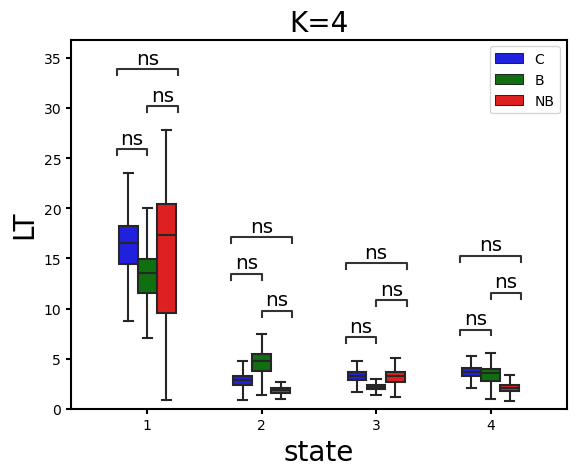

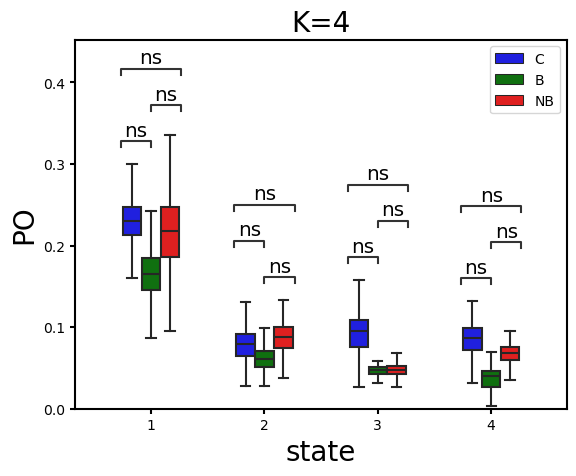

In [241]:
# Boostrapped version
K=4
for metrica in metrics:
    corrz = []
    groupz = []
    statez = []
    for group in ['C','B','NB']:
        for state in range(1,5):
            df_ = df_metrics.loc[df_metrics['group']==group]
            distr = df_.loc[df_['state']==state][metrica].values
            res = bootstrap((distr,), np.std, n_resamples=10000)
            bt_distr = res.bootstrap_distribution
    
            corrz = corrz + bt_distr.tolist()
            groupz = groupz + len(bt_distr)*[group]
            statez = statez + len(bt_distr)*[state]
            
    df__ = pd.DataFrame({metrica:corrz, 'groups':groupz, 'state':statez})
    state_order = [s for s in range(1,K+1)] # 0 because we start from the baseline state - no baseline state   
    groups_order = ['C', 'B', 'NB']
    pairs = [[(k,'C'),(k,'B')] for k in range(1,K+1)] + \
             [[(k,'C'),(k,'NB')] for k in range(1,K+1)] + \
             [[(k,'B'),(k,'NB')] for k in range(1,K+1)]
    my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
    
    annot_test =  'Brunner-Munzel'
    # annot_test = 't-test_ind'
    
    stats = []
    hue_plot_params = {
        'data': df__,
        'x': 'state',
        'y': metrica,
        "order": state_order,
        "hue": 'groups',
        "hue_order": groups_order,
        "palette": my_pal
    }
    
    fig,ax = plt.subplots(1,1, figsize=(K*1.5,5))
    with sns.plotting_context("notebook", font_scale = 1.2):
        # Create new plot
    #     ax = get_log_ax()
    
        # Plot with seaborn
        sns.boxplot(ax=ax, **hue_plot_params,
                         showfliers=False,
                         width=0.5)
        ax.set_xlabel('state',fontsize=20)
        ax.set_ylabel(metrica, fontsize=20)
        ax.set_ylim(0,)
    
        # Add annotations
        pvalues = conf_int_pval(pairs, metrica, df__, 'state', 'groups')
        annotator = Annotator(ax, pairs, **hue_plot_params)
        annotator.set_pvalues(pvalues)
        annotator.annotate()
    
        # Label and show
        plt.legend(loc='upper right', fontsize=10, bbox_to_anchor=(1.0,1.0))
        plt.title('K='+str(K), fontsize=20)
        plt.tight_layout()
        # plt.savefig('output/MD_05122023/K'+str(K)+'/'+metrica+'_bootstrap.png',
        #             dpi=200)

### LT and PO correlation with behavioral data

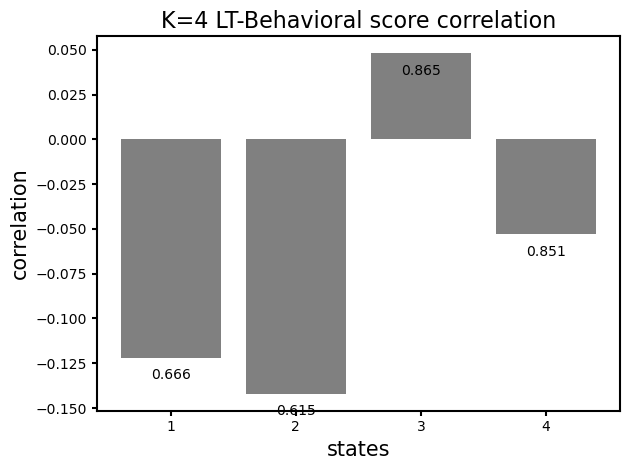

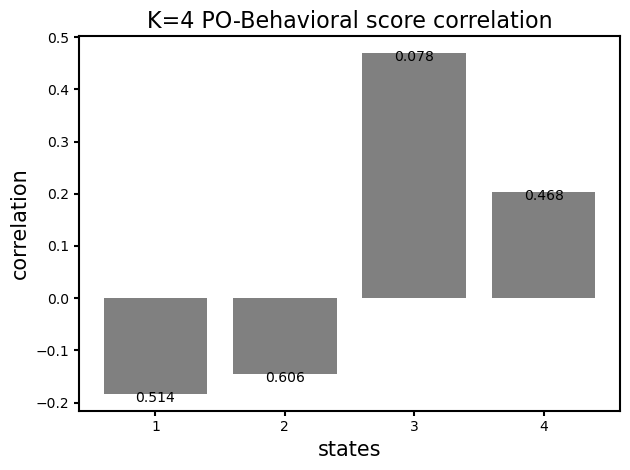

In [246]:
n_rep= 5000

cov_df = pd.read_csv("../data/covariates/covariates.csv",delimiter=",")
age_B = cov_df.loc[classif.loc[classif['CLASS']=='B'].index]['Age'].values
age_NB = cov_df.loc[classif.loc[classif['CLASS']=='NB'].index]['Age'].values
tstroke_B = cov_df.loc[classif.loc[classif['CLASS']=='B'].index]['Time since stroke (months)'].values
tstroke_NB = cov_df.loc[classif.loc[classif['CLASS']=='NB'].index]['Time since stroke (months)'].values
# age_B, age_NB, tstroke_B, tstroke_NB

B_behav = []
NB_behav = []

class_vals = classif['CLASS'].values
Behav = classif['CLASS'].values

res = classif['Average % correct task'].values[:19]
res = [float(r) for r in res]
for i,r in enumerate(res):
    if class_vals[i]=='B': 
        B_behav.append(r)
    elif class_vals[i]=='NB':
        NB_behav.append(r)

behav = []
behav.append(B_behav)
behav.append(NB_behav)

behavs = behav[0] + behav[1]
age = list(age_B) + list(age_NB)
tstroke = list(tstroke_B) + list(tstroke_NB)



for i,K in enumerate(range(2,10+1)): # Loop over K
    if K==4:
        ######################################
        ## CORRELATION WITH BEHAVIORAL DATA ##
        ######################################
        state_names = [i+1 for i in range(K)]
        x = B_behav + NB_behav

        LT_corr_perstate = []
        LT_pval_perstate = []
        PO_corr_perstate = []
        PO_pval_perstate = []
        for s in range(1,K+1):# Loop over states
            state_df = df_metrics.loc[df_metrics['state']==s]
            state_df_pat = state_df.loc[state_df['group']!='C']
            LT_perstate = state_df_pat['LT'].values
            PO_perstate = state_df_pat['PO'].values
            LT_my_df = pd.DataFrame.from_dict({'behav':x, 'prob':LT_perstate, 'age':age, 'tstroke':tstroke})
            PO_my_df = pd.DataFrame.from_dict({'behav':x, 'prob':PO_perstate, 'age':age, 'tstroke':tstroke})

            # LT
            my_df = LT_my_df
            # LT_stat, LT_pval = two_dim_par_corr_fullstat(my_df['behav'].values, my_df['prob'].values, my_df['age'].values, my_df['tstroke'].values, n_rep)
            pc = partial_corr(data=my_df, x='behav', y='prob', covar=['tstroke'],method="spearman").round(3)
            LT_stat = pc['r'].values[0]
            LT_pval = pc['p-val'].values[0]
            LT_corr_perstate.append(LT_stat)
            LT_pval_perstate.append(LT_pval)

            # PO
            my_df = PO_my_df
            # PO_stat, PO_pval = two_dim_par_corr_fullstat(my_df['behav'].values, my_df['prob'].values, my_df['age'].values, my_df['tstroke'].values, n_rep)
            pc = partial_corr(data=my_df, x='behav', y='prob', covar=['tstroke'],method="spearman").round(3)
            PO_stat = pc['r'].values[0]
            PO_pval = pc['p-val'].values[0]
            PO_corr_perstate.append(PO_stat)
            PO_pval_perstate.append(PO_pval)
        
        
        # LT 
        # Set the color of the bar according to the p-values
        colorz = []
        for p in LT_pval_perstate:
            if p<=0.05:
                colorz.append('magenta')
            elif p>0.05:
                colorz.append('grey')
                
        fig, ax = plt.subplots(1)
        ax.set_title('K='+str(K)+' LT-Behavioral score correlation', fontsize=16)
        bars = ax.bar(state_names, LT_corr_perstate, color=colorz, tick_label=state_names);
        # ax.bar_label(bars)
        for i, v in enumerate(LT_pval_perstate): # Plot p-values over the bars
            ax.text(i+1, LT_corr_perstate[i] - 0.012, str(v), horizontalalignment='center')
        ax.set_xlabel('states', fontsize=15)
        ax.set_ylabel('correlation', fontsize=15)
        plt.tight_layout()
        # plt.savefig('output/MD_05122023/K'+str(K)+'/LTvsBehav_Cov_K'+str(K)+'_nrep_test_'+str(n_rep)+'.png',
        #         dpi=200)

        # PO
        # Set the color of the bar according to the p-values
        colorz = []
        for p in PO_pval_perstate:
            if p<=0.05:
                colorz.append('magenta')
            elif p>0.05:
                colorz.append('grey')
                
        fig, ax = plt.subplots(1)
        ax.set_title('K='+str(K)+' PO-Behavioral score correlation', fontsize=16)
        bars = ax.bar(state_names, PO_corr_perstate, color=colorz, tick_label=state_names);
        # ax.bar_label(bars)        
        for i, v in enumerate(PO_pval_perstate): # Plot p-values over the bars
            ax.text(i+1, PO_corr_perstate[i] - 0.015, str(v), horizontalalignment='center')
        ax.set_xlabel('states', fontsize=15)
        ax.set_ylabel('correlation', fontsize=15)
        plt.tight_layout()
        # plt.savefig('output/MD_05122023/K'+str(K)+'/POvsBehav_Cov_K'+str(K)+'_nrep_test_'+str(n_rep)+'.png',
        #         dpi=200)

### Lifetime and Percentage of Occupancy representation (single subject representation) 

(14223,) 4.0
(4, 234)


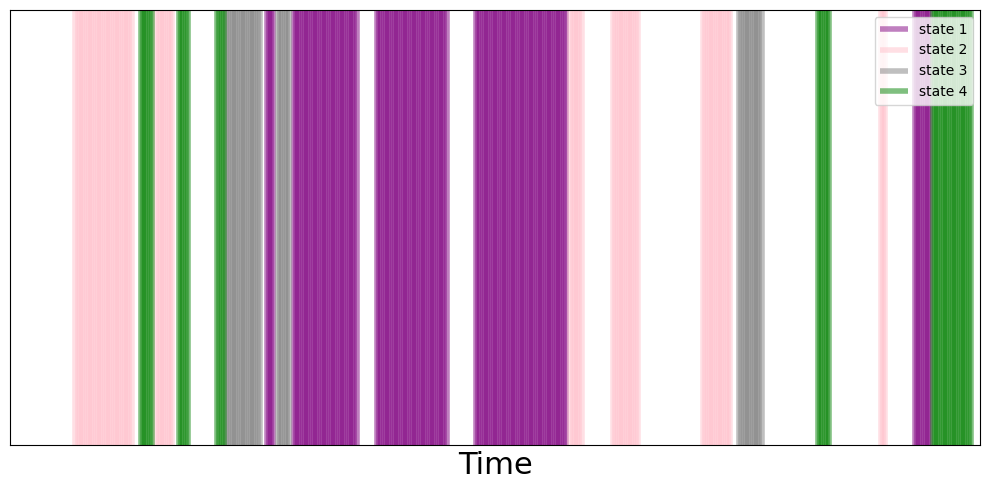

In [83]:
K = 4
k = K - 2 # MD start to cluster from K=2
# Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
state_labels = state_labels_list[k]
print(state_labels.shape, state_labels.max())
centroids = kmeans_leida[k]['C']
print(centroids.shape)

# today = date.today()
# DATE = today.strftime("%d%m%Y")
# # checking if the directory exists or not
# if not os.path.exists('output/GraphAnal/'+DATE+'/K'+str(K)):
      
#     # if the demo_folder directory is not present 
#     # then create it.
#     os.makedirs('output/GraphAnal/'+DATE+'/K'+str(K))

cs = ['purple', 'pink', 'grey', 'green', 'orange', 'tab:blue'] 
s=9

fig, ax = plt.subplots(1, figsize=(10,5))
ax.set_xticks([]);
ax.set_yticks([]);
for k_ in range(1,K+1):
    ax.vlines(np.where(state_labels[time_points*s:time_points*(s+1)]==k_),
              ymin=np.mean(Ev[time_points*s:time_points*(s+1)],axis=1).min(),
              ymax=np.mean(Ev[time_points*s:time_points*(s+1)],axis=1).max(), alpha=0.5,
              linewidth=4, color=cs[k_-1], label='state '+str(k_))
# ax.plot(np.mean(Ev[time_points*s:time_points*(s+1)],axis=1), linewidth=2, color='black', alpha=0.5)
ax.set_xlim(0, time_points)
ax.set_ylim(np.mean(Ev[time_points*s:time_points*(s+1)],axis=1).min(),
            np.mean(Ev[time_points*s:time_points*(s+1)],axis=1).max())
ax.set_xlabel('Time', fontsize=22)
# ax.set_ylabel('Average Brain Activity', fontsize=22)

plt.legend(bbox_to_anchor=(1,1))
plt.tight_layout()
plt.savefig('output/MD_05122023/states_example_new.png',
            dpi=300)

# Network analysis with phase locking matrices

### Subject-wise percolation

In [72]:
############################
### PERCOLATION ANALYSIS ###
############################

# Guardo come variano le metriche (tipo average shortest path e number of connected components) al variare della
# threshold che applico per binarizzare il grafo.
# Dovrei anche guardare cosa succede se vario la threshold che uso per le singole matrice di phase locking, ma lo
# facciamo un'altra volta

# I want to find the proper threshold for each states
# Explore the thresholds from -1

opt_graph_thresh_allK = []
for K in range(2,10+1): # Loop over K
    opt_graph_thresh_subs = []
    if K==4:
        print('K=',K)
        k = K - 2 # MD start to cluster from K=2
        # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
        state_labels = new_state_labels_sub_K[k] # state of belonging of each time point
        centroids = kmeans_leida[k]['C']
        print(centroids.shape)

        for sub in range(n_sub): # Loop over subjects
            print(subjects_code[sub])
            sub_pl = plm_tc[int(sub*T):int((sub+1)*T)] # Phase-locking matrices of the current subject
            sub_states = state_labels[int(sub*T):int((sub+1)*T)] # state labels of the current subject
            print(sub_pl.shape, sub_states.shape)
        
            short_path_sub = []
            n_conn_comp_sub = []
            for s in range(K): # Loop over states
                print('STATE ', s+1)

                x = np.arange(0,1,0.005) # all the possible threshold values (for the binarization)
                curr_state_pos = np.where(sub_states==s+1) # position of the time points belonging to the current state
                sub_state_pl = sub_pl[curr_state_pos] # phase locking matrices of the current state (of the current subject)
                print(sub_state_pl.shape)
                mean_sub_state_pl = sub_state_pl.mean(axis=0)
                
                short_path_state = []
                n_conn_comp_state = []
                for thresh in x: # Loop over the thresolds for the phase locking matrices
                    # Devo thresholdare pure la matrice media
                    thresh_mean_sub_state_pl = np.copy(mean_sub_state_pl)
                    thresh_mean_sub_state_pl = np.abs(thresh_mean_sub_state_pl) # Absolutize the pl matrix
                    thresh_mean_sub_state_pl[np.where(thresh_mean_sub_state_pl<thresh)] = 0 # Binarize the mean pl matrix according to the current thresh
                    thresh_mean_sub_state_pl[np.where(thresh_mean_sub_state_pl>=thresh)] = 1 # Binarize the mean pl matrix according to the current thresh
        
                    G = nx.from_numpy_array(thresh_mean_sub_state_pl)
                    # Which metrics I want to look at
                    short_path_state.append(graph_metrics('average_shortest_path', G))
                    n_conn_comp_state.append(graph_metrics('number_connected_components', G))
                short_path_sub.append(short_path_state)
                n_conn_comp_sub.append(n_conn_comp_state)


            # End of the loop over states of the current subject #
            #######################################
            ### PLOTS and find the opt TRESHOLD ###
            #######################################
            
            opt_graph_thresh_state = [] # Optimal binarization thresholds for each states of the current subject
            for s,short_path_state in enumerate(short_path_sub):
                opt_thresh = x[np.argmax(short_path_state)]
                opt_graph_thresh_state.append(opt_thresh)  
                # fig = plt.figure(figsize=(4.5,3))
                # plt.title('STATE {}  - opt. thresh = {} '.format(s+1, round(opt_thresh, 4)), fontsize=12)
                # plt.plot(x, short_path_state)
                # plt.xlabel('threshold')
                # plt.ylabel('average shortest path')
                # fig.tight_layout()
                # plt.savefig('output/MD_05122023/K'+str(K)+'/Percolation_ShortestPath_sub'+subjects_code[sub]+'_K'+str(K)+'_state'+str(s+1)+'.png',
                #             dpi=200)
            opt_graph_thresh_subs.append(opt_graph_thresh_state)
    opt_graph_thresh_allK.append(opt_graph_thresh_subs)
                

with open('output/MD_05122023/opt_graph_thresh_allK.pickle', 'wb') as handle:
    pickle.dump(opt_graph_thresh_allK, handle, protocol=pickle.HIGHEST_PROTOCOL)

K= 4
(4, 234)
H001
(431, 234, 234) (431,)
STATE  1
(157, 234, 234)
STATE  2
(73, 234, 234)
STATE  3
(51, 234, 234)
STATE  4
(19, 234, 234)
H002
(431, 234, 234) (431,)
STATE  1
(136, 234, 234)
STATE  2
(126, 234, 234)
STATE  3
(23, 234, 234)
STATE  4
(23, 234, 234)
H005
(431, 234, 234) (431,)
STATE  1
(203, 234, 234)
STATE  2
(73, 234, 234)
STATE  3
(76, 234, 234)
STATE  4
(8, 234, 234)
H006
(431, 234, 234) (431,)
STATE  1
(73, 234, 234)
STATE  2
(118, 234, 234)
STATE  3
(77, 234, 234)
STATE  4
(52, 234, 234)
H008
(431, 234, 234) (431,)
STATE  1
(346, 234, 234)
STATE  2
(33, 234, 234)
STATE  3
(7, 234, 234)
STATE  4
(10, 234, 234)
H009
(431, 234, 234) (431,)
STATE  1
(162, 234, 234)
STATE  2
(94, 234, 234)
STATE  3
(57, 234, 234)
STATE  4
(17, 234, 234)
H010
(431, 234, 234) (431,)
STATE  1
(90, 234, 234)
STATE  2
(64, 234, 234)
STATE  3
(58, 234, 234)
STATE  4
(59, 234, 234)
R006
(431, 234, 234) (431,)
STATE  1
(356, 234, 234)
STATE  2
(16, 234, 234)
STATE  3
(20, 234, 234)
STATE  4
(10

In [27]:
with open('output/MD_05122023/opt_graph_thresh_allK.pickle', 'rb') as handle:
    opt_threshes = pickle.load(handle)

In [67]:
# Apply the threshold to each phase-locking matrix
K = 4
k = K-2
thresh_plm_tc = np.empty((0,234,234))
state_labels = new_state_labels_sub_K[K-2]
for sub in range(n_sub): # Loop over subjects
    sub_state_labels = state_labels[int(sub*T):int((sub+1)*T)]
    sub_plm_tc = np.copy(plm_tc[int(sub*T):int((sub+1)*T)])
    for i,plm in enumerate(sub_pm_tc): # loop over all the phase locking matrices
        state = sub_state_labels[i]
        opt_thresh = opt_threshes[k][sub][state]
        plm = np.abs(plm) # absolutize
        plm[np.where(plm<opt_thresh)]=0 # binarize
        plm[np.where(plm>=opt_thresh)]=1 # binarize
        thresh_plm_tc = np.concatenate((thresh_plm_tc, plm))
    print(thresh_plm_tc.shape)

(14223, 234, 234)

### Bootstrapped percolation

K= 4
(4, 236)
4
STATE  1


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [11:18<00:00,  6.79s/it]


STATE  2


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [06:33<00:00,  3.94s/it]


STATE  3


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [05:48<00:00,  3.48s/it]


STATE  4


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [05:54<00:00,  3.54s/it]


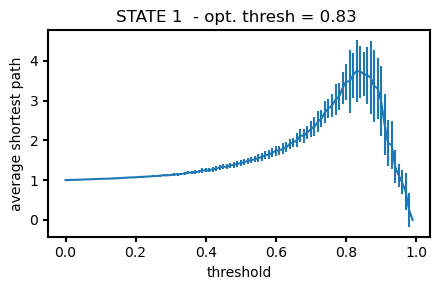

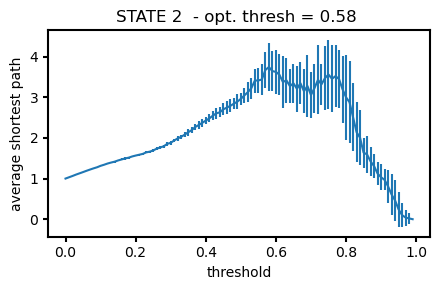

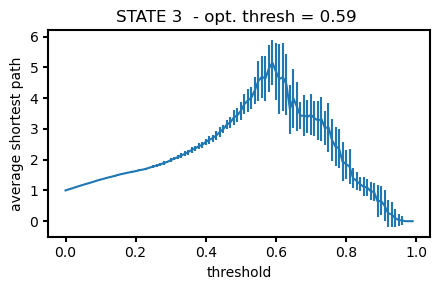

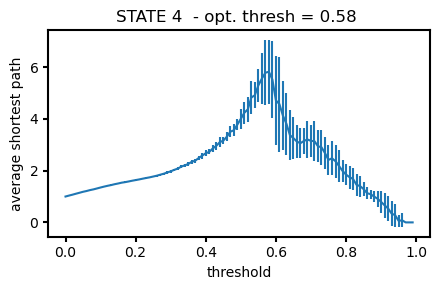

In [278]:
############################
### PERCOLATION ANALYSIS ###
############################

# Guardo come variano le metriche (tipo average shortest path e number of connected components) al variare della
# threshold che applico per binarizzare il grafo.
# Dovrei anche guardare cosa succede se vario la threshold che uso per le singole matrice di phase locking, ma lo
# facciamo un'altra volta

# I want to find the proper threshold for each states
# Explore the thresholds from -1


state_thresh_allK = []
for K in range(2,10+1): # Loop over K
    states_thresh = [] # For each state store threshold computed with percolation analysis
    if K==4:
        print('K=',K)
        k = K - 2 # MD start to cluster from K=2
        # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
        state_labels = new_state_labels_sub_K[k] # state of belonging of each time point
        centroids = kmeans_leida[k]['C']
        print(centroids.shape)
        
        # time points belonging to each state [state x time points]
        states_index = []
        for s in np.unique(state_labels)[1:]: # Remove the baseline state !!!!!!!!!!!!!!!!!!!!!!!!!
            states_index.append(np.where(state_labels==s))
        print(len(states_index))
        
        # Divide states indexes by group
        groups_index = []
        for g in np.unique(group_labels):
            groups_index.append(np.where(group_labels==g)[0])
            
        states_index_groups = [] # [state 1, state2, state 3]
        for s in states_index:
            groupz = {0:[], 1:[], 2:[]}
            for t in s[0]:
                groupz[group_labels[t][0]].append(t)
            states_index_groups.append(groupz)
        
        states_mets = []
        states_mets_2 = []
        for s in range(K): # Loop over states
            print('STATE ', s+1)
            mets = []
            mets_2 = []
            x = np.arange(0,1,0.01)
        #     x = [0.2, 0.6]
            for thresh_2 in tqdm.tqdm(x):
                # if thresh_2%0.2==0:
                #     print(thresh_2)
                thresh = 0.99
                n_pick = 50
                n_samp = 50
        
                met = []
                met_2 = []
                for t in range(n_pick):
                    # Pick a random s-ample of phase locking matrix
                    idxs = random.choices(states_index[s][0], k=n_samp)
                    mat = np.empty((0,plm_tc.shape[-2],plm_tc.shape[-1]))
                    for j in idxs:
        #                 print('pino', j)
                        np.fill_diagonal(plm_tc[j], 0) # Remove ones on the diagonal
                        m = plm_tc[j]
                        mat = np.concatenate((mat, np.expand_dims(m, axis=0)))
                    meanchia = mat.mean(axis=0)
                    meanchia = np.abs(meanchia)
                    # Devo thresholdare pure la matrice media
                    meanchia[np.where(meanchia<thresh_2)] = 0
                    meanchia[np.where(meanchia>=thresh_2)] = 1
        
                    # MEANCHIA DEVO TRESHOLDARLA PRIMA DI CREARE IL GRAFO
                    G = nx.from_numpy_array(meanchia)
                    # Which metrics I want to look at
                    met.append(graph_metrics('average_shortest_path', G ,list(mas_list.values())))
                    met_2.append(graph_metrics('number_connected_components', G ,list(mas_list.values())))
                mets.append(met)
                mets_2.append(met_2)
            states_mets.append(mets)
            states_mets_2.append(mets_2)
        
        ###########################
        ### PLOTS and THRESHOLD ###
        ###########################
        
        # shortest path 
        y_states = []
        y_err_states = []
        for mets in states_mets:
            y = []
            y_err = []
            for m in mets:
        #         y.append(np.median(m))
                y.append(np.mean(m))
                y_err.append(np.std(m))
            y_states.append(y)
            y_err_states.append(y_err)
        
        states_thresh = [] # For each state store threshold computed with percolation analysis
        
        for s,met in enumerate(y_states):
            fig = plt.figure(figsize=(4.5,3))
            plt.title('STATE {}  - opt. thresh = {} '.format(s+1, round(x[np.argmax(y_states[s])], 4)), 
                                                 fontsize=12)
            plt.errorbar(x, met, yerr=y_err_states[s])
            plt.xlabel('threshold')
            plt.ylabel('average shortest path')
            states_thresh.append(x[np.argmax(y_states[s])])    
            fig.tight_layout()
            # plt.savefig('output/MD_05122023/K'+str(K)+'/Percolation_ShortestPath_npick'+str(n_pick)+ \
            #             '_nsamp'+str(n_samp)+'_K'+str(K)+'_state'+str(s+1)+'.png',
            #             dpi=200, bbox_extra_artists=[my_sup])
        
            
        # # number connected components
        # y_states_2 = []
        # y_err_states_2 = []
        # for mets in states_mets_2:
        #     y = []
        #     y_err = []
        #     for m in mets:
        # #         y.append(np.median(m))
        #         y.append(np.mean(m))
        
        #         y_err.append(np.std(m))
        #     y_states_2.append(y)
        #     y_err_states_2.append(y_err)
        
        # for s,met in enumerate(y_states_2):
        #     fig = plt.figure(figsize=(4.5,3))
        #     plt.title('STATE {}'.format(s+1), fontsize=15)
        #     plt.errorbar(x, met, yerr=y_err_states_2[s])
        #     plt.xlabel('threshold')
        #     plt.ylabel('# of connected components')
        #     fig.tight_layout()
        #     # plt.savefig('output/MD_05122023/K'+str(K)+'/Percolation_NumConnComp_npick'+str(n_pick)+ \
        #     #             '_nsamp'+str(n_samp)+'_K'+str(K)+'_state'+str(s+1)+'.png',
        #     #             dpi=200, bbox_extra_artists=[my_sup])
        
            
    state_thresh_allK.append(states_thresh)


with open('output/AB_15052024/boot_percolation_opt_thresh.pickle', 'wb') as handle:
    pickle.dump(state_thresh_allK, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [282]:
with open('output/AB_15052024/boot_percolation_opt_thresh.pickle', 'rb') as handle:
    boot_opt_threshes = pickle.load(handle)

## Subject-wise network analysis

K= 4
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 3.33e-03 < p <= 1.67e-02
      **: 3.33e-04 < p <= 3.33e-03
     ***: 3.33e-05 < p <= 3.33e-04
    ****: p <= 3.33e-05

3_C vs. 3_B: Brunner-Munzel test, P_val:5.905e-01 W=5.469e-01
4_C vs. 4_B: Brunner-Munzel test, P_val:4.186e-01 W=8.416e-01
2_B vs. 2_NB: Brunner-Munzel test, P_val:7.998e-01 W=-2.631e-01
3_B vs. 3_NB: Brunner-Munzel test, P_val:6.966e-01 W=3.989e-01
4_B vs. 4_NB: Brunner-Munzel test, P_val:4.170e-01 W=-8.367e-01
1_C vs. 1_B: Brunner-Munzel test, P_val:6.922e-02 W=-1.991e+00
2_C vs. 2_B: Brunner-Munzel test, P_val:1.687e-01 W=1.426e+00
1_B vs. 1_NB: Brunner-Munzel test, P_val:8.303e-02 W=1.901e+00
3_C vs. 3_NB: Brunner-Munzel test, P_val:4.892e-01 W=7.136e-01
4_C vs. 4_NB: Brunner-Munzel test, P_val:9.173e-01 W=-1.062e-01
2_C vs. 2_NB: Brunner-Munzel test, P_val:4.752e-01 W=7.400e-01
1_C vs. 1_NB: Brunner-Munzel test, P_val:8.632e-01 W=1.749e-01


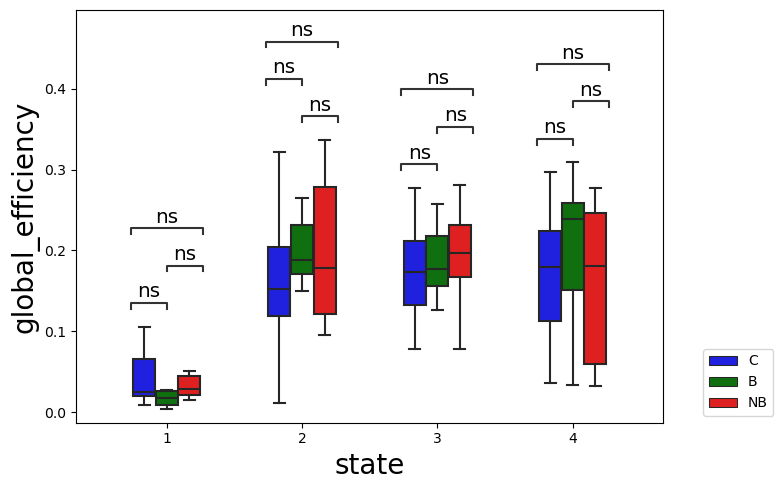

In [70]:
# GLOBAL METRICS


# Once I compute the optimal threshold I can compare metrics between groups
# metriche = ['average_shortest_path','number_connected_components','size_giant_component',
#             'fraction_of_edges','average_degree',
#             'average_local_efficiency', 'global_efficiency']
metriche = ['global_efficiency']
for i,K in enumerate(range(2,10+1)): # Loop over K
    if K==4:
    # if True:
        print('K=',K)
        k = K - 2 # MD start to cluster from K=2
        # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
        state_labels = new_state_labels_sub_K[k] # state of belonging of each time pointz

        mmm = [] # subject-state-wise measures of the current metric
        ggg = [] # group of each subject
        sss = [] # state of each measure
        for metrica in metriche:
            conf_dic = {}
            df_metrics = [] # List which contains dataframe for each state
            metrics = [] # metrics for each state
            for sub in range(n_sub): # Loop over subjects
                sub_group = subjects_group[sub]
                # print(subjects_code[sub], sub_group)
                sub_pl = plm_tc[int(sub*T):int((sub+1)*T)] # Phase-locking matrices of the current subject
                sub_states = state_labels[int(sub*T):int((sub+1)*T)] # state labels of the current subject
                # print(sub_pl.shape, sub_states.shape)

                for s in range(K): # Loop over states - exclude baseline state (0), ma lo faccio già prima
                    thresh = opt_threshes[k][sub][s]
                    curr_state_pos = np.where(sub_states==s+1) # position of the time points belonging to the current state
                    sub_state_pl = sub_pl[curr_state_pos] # phase locking matrices of the current state (of the current subject)
                    # print(sub_state_pl.shape)
                    mean_sub_state_pl = sub_state_pl.mean(axis=0)

                    # I have to evaluate the metrics for the three groups
                    # Devo thresholdare pure la matrice media
                    thresh_mean_sub_state_pl = np.copy(mean_sub_state_pl)
                    thresh_mean_sub_state_pl = np.abs(thresh_mean_sub_state_pl) # 
                    thresh_mean_sub_state_pl[np.where(mean_sub_state_pl<thresh)] = 0 # Binarize the mean pl matrix according to the current thresh
                    thresh_mean_sub_state_pl[np.where(mean_sub_state_pl>thresh)] = 1 # Binarize the mean pl matrix according to the current thresh
                    G = nx.from_numpy_array(thresh_mean_sub_state_pl)
                    measure = graph_metrics(metrica, G)

                    mmm.append(measure)
                    ggg.append(sub_group)
                    sss.append(s+1)
            
            df_metrics = pd.DataFrame(data = {metrica: mmm, 'groups': ggg, 'state':sss})

            ############
            ### PLOT ###
            ############
            state_order = [s for s in range(1,K+1)]
            groups_order = ['C', 'B', 'NB']
            pairs = [[(k,'C'),(k,'B')] for k in range(1,K+1)] + \
                     [[(k,'C'),(k,'NB')] for k in range(1,K+1)] + \
                     [[(k,'B'),(k,'NB')] for k in range(1,K+1)]
            my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
            annot_test =  'Brunner-Munzel'
            # annot_test = 't-test_ind'
        
            hue_plot_params = {
                'data': df_metrics,
                'x': 'state',
                'y': metrica,
                "order": state_order,
                "hue": 'groups',
                "hue_order": groups_order,
                "palette": my_pal
            }
            
            fig,ax = plt.subplots(1,1, figsize=(K*2,5))
            with sns.plotting_context("notebook", font_scale = 1.2):
                # Create new plot
            #     ax = get_log_ax()
        
                # Plot with seaborn
                sns.boxplot(ax=ax, **hue_plot_params,
                                 showfliers=False,
                                 width=0.5)
                ax.set_xlabel('state',fontsize=20)
                ax.set_ylabel(metrica, fontsize=20)
        
                # Add annotations
                # Cohen's D calculation
                annotator = Annotator(ax, pairs, **hue_plot_params)
                annotator.configure(test=annot_test, text_format='star', loc='inside')
                                    # ,comparisons_correction='Benjamini-Hochberg')
                annotator._pvalue_format.pvalue_thresholds =  [[0.0001/3, '****'], [0.001/3, '***'], [0.01/3, '**'], [0.05/3, '*'], [1, 'ns']]
                _, stat = annotator.apply_and_annotate()
        #         annamobbene = annotator.configure(test=annot_test).apply_and_annotate()
        
                # Label and show
                plt.legend(loc='lower right', fontsize=10, bbox_to_anchor=(1.2,0))
            plt.tight_layout()

            # plt.savefig('output/MD_05122023/K'+str(K)+'/NO_PL_thresh/GMETRICS_'+metrica+'_npick'+str(n_pick)+'_nsamp75minclust_K'+str(K)+'_no_annot.png',
            #             dpi=200)

        #     fig = plt.figure(figsize=(6,4))
        #     plt.title(metrica)
        #     with open('output/GraphAnal/'+DATE+'/'+metrica+'_npick'+str(n_pick)+'_nsamp'+str(n_samp)+'_'+DATE+'_ttest.txt', 'w') as f:
        #         for s in range(K):
        #         #     plt.ylim(0,1)
        #             bp = plt.boxplot([metrics[s][0], metrics[s][1], metrics[s][2]], positions = [s-eps, s, s+eps],
        #                              patch_artist=True,
        #                              labels=['','State'+str(s+1),''], showfliers=False)
        #             bp['boxes'][0].set_facecolor('blue')
        #             bp['boxes'][1].set_facecolor('green')
        #             bp['boxes'][2].set_facecolor('red')
        
        #             # t-tests 
        #             print('STATE ', s+1)
        #             test1 = ttest_ind(metrics[s][0], metrics[s][1])
        #             print(test1)
        #             test2 = ttest_ind(metrics[s][0], metrics[s][2])
        #             print(test2)
        #             test3 = ttest_ind(metrics[s][1], metrics[s][2])
        #             print(test3)
        #             print('\n')
        
        # #             # WRIte ttest results
        # #             f.write('STATE {}'.format(str(s+1)))
        # #             f.write('\n')
        # #             f.write(str(test1))
        # #             f.write(' CvsB')
        # #             f.write('\n')
        # #             f.write(str(test2))
        # #             f.write(' CvsNB')
        # #             f.write('\n')
        # #             f.write(str(test3))
        # #             f.write(' BvsNB')
        # #             f.write('\n')
        
        #     plt.legend([bp["boxes"][0], bp["boxes"][1], bp["boxes"][2]], ['C', 'B', 'NB'], loc='upper left')    
        #     p_1 = ttest_ind(C_met, B_met)[1]
        #     axs.set_title(metrica+' - p CvsB = {} CvsNB = {} BvsNB = {}'.format(round(p_1,4), round(p_2,4), round(p_3,4)), fontsize=11)
        #     axs.boxplot([C_met, B_met, NB_met], labels=['C','B','NB'], showfliers=False);

# print(conf_dic)
# for p_i,p in enumerate(pairs):
#     if not cond_dic[p_i]:
#         print(p)

## Bootstrapped network anlaysis

In [ ]:
%%time
# EFFICIENCY, INTEGRATION and SEGREGATION
# Modularity measures segregation

subcortical_idxs = atlas_labels.loc[atlas_labels['ROI_network']=='Subcortical'].index
cortical_idxs = atlas_labels.loc[atlas_labels['ROI_network']!='Subcortical'].index
full_c_sc_link = subcortical_idxs.shape[0]*cortical_idxs.shape[0]

eps = 0.1
# n_pick=10000
n_pick = 1000
metriche = ['cort_subcort_connectivity', 'homotopic_connectivity', 'modularity','modularity_macroareas','global_efficiency',
            'betweeness_centrality','degree_centrality']
# metriche = ['cortical_homotopic_connectivity','subcortical_homotopic_connectivity']
# metrica = 'global_efficiency'
for i,K in enumerate(range(2,10+1)): # Loop over K
    if K==4:
        k = K - 2 # MD start to cluster from K=2
        # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
        state_labels = new_state_labels_sub_K[k]
        # print(state_labels.shape, state_labels.max())
        centroids = kmeans_leida[k]['C']
        
        # time points belonging to each state [state x time points]
        states_index = []
        for s in np.unique(state_labels)[1:]: # Remove the baseline state !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
            states_index.append(np.where(state_labels==s))
        print(len(states_index))
        
        # Divide states indexes by group
        groups_index = []
        for g in np.unique(group_labels):
            groups_index.append(np.where(group_labels==g)[0])
            
        states_index_groups = [] # [state 1, state2, state 3]
        for s in states_index:
            groupz = {0:[], 1:[], 2:[]}
            for t in s[0]:
                groupz[group_labels[t][0]].append(t)
            states_index_groups.append(groupz)

        # find the number of point of the state with the smallest representation
        min_s  = []
        for g in range(3): # loop over groups
            min = 20000
            for s in states_index_groups: # loop over states
                # print(len(s[g]))
                if len(s[g]) < min:
                    min = len(s[g])
            min_s.append(min)
        
        metrics = [ [] for _ in range(len(metriche))] # metrics for each state
        for s in range(K): # Loop over states
            print('STATE ', s+1)
            thresh = boot_opt_threshes[i][s]

            mets = [ [] for _ in range(len(metriche))] # metrics for each group
            # I have to evaluate the metrics for the three groups
            for g_idx in range(3):
                n_samp = int(0.75*min_s[g_idx])
                print(n_samp)
                met = [ [] for _ in range(len(metriche))]
                for t in tqdm.tqdm(range(n_pick)):
                    # Pick a random s-ample of phase locking matrix
                    idxs = random.choices(states_index_groups[s][g_idx], k=n_samp)
                    mat = np.empty((0,plm_tc.shape[-2],plm_tc.shape[-1]))
                    for j in idxs:
                        np.fill_diagonal(plm_tc[j], 0) # Remove ones on the diagonal
                        m = plm_tc[j]
                        mat = np.concatenate((mat, np.expand_dims(m, axis=0)))
                    meanchia = mat.mean(axis=0)
                    meanchia = np.abs(meanchia)
                    # Devo thresholdare pure la matrice media
                    meanchia[np.where(meanchia<thresh)] = 0
                    meanchia[np.where(meanchia>=thresh)] = 1
        
                    # MEANCHIA DEVO TRESHOLDARLA PRIMA DI CREARE IL GRAFO
                    G = nx.from_numpy_array(meanchia)
                    # Which metrics I want to look at
                    for m_ind,metrica in enumerate(metriche):
                        if metrica == 'cort_subcort_connectivity':
                            met[m_ind].append(cort_subcort_connectivity(meanchia, full_c_sc_link, subcortical_idxs, cortical_idxs))
                        elif metrica == 'homotopic_connectivity':
                            met[m_ind].append(homotopic_connectivity(meanchia, full_c_sc_link)[0])
                        elif metrica == 'cortical_homotopic_connectivity':
                            met[m_ind].append(homotopic_connectivity(meanchia, full_c_sc_link)[1])
                        elif metrica == 'subcortical_homotopic_connectivity':
                            met[m_ind].append(homotopic_connectivity(meanchia, full_c_sc_link)[2])
                        else:
                            met[m_ind].append(graph_metrics(metrica, G, list(mas_list.values())))

                for m_ind,metrica in enumerate(metriche):
                    mets[m_ind].append(met[m_ind]) # groups
            for m_ind,metrica in enumerate(metriche):
                metrics[m_ind].append(mets[m_ind]) # states

# Store the results
with open('output/AB_15052024/GMETRICS_npick'+str(n_pick)+'.pickle', 'wb') as handle:
    pickle.dump(metrics, handle, protocol=pickle.HIGHEST_PROTOCOL)

4
STATE  1
546


100%|██████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [5:08:09<00:00, 18.49s/it]


163


100%|████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [25:50<00:00,  1.55s/it]


225


100%|████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [50:54<00:00,  3.05s/it]


STATE  2
546


  5%|████▌                                                                                       | 50/1000 [15:28<4:54:06, 18.58s/it]

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

3_C vs. 3_B: Custom statistical test, P_val:5.000e-02
4_C vs. 4_B: Custom statistical test, P_val:5.000e-02
2_B vs. 2_NB: Custom statistical test, P_val:1.000e+00
3_B vs. 3_NB: Custom statistical test, P_val:1.000e+00
4_B vs. 4_NB: Custom statistical test, P_val:1.000e+00
1_C vs. 1_B: Custom statistical test, P_val:1.000e+00
2_C vs. 2_B: Custom statistical test, P_val:1.000e+00
1_B vs. 1_NB: Custom statistical test, P_val:1.000e+00
3_C vs. 3_NB: Custom statistical test, P_val:1.000e+00
4_C vs. 4_NB: Custom statistical test, P_val:5.000e-02
2_C vs. 2_NB: Custom statistical test, P_val:1.000e+00
1_C vs. 1_NB: Custom statistical test, P_val:1.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ***

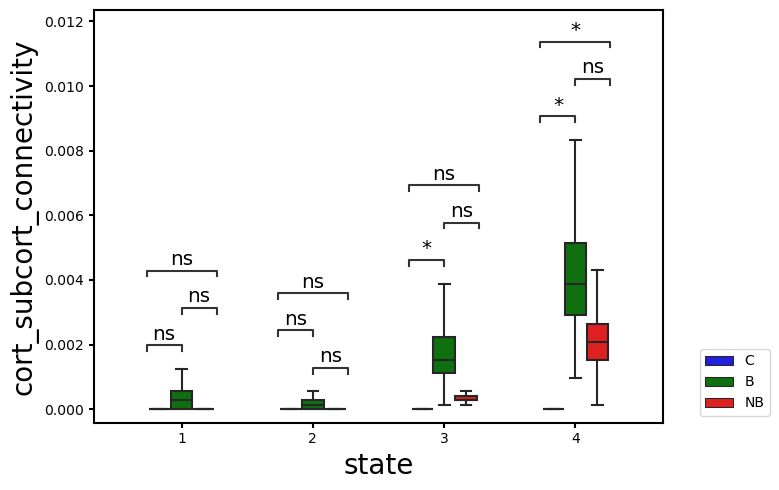

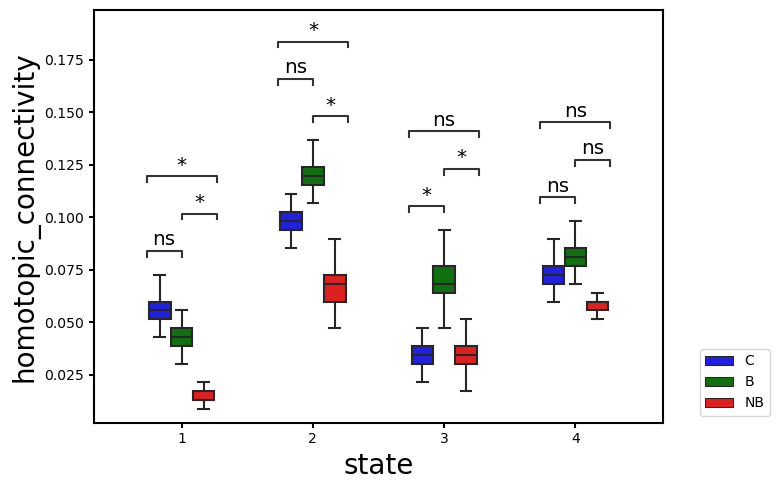

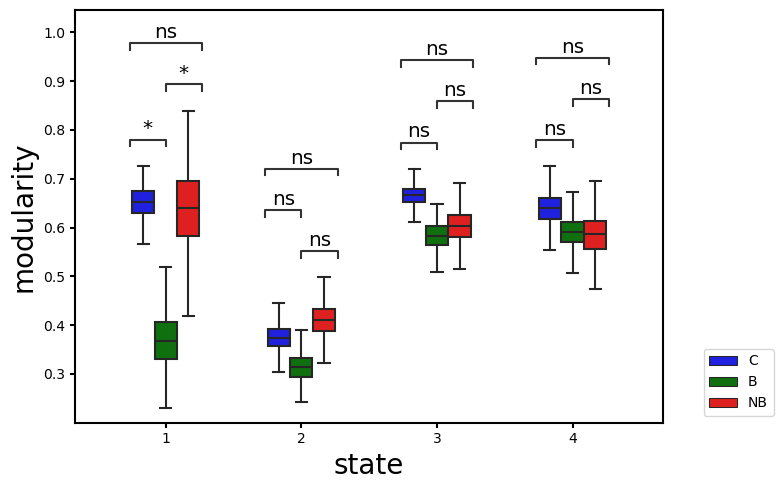

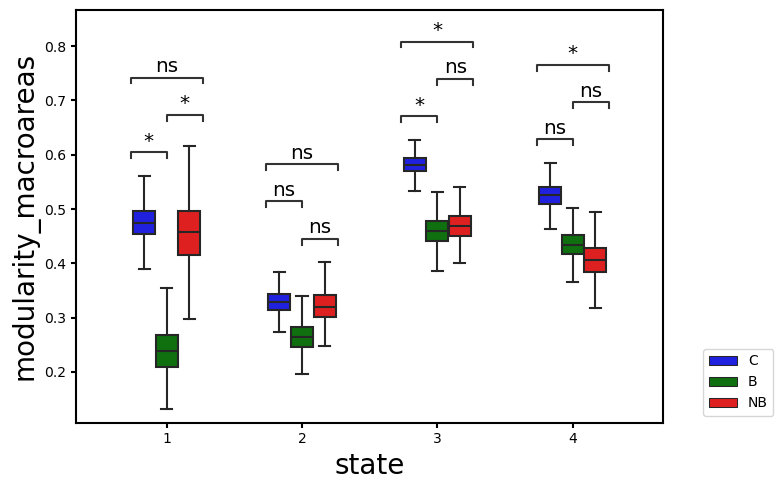

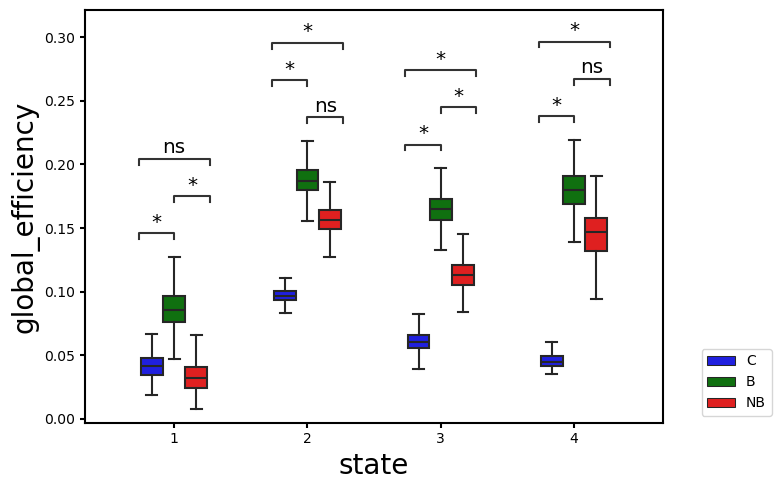

In [287]:
# GLOBAL METRICS PLOT
global_metrics = ['cort_subcort_connectivity', 'homotopic_connectivity', 'modularity','modularity_macroareas','global_efficiency']
K = 4
k = K - 2 # MD start to cluster from K=2
for m_ind,metrica in enumerate(metriche):
    if metrica in global_metrics:
        metric = np.asarray(metrics[m_ind])
        mmm = []
        ggg = []
        sss = []
        for kkk, m_state in enumerate(metric):
            mmm += m_state[0].tolist() + m_state[1].tolist() + m_state[2].tolist()
            ggg += ['C']*len(m_state[0]) + ['B']*len(m_state[1]) + ['NB']*len(m_state[2])
            sss += [kkk+1]*len(m_state[0].tolist() + m_state[1].tolist() + m_state[2].tolist())
        df_metrics = pd.DataFrame(data = {metrica: mmm, 'groups': ggg, 'state':sss})
        
        state_order = [s for s in range(1,K+1)]
        groups_order = ['C', 'B', 'NB']
        pairs = [[(k,'C'),(k,'B')] for k in range(1,K+1)] + \
                 [[(k,'C'),(k,'NB')] for k in range(1,K+1)] + \
                 [[(k,'B'),(k,'NB')] for k in range(1,K+1)]
        my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
        #     annot_test =  'Brunner-Munze'
        annot_test = 't-test_ind'
        
        hue_plot_params = {
            'data': df_metrics,
            'x': 'state',
            'y': metrica,
            "order": state_order,
            "hue": 'groups',
            "hue_order": groups_order,
            "palette": my_pal
        }
        
        fig,ax = plt.subplots(1,1, figsize=(K*2,5))
        with sns.plotting_context("notebook", font_scale = 1.2):
            # Create new plot
        #     ax = get_log_ax()
        
            # Plot with seaborn
            sns.boxplot(ax=ax, **hue_plot_params,
                             showfliers=False,
                             width=0.5)
            
            # pvalues = annotate_D(pairs, 'modularity', df_metrics)
            # Add annotations
            pvalues = conf_int_pval(pairs, metrica, df_metrics, 'state', 'groups')
            annotator = Annotator(ax, pairs, **hue_plot_params)
            annotator.set_pvalues(pvalues)
            annotator.annotate()
            ax.set_xlabel('state',fontsize=20)
            ax.set_ylabel(metrica, fontsize=20)
        
            # for p_i,p in enumerate(pairs):
            #     d1 = df_metrics.loc[df_metrics['groups']==p[0][1]].loc[df_metLrics['state']==p[0][0]][metrica].values
            #     d2 = df_metrics.loc[df_metrics['groups']==p[1][1]].loc[df_metrics['state']==p[1][0]][metrica].values
            
            #     inter1 = [np.percentile(d1,2.5), np.percentile(d1,97.5)]
            #     inter2 = [np.percentile(d2,2.5), np.percentile(d2,97.5)]
            
            #     conf_dic[p_i] = do_overlap(inter1,inter2)
        
            # Label and show
            plt.legend(loc='lower right', fontsize=10, bbox_to_anchor=(1.2, 0))
        plt.tight_layout()
        
        plt.savefig('output/AB_15052024/K'+str(K)+'/GMETRICS_'+metrica+'_npick'+str(n_pick)+'_nsamp75minclust_K'+str(K)+'.png',
                    dpi=200)
        
        # print(conf_dic)
        # for pin,v in enumerate(list(conf_dic.values())):
        #     if not v:
        #         print(pairs[pin])

(4, 3, 1000, 236)
(4, 3, 1000, 236)


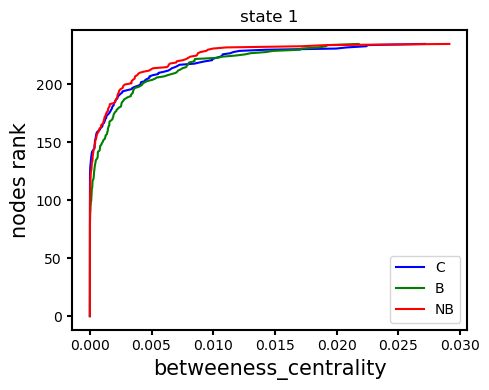

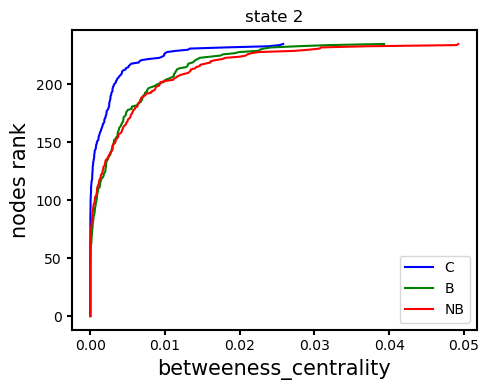

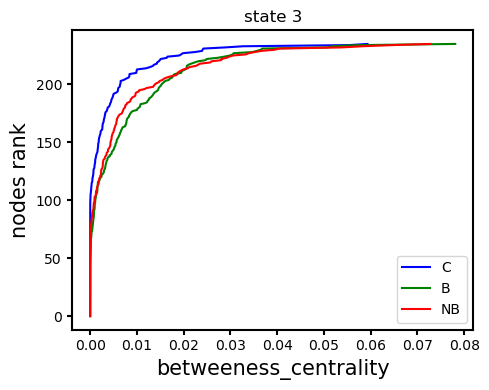

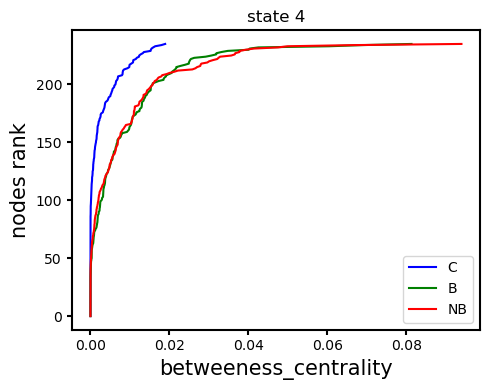

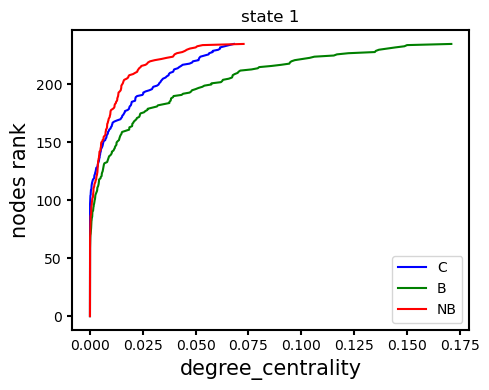

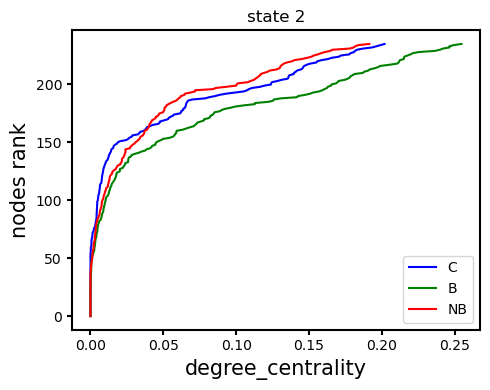

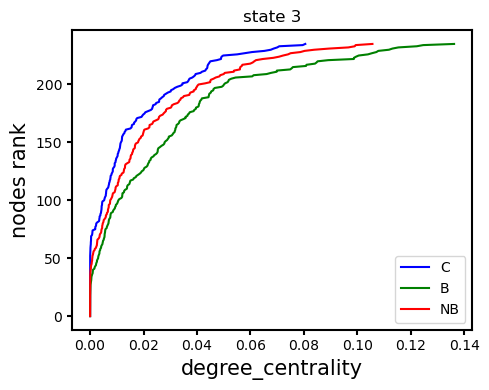

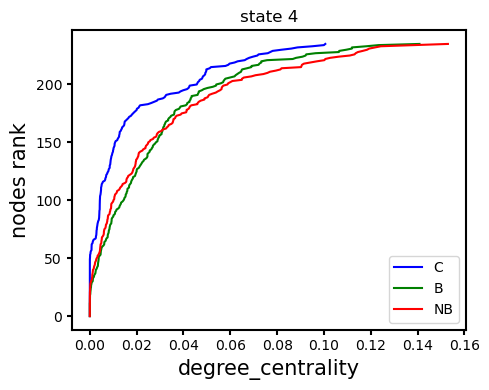

In [296]:
##### LOCAL METRICS PLOT #####
local_metrics = ['betweeness_centrality','degree_centrality']
K = 4
k = K - 2 # MD start to cluster from K=2
for m_ind,metrica in enumerate(metriche):
    if metrica in local_metrics:
        metric = np.asarray(metrics[m_ind])
        print(metric.shape)

        labels = ['C', 'B', 'NB']
        colors = ['blue','green','red']
        cmaps = ['RdBu','PiYG','bwr']

        # PLOT PARDALOS CURVES
        for s in range(K):
            fig,ax = plt.subplots(1,1, figsize=(5, 4))
            ax.set_title('state {}'.format(s+1))
            for g in range(3):
                m = np.mean(metric[s][g], axis=0)
                m = np.sort(m)
                ax.plot(m,range(m.shape[0]), label=labels[g], color=colors[g])
                ax.set_xlabel(metrica, fontsize=15)
                ax.set_ylabel('nodes rank', fontsize=15)
    
            ax.legend(loc='lower right')
            fig.tight_layout()
            
            plt.savefig('output/AB_15052024/K'+str(K)+'/GMETRICS_'+metrica+'_state'+str(s+1)+'_npick'+str(n_pick)+'_nsamp75minclust_K'+str(K)+'.png',
                        dpi=200)
    
        # for nodes_set_ in list(intr_nodes_dic.keys()): # Loop over interesting nodes
        #     print(nodes_set_)
        #     nodes_set = intr_nodes_dic[nodes_set_]
        #     # aggregate the values of all the areas of the current set of nodes
        #     metric_aggr = np.empty((K,3,n_pick))
        #     for n in nodes_set:
        #         metric_aggr = np.concatenate((metric_aggr, metric[:,:,:,n]),axis=-1)
        #     # print(metric_aggr.shape)
                
        #     conf_dic = {}
        #     mmm = []
        #     ggg = []
        #     sss = []
        #     for kkk, m_state in enumerate(metric_aggr): # Loop over states
        #         # print(len(m_state[0]), m_state[1].shape, m_state[2].shape)
        #         mmm += m_state[0].tolist() + m_state[1].tolist() + m_state[2].tolist()
        #         ggg += ['C']*len(m_state[0]) + ['B']*len(m_state[1]) + ['NB']*len(m_state[2])
        #         sss += [kkk+1]*len(m_state[0].tolist() + m_state[1].tolist() + m_state[2].tolist())
    
        #         # print(len(mmm), len(ggg), len(sss))
        #     where_huge = np.where(np.asarray(mmm)>1)[0]
        #     if len(where_huge)!=0:
        #         mmm = np.asarray(mmm)
        #         mmm[where_huge] = 0
        #     df_metrics = pd.DataFrame(data = {metrica: mmm, 'groups': ggg, 'state':sss})
            
        #     state_order = [s for s in range(1,K+1)]
        #     groups_order = ['C', 'B', 'NB']
        #     pairs = [[(k,'C'),(k,'B')] for k in range(1,K+1)] + \
        #              [[(k,'C'),(k,'NB')] for k in range(1,K+1)] + \
        #              [[(k,'B'),(k,'NB')] for k in range(1,K+1)]
        #     my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
            
        #     hue_plot_params = {
        #         'data': df_metrics,
        #         'x': 'state',
        #         'y': metrica,
        #         "order": state_order,
        #         "hue": 'groups',
        #         "hue_order": groups_order,
        #         "palette": my_pal
        #     }
            
        #     fig,ax = plt.subplots(1,1, figsize=(K*2,5))
        #     ax.set_title(nodes_set_)
        #     with sns.plotting_context("notebook", font_scale = 1.2):
        #         # Create new plot
        #     #     ax = get_log_ax()
        
        #         # Plot with seaborn
        #         sns.boxplot(ax=ax, **hue_plot_params,
        #                          showfliers=False,
        #                          width=0.5)
                
        #         pvalues = conf_int_pval(pairs, metrica, df_metrics)
        #         # Add annotations
        #         annotator = Annotator(ax, pairs, **hue_plot_params)
        #         annotator.set_pvalues(pvalues)
        #         annotator.annotate()
        #         ax.set_xlabel('state',fontsize=20)
        #         ax.set_ylabel(metrica, fontsize=20)
        
        #         # for p_i,p in enumerate(pairs):
        #         #     d1 = df_metrics.loc[df_metrics['groups']==p[0][1]].loc[df_metrics['state']==p[0][0]][metrica].values
        #         #     d2 = df_metrics.loc[df_metrics['groups']==p[1][1]].loc[df_metrics['state']==p[1][0]][metrica].values
                
        #         #     inter1 = [np.percentile(d1,2.5), np.percentile(d1,97.5)]
        #         #     inter2 = [np.percentile(d2,2.5), np.percentile(d2,97.5)]
                
        #         #     conf_dic[p_i] = do_overlap(inter1,inter2)
            
        #         # Label and show
        #         plt.legend(loc='lower right', fontsize=10, bbox_to_anchor=(1.2, 0))
        #     plt.tight_layout()
        
        #     # plt.savefig('output/AB_15052024/K'+str(K)+'/local_metrics/n_pick'+str(n_pick)+'/GMETRICS_area'+nodes_set_+'_'+metrica+'_npick'+str(n_pick)+'_nsamp75minclust_K'+str(K)+'.png',
        #     #             dpi=200)
    
    
        #     # print(conf_dic)
        #     # for pin,v in enumerate(list(conf_dic.values())):
        #     #     if not v:
        #     #         print(pairs[pin])

In [ ]:
# %%time
# # CORTICO-SUCORCORTICO CONNECTIONS (BOXPLOT)

# subcortical_idxs = atlas_labels.loc[atlas_labels['super network']=='Subcortical'].index
# cortical_idxs = atlas_labels.loc[atlas_labels['super network']!='Subcortical'].index
# full_c_sc_link = subcortical_idxs.shape[0]*cortical_idxs.shape[0]

# metrics_label = ['cort_subcort_connectivity', 'homotopic_connectivity']

# n_pick = 200
# n_samp = 2 # Sampling number is the 75% of time points belonging to the pattern with smallest representation.
# eps = 0.1
# for i,K in enumerate(range(2,10+1)): # Loop over K
#     k = K - 2 # MD start to cluster from K=2
#     if K==4:
#         # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
#         state_labels = new_state_labels_sub_K[k]
#         # print(state_labels.shape, state_labels.max())
#         centroids = kmeans_leida[k]['C']
        
#         # time points belonging to each state [state x time points]
#         states_index = []
#         for s in np.unique(state_labels)[1:]: # Remove the baseline state !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
#             states_index.append(np.where(state_labels==s))
#         # print(len(states_index))
        
#         # Divide states indexes by group
#         groups_index = []
#         for g in np.unique(group_labels):
#             groups_index.append(np.where(group_labels==g)[0])
            
#         states_index_groups = [] # [state 1, state2, state 3]
#         for s in states_index:
#             groupz = {0:[], 1:[], 2:[]}
#             for t in s[0]:
#                 groupz[group_labels[t][0]].append(t)
#             states_index_groups.append(groupz)
    
#         # find the number of point of the state with the smallest representation
#         min_s  = []
#         for g in range(3): # loop over groups
#             min = 20000
#             for s in states_index_groups: # loop over states
#                 # print(len(s[g]))
#                 if len(s[g]) < min:
#                     min = len(s[g])
#             min_s.append(min)
        
#         states_thresh = opt_threshes[i]
#         # print(states_thresh)
#         maps_metrics = []
#         piero = 0
#         print(metrics_label[piero])
#         metrics1 = [] # metrics for each state
#         metrics2 = [] # metrics for each state
#         for s in range(K): # Loop over states
#             print('STATE ', s+1)
#             thresh_2 = boot_opt_threshes[k][s]
#             print(thresh_2)
#             mets1 = [] # metrics for each group
#             mets2 = [] # metrics for each group
#             # I have to evaluate the metrics for the three groups
#             for g_idx in range(3):
#                 n_samp = int(0.75*min_s[g_idx])
#                 met1 = []
#                 met2 = []
#                 for t in range(n_pick):
#                     # Pick a random s-ample of phase locking matrix
#                     idxs = random.choices(states_index_groups[s][g_idx], k=n_samp)
#                     mat = np.empty((0,plm_tc.shape[-2],plm_tc.shape[-1]))
#                     for j in idxs:
#                         np.fill_diagonal(plm_tc[j], 0) # Remove ones on the diagonal
#                         m = plm_tc[j]
#                         mat = np.concatenate((mat, np.expand_dims(m, axis=0)))
#                     meanchia = mat.mean(axis=0)
#                     meanchia = np.abs(meanchia)
#                     # Devo thresholdare pure la matrice media
#                     meanchia[np.where(meanchia<thresh_2)] = 0
#                     meanchia[np.where(meanchia>=thresh_2)] = 1
    
#                     # MEANCHIA DEVO TRESHOLDARLA PRIMA DI CREARE IL GRAFO
#                     # G = nx.from_numpy_array(meanchia) # I DON'T NEED THE GRAPH, I CAN WORK WITH THE ADJACENCY MATRIX
#                     # Which metrics I want to look at
                    
#                     # Take only the cortico-subcortical link
#                     sub_meanchia = meanchia[subcortical_idxs]
#                     sub_meanchia[:,subcortical_idxs]=0
#                     # number of cortico-subcortical link
#                     perc_c_sc_link = np.sum(sub_meanchia)/full_c_sc_link

#                     # Inter hemispheric connections
#                     cort_homo = np.sum(np.diag(meanchia[:200,:200]))
#                     scoll_homo = np.sum(meanchia[-1,-2])
#                     subcort_homo = np.sum(np.diag(meanchia[200:232, 200:232]))
                    
#                     homo_conn = cort_homo + scoll_homo + subcort_homo

                    
                    
#                     met1.append(perc_c_sc_link)
#                     met2.append(homo_conn)
#                 mets1.append(met1) # groups
#                 mets2.append(met2) # groups
#             metrics1.append(mets1) # states
#             metrics2.append(mets2) # states
#         all_metrics =[metrics1, metrics2]
    
    
#         labels = ['C', 'B', 'NB']
#         colors = ['blue','green','red']
#         cmaps = ['RdBu','PiYG','bwr']

#         for m_i, metrics in enumerate(all_metrics):
    
#             mmm = []
#             ggg = []
#             sss = []
#             for kkk, m_state in enumerate(metrics):
#                 mmm += m_state[0] + m_state[1] + m_state[2]
#                 ggg += ['C']*len(m_state[0]) + ['B']*len(m_state[1]) + ['NB']*len(m_state[2])
#                 sss += [kkk+1]*len(m_state[0] + m_state[1] + m_state[2])
#             df_metrics = pd.DataFrame(data = {metrics_label[m_i]: mmm, 'groups': ggg, 'state':sss})
#             state_order = [s for s in range(1,K+1)]
#             groups_order = ['C', 'B', 'NB']
#             pairs = [[(k,'C'),(k,'B')] for k in range(1,K+1)] + \
#                      [[(k,'C'),(k,'NB')] for k in range(1,K+1)] + \
#                      [[(k,'B'),(k,'NB')] for k in range(1,K+1)]
#             my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
#         #     annot_test =  'Brunner-Munze'
#             annot_test = 't-test_ind'
        
#             hue_plot_params = {
#                 'data': df_metrics,
#                 'x': 'state',
#                 'y': metrics_label[m_i],
#                 "order": state_order,
#                 "hue": 'groups',
#                 "hue_order": groups_order,
#                 "palette": my_pal
#             }
            
#             fig,ax = plt.subplots(1,1, figsize=(K*2,5))
#             with sns.plotting_context("notebook", font_scale = 1.2):
                
#                 # Plot with seaborn
#                 sns.boxplot(ax=ax, **hue_plot_params,
#                                  showfliers=False,
#                                  width=0.5)
#                 ax.set_xlabel('state',fontsize=20)
#                 ax.set_ylabel(metrics_label[m_i], fontsize=20)
        
#         #         # Add annotations
#         #         # Cohen's D calculation
#         #         pvalues = annotate_D(pairs, metrica, df_metrics)
#         #         print(pairs)
#         #         annotator = Annotator(ax, pairs, **hue_plot_params)
#         #         annotator.set_pvalues(pvalues)
#         #         annotator.annotate()
#         # #         annamobbene = annotator.configure(test=annot_test).apply_and_annotate()
        
#                 # Label and show
#                 plt.legend(loc='lower right', fontsize=10, bbox_to_anchor=(1.2,0))
#             plt.tight_layout()
#             plt.savefig('output/MD_05122023/K'+str(K)+'/GMETRICS_'+metrics_label[m_i]+'_npick'+str(n_pick)+'_nsamp75minclust_K'+str(K)+'_no_annot.png',
#                         dpi=200)
#             print(metrics_label[m_i])
#             for p_i,p in enumerate(pairs):
#                 d1 = df_metrics.loc[df_metrics['groups']==p[0][1]].loc[df_metrics['state']==p[0][0]][metrics_label[m_i]].values
#                 d2 = df_metrics.loc[df_metrics['groups']==p[1][1]].loc[df_metrics['state']==p[1][0]][metrics_label[m_i]].values
            
#                 inter1 = [np.percentile(d1,2.5), np.percentile(d1,97.5)]
#                 inter2 = [np.percentile(d2,2.5), np.percentile(d2,97.5)]
            
#                 conf_dic[p_i] = do_overlap(inter1,inter2)
#                 if not do_overlap(inter1,inter2):
#                     print(p)

    

## Local metrics

In [68]:
from nilearn import plotting

(4, 234)
4
[0.91, 0.87, 0.81, 0.79]
betweenness centrality
STATE  1
0.91
STATE  2
0.87
STATE  3
0.81
STATE  4
0.79


/home/alessio/miniconda3/envs/bs_laido_new/lib/python3.12/site-packages/nilearn/_utils/niimg.py:61: UserWarning: Non-finite values detected. These values will be replaced with zeros.
  warn(


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

154_C vs. 154_B: Custom statistical test, P_val:1.000e+00
187_C vs. 187_B: Custom statistical test, P_val:1.000e+00
178_C vs. 178_B: Custom statistical test, P_val:1.000e+00
76_C vs. 76_B: Custom statistical test, P_val:1.000e+00
65_B vs. 65_NB: Custom statistical test, P_val:1.000e+00
154_B vs. 154_NB: Custom statistical test, P_val:1.000e+00
187_B vs. 187_NB: Custom statistical test, P_val:1.000e+00
178_B vs. 178_NB: Custom statistical test, P_val:1.000e+00
76_B vs. 76_NB: Custom statistical test, P_val:1.000e+00
190_C vs. 190_B: Custom statistical test, P_val:1.000e+00
65_C vs. 65_B: Custom statistical test, P_val:1.000e+00
190_B vs. 190_NB: Custom statistical test, P_val:1.000e+00
154_C vs. 154_NB: Custom statistical test, P_val:1.000e+00
187_C vs. 187_NB: Custom statistical test, P_val:5.000e-02
178_C v

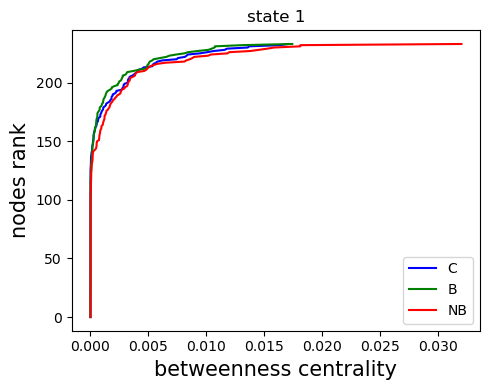

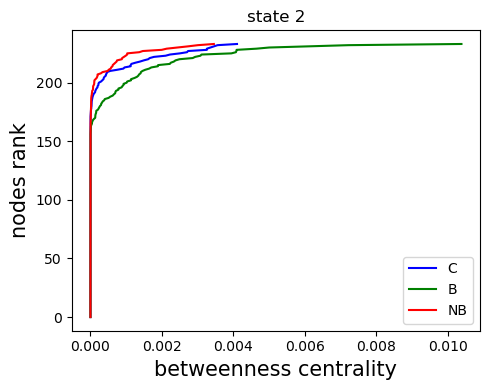

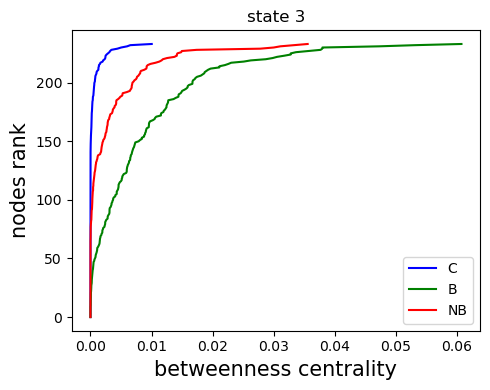

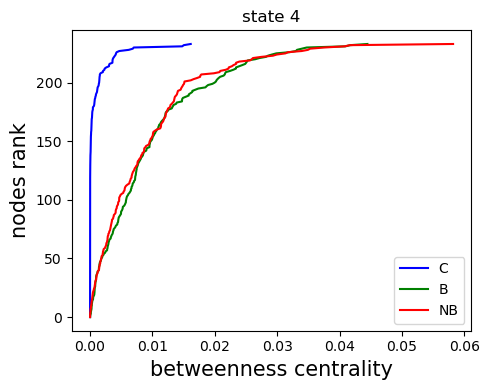

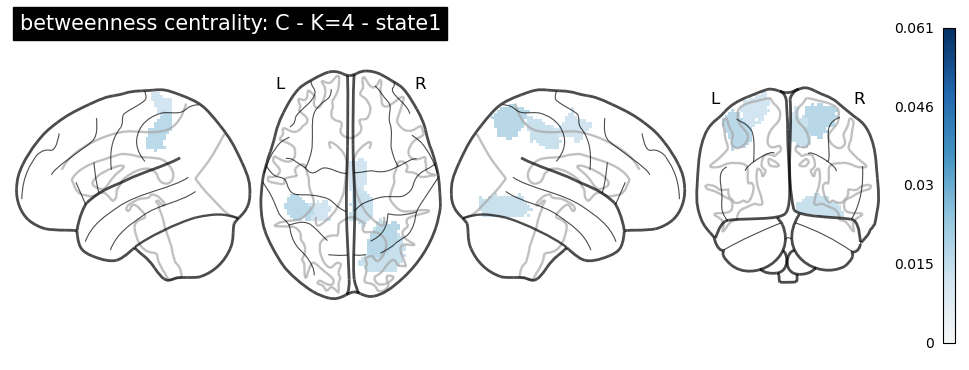

...

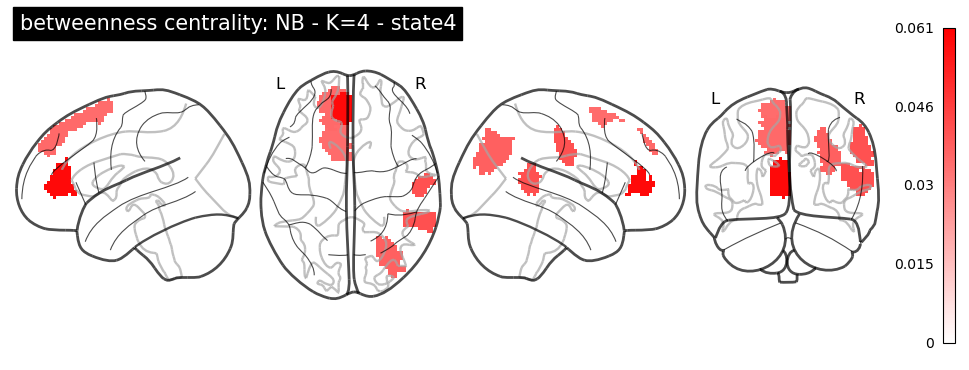

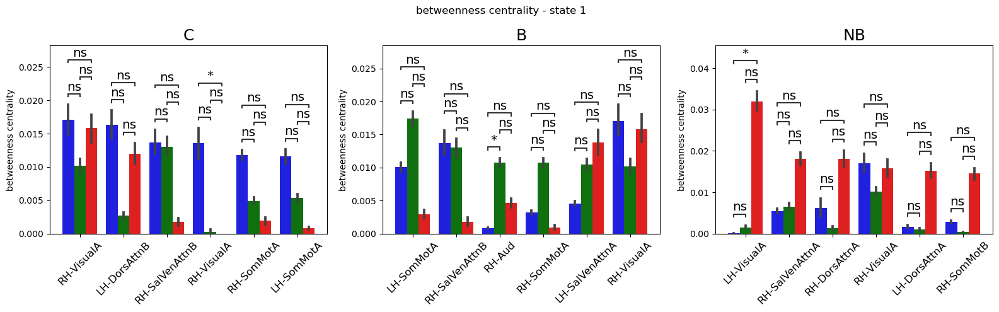

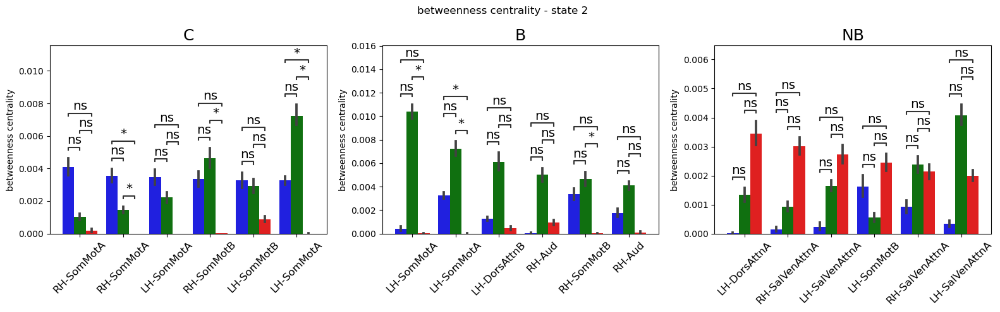

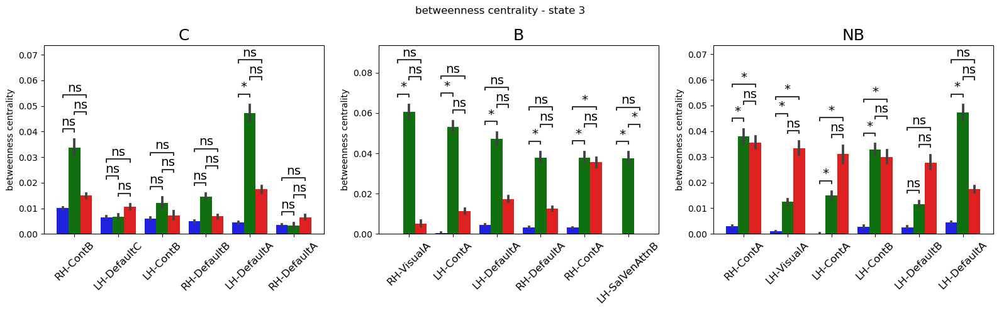

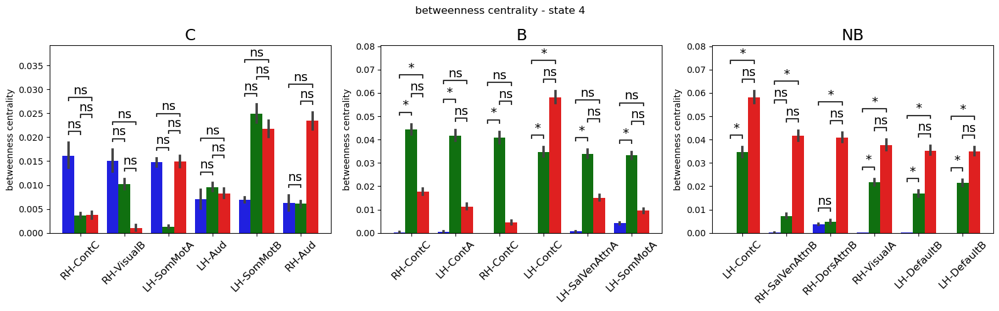

In [71]:
%%time
# PARDALOS PLOT - rank each node with respect to local efficiency

# metriche_label = ['betweenness centrality', 'local efficiency']
metriche_label = ['betweenness centrality']
# metriche_label = ['local efficiency']

# metrica='local_efficiency_notav'
# metrichee=['betweeness_centrality', 'local_efficiency_notav']
metrichee=['betweeness_centrality']
# metrichee=['local_efficiency_notav']

# metrica='eigenvector_centrality'
thresh = 0.99
n_pick = 200
n_samp = 10 # Sampling number is the 75% of time points belonging to the pattern with smallest representation.
eps = 0.1
for i,K in enumerate(range(2,10+1)): # Loop over K
    k = K - 2 # MD start to cluster from K=2
    if K==4:

        # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
        state_labels = state_labels_list[k]
        # print(state_labels.shape, state_labels.max())
        centroids = kmeans_leida[k]['C']
        print(centroids.shape)
        
        # time points belonging to each state [state x time points]
        states_index = []
        for s in np.unique(state_labels)[1:]: # Remove the baseline state !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
            states_index.append(np.where(state_labels==s))
        print(len(states_index))
        
        # Divide states indexes by group
        groups_index = []
        for g in np.unique(group_labels):
            groups_index.append(np.where(group_labels==g)[0])
            
        states_index_groups = [] # [state 1, state2, state 3]
        for s in states_index:
            groupz = {0:[], 1:[], 2:[]}
            for t in s[0]:
                groupz[group_labels[t][0]].append(t)
            states_index_groups.append(groupz)
    
        # find the number of point of the state with the smallest representation
        min_s  = []
        for g in range(3): # loop over groups
            min = 20000
            for s in states_index_groups: # loop over states
                # print(len(s[g]))
                if len(s[g]) < min:
                    min = len(s[g])
            min_s.append(min)
        
        states_thresh = opt_threshes[i]
        print(states_thresh)
        maps_metrics = []
        piero = 0
        for metrica in metrichee:
            print(metriche_label[piero])
            metrics = [] # metrics for each state- 
            for s in range(K): # Loop over states
                print('STATE ', s+1)
                thresh_2 = states_thresh[s]
                print(thresh_2)
                mets = [] # metrics for each group
                # I have to evaluate the metrics for the three groups
                for g_idx in range(3):
                    n_samp = int(0.75*min_s[g_idx])
                    met = []
                    met = np.empty((0,plm_tc.shape[-2]))
                    for t in range(n_pick):
                        # Pick a random s-ample of phase locking matrix
                        idxs = random.choices(states_index_groups[s][g_idx], k=n_samp)
                        mat = np.empty((0,plm_tc.shape[-2],plm_tc.shape[-1]))
                        for j in idxs:
                            np.fill_diagonal(plm_tc[j], 0) # Remove ones on the diagonal
                            m = plm_tc[j]
                            m = np.abs(m)
                            if PL_thresh: 
                                m[np.where(m<thresh)] = 0
                            mat = np.concatenate((mat, np.expand_dims(m, axis=0)))
                        meanchia = mat.mean(axis=0)
                        # Devo thresholdare pure la matrice media
                        meanchia[np.where(meanchia<thresh_2)] = 0
        
                        # MEANCHIA DEVO TRESHOLDARLA PRIMA DI CREARE IL GRAFO
                        G = nx.from_numpy_array(meanchia)
                        # Which metrics I want to look at
                        mmm = graph_metrics(metrica, G)
                        mmm = np.expand_dims(np.asarray(mmm), axis=0)
                        met = np.concatenate((met, mmm))
                    mets.append(met) # groups
                metrics.append(mets) # states
        
        
            labels = ['C', 'B', 'NB']
            colors = ['blue','green','red']
            cmaps = ['RdBu','PiYG','bwr']
    
            # PLOT PARDALOS CURVES
            for s in range(K):
                fig,ax = plt.subplots(1,1, figsize=(5, 4))
                ax.set_title('state {}'.format(s+1))
                for g in range(3):
                    m = np.mean(metrics[s][g], axis=0)
                    m = np.sort(m)
                    ax.plot(m,range(m.shape[0]), label=labels[g], color=colors[g])
                    ax.set_xlabel(metriche_label[piero], fontsize=15)
                    ax.set_ylabel('nodes rank', fontsize=15)
        
                ax.legend(loc='lower right')
                fig.tight_layout()
                
                if PL_thresh: 
                    plt.savefig('output/MD_05122023/K'+str(K)+'/Pardalos_'+metrica+'_npick'+ \
                                str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                                dpi=200)
                else:
                    plt.savefig('output/MD_05122023/K'+str(K)+'/NO_PL_thresh/Pardalos_'+metrica+'_npick'+ \
                                str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                                dpi=200)   
    
    
            # PLOT LOCAL EFFICIENCY AND BETWEENESS OVER THE BRAIN - CERVELLINI
            for s in range(K): # Loop over states
                fig = plt.figure()
                # ax.set_title('state {}'.format(s+1))
                m__ = np.mean(metrics, axis=2)
                for g in range(3):
                    m = np.mean(metrics[s][g], axis=0) # Local Eff/Betweeness centr for each node
                    le_rank = np.argsort(m)[::-1]
                    empty_brain = np.full(atlas.shape, np.nan)
                    for a_idx in le_rank[:6]: # Loop over the areas
                        m_a = m[a_idx]
                        cord = np.where(atlas==a_idx+1)
                        empty_brain[cord[0], cord[1], cord[2]] = m_a
                    nii_brain = nib.Nifti1Image(empty_brain, affine=atlas_affine)
                    plotting.plot_glass_brain(nii_brain, display_mode='lzry', cmap=cmaps[g], colorbar=True,
                                              vmin=0, vmax=m__.max(), symmetric_cbar=False, plot_abs=True,
                                              # symmetric_cbar=False, plot_abs=True,
                                              title=metriche_label[piero]+': '+labels[g]+' - K='+str(K)+' - state'+str(s+1))
                
                    fig.tight_layout()
                    plt.close(fig)
                    if PL_thresh: 
                        plt.savefig('output/MD_05122023/K'+str(K)+'/Brain_'+labels[g]+' '+metrica+'_npick'+ \
                                    str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                                    dpi=200)
                        nib.save(nii_brain, 
                                 'output/MD_05122023/K'+str(K)+'/Brain_'+labels[g]+' '+metrica+'_npick'+ \
                                    str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.nii.gz')
                    else:
                        plt.savefig('output/MD_05122023/K'+str(K)+'/NO_PL_thresh/Brain_'+labels[g]+' '+metrica+'_npick'+ \
                                    str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                                    dpi=200)
                        nib.save(nii_brain, 
                                 'output/MD_05122023/K'+str(K)+'/NO_PL_thresh/Brain_'+labels[g]+' '+metrica+'_npick'+ \
                                    str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.nii.gz')
                
            # SEABORN BARPLOT # AREAS RANK - VERSION 3 -- DEFINITIVO
            my_col = ['blue', 'green', 'red']
            state_order = [s for s in range(1,K+1)]
            groups_order = ['C', 'B', 'NB']
            comparison = True
        
            n = 6 # How many areas I want to show
            # I want one color for macro area
            ## START COLOR STUFF ##
        
            # Divide areas for macro areas
            mas = np.unique(atlas_labels['super network'].values)
            areas = atlas_labels['area'].values
            networks = atlas_labels['network'].values
            hemi = atlas_labels['hemisphere'].values
            
            # mas_dic_count = [len(mas_dic[k]) for k in mas_dic.keys()]
        
            cmap = plt.cm.jet  # define the colormap
            cmaplist = [cmap(i) for i in range(cmap.N)]
            # force the first color entry to be grey
            cmaplist[0] = (.5, .5, .5, 1.0)
            # create the new map
            cmap = mpl.colors.LinearSegmentedColormap.from_list(
                   'Custom cmap', cmaplist, cmap.N)
            # define the bins and normalize
            bounds = np.linspace(0, len(mas_dic)-1, len(mas_dic))
            norm = mpl.colors.BoundaryNorm(list(mas_dic.values()), cmap.N)
        
            states_mas_color = []
            mas_color = []
            for k_i,k in enumerate(mas_dic.keys()):
                i_ = 0
                mas_color.append(cmap(k_i/len(mas_list)))
                for _ in mas_list[k]:
                    states_mas_color.append(cmap(k_i/len(mas_list)))
                    i_ += 1
            ## END COLOR STUFF ##     
        
            df_metrics = []
            ranks = []
            for i in range(K): # states - ONE DATAFRAME FOR EACH STATE
                df_metrics_ = []
                ranks_ = []
                for j in range(3): # groups
                    mmm = []
                    ggg = []
                    are = []
                    rank = np.argsort(np.mean(metrics[i][j],axis=0))[::-1][:n] # area ranking based on the given metrics
                    rankpp = np.sort(np.mean(metrics[i][j],axis=0))[::-1][:n]
                    ranks_.append(rank)
                    for jj in range(3): # groups
                        for r in rank:
                            lunghez = len(metrics[i][jj][:,r])
        
                            mmm += metrics[i][jj][:,r].tolist() # metrics values
                            ggg += [groups_order[jj]]*lunghez # group label
                            are += [r]*lunghez # area
                    # 'state' is node
                    df_metrics_.append(pd.DataFrame(data = {metriche_label[piero]: mmm, 'groups': ggg, 'state':are}))
                ranks.append(ranks_)
                df_metrics.append(df_metrics_)
        
        
            my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
            #     annot_test =  'Brunner-Munze'
            annot_test = 't-test_ind'
        
            maps_states = []
            for i in range(K): # states - ONE DATAFRAME FOR EACH STATE
                fig,axs = plt.subplots(1,3, figsize=(16,5))
                my_sup = plt.suptitle(metriche_label[piero]+' - state '+ str(i+1))
                
                maps_groups = []
                for j in range(3): # groups
                    axs[j].set_title(groups_order[j], fontsize=18)
                    pairs = [[(s,'C'),(s,'B')] for s in ranks[i][j]] + \
                             [[(s,'C'),(s,'NB')] for s in ranks[i][j]] + \
                             [[(s,'B'),(s,'NB')] for s in ranks[i][j]]
        
                    hue_plot_params = {
                        'data': df_metrics[i][j],
                        'x': 'state',
                        'y': metriche_label[piero],
                        "order": ranks[i][j],
                        "hue": 'groups',
            #             "hue_order": groups_order,
                        "palette": my_pal,
                    }
        
                    with sns.plotting_context("notebook", font_scale = 1.2):
                        # Create new plot
                    #     ax = get_log_ax()
        
                        # Plot with seaborn
                        sns.barplot(ax=axs[j],
                                    **hue_plot_params)
        
                        # Label and show
                        axs[j].legend_.remove()
                        plt.legend([], [], frameon=False)
                        axs[j].set_xticklabels(hemi[ranks[i][j]]+'-'+networks[ranks[i][j]],rotation=45, fontsize=12)
                        axs[j].set_xlabel('')
                        
                        
                        
                        pvalues = conf_int_pval(pairs, metriche_label[piero], df_metrics[i][j])
                        # Add annotations
                        annotator = Annotator(axs[j], pairs, **hue_plot_params)
                        annotator.set_pvalues(pvalues)
                        annotator.annotate()
                    
            
                plt.tight_layout()    
                # plt.close(fig)t
                if PL_thresh: 
                    plt.savefig('output/MD_05122023/K'+str(K)+'/NODERANK_'+metrica+'Rank_state'+str(i+1)+'_npick'+ \
                                str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                                dpi=200, bbox_extra_artists=[my_sup])
                else:
                    plt.savefig('output/MD_05122023/K'+str(K)+'/NO_PL_thresh/NODERANK_'+metrica+'Rank_state'+str(i+1)+'_npick'+ \
                                str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                                dpi=200, bbox_extra_artists=[my_sup])
            maps_metrics.append(maps_states)
        
            piero +=1 

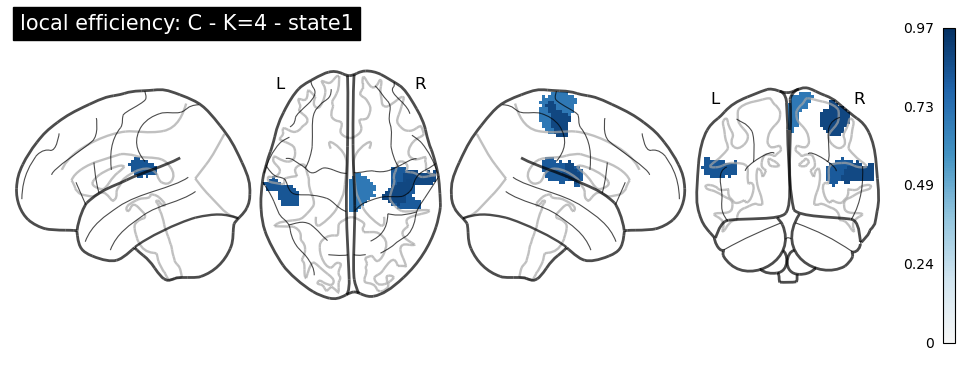

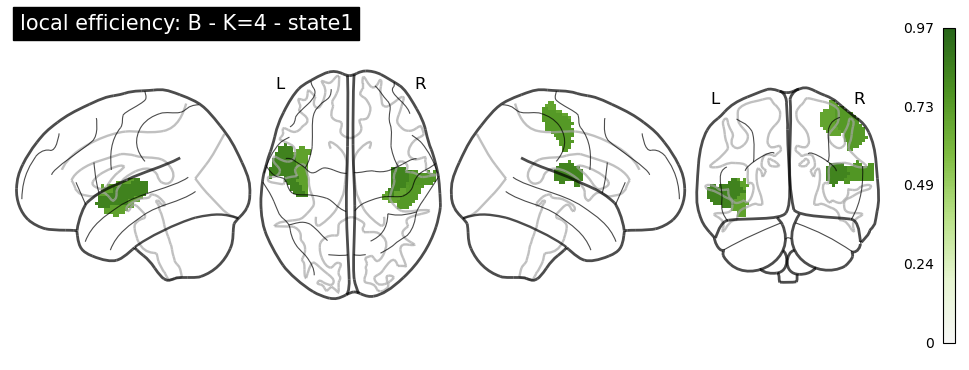

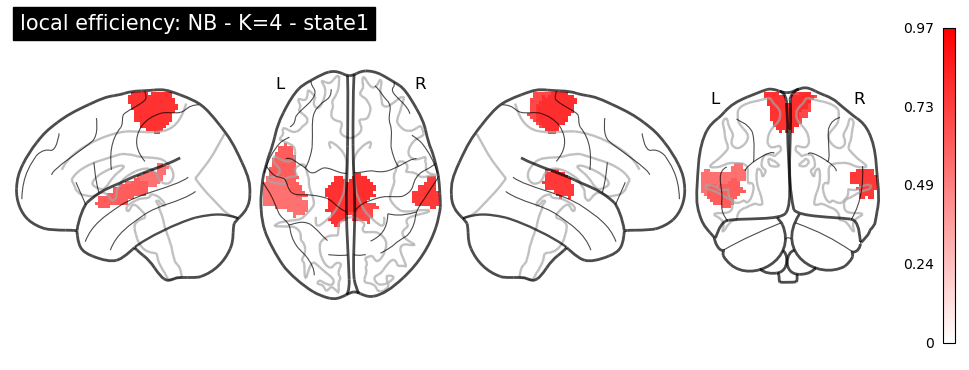

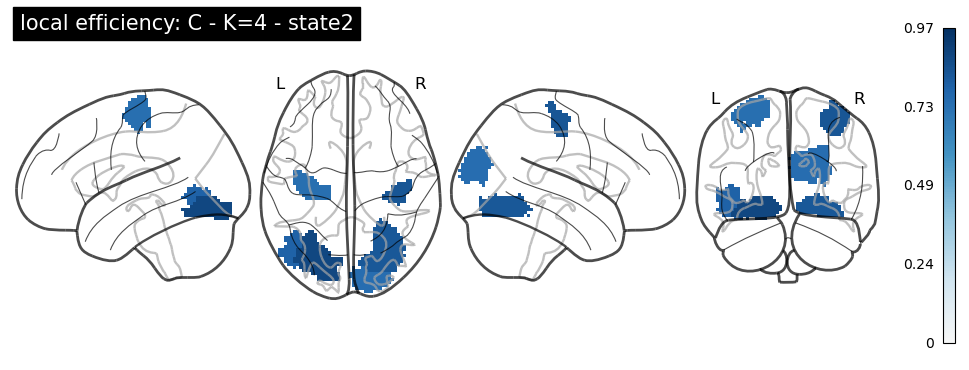

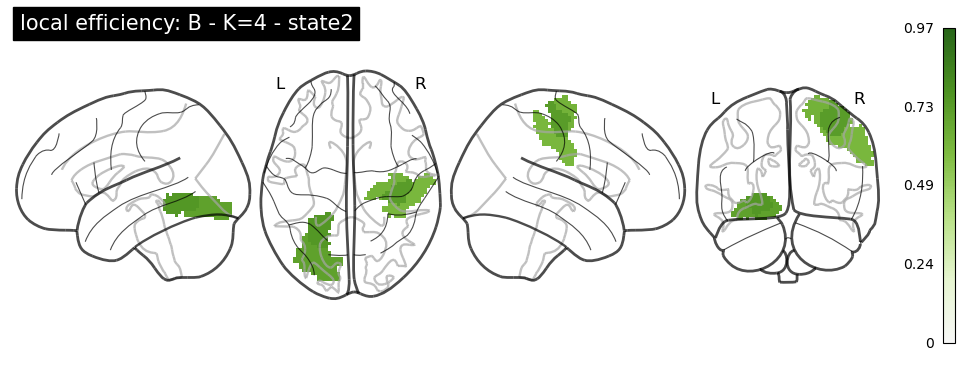

...

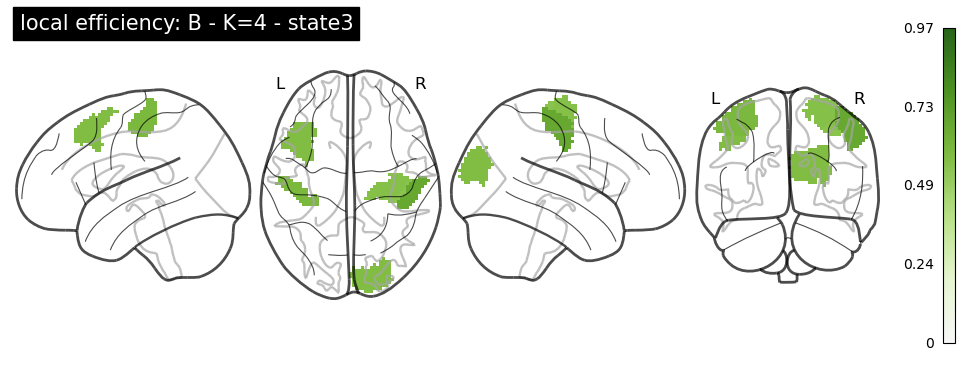

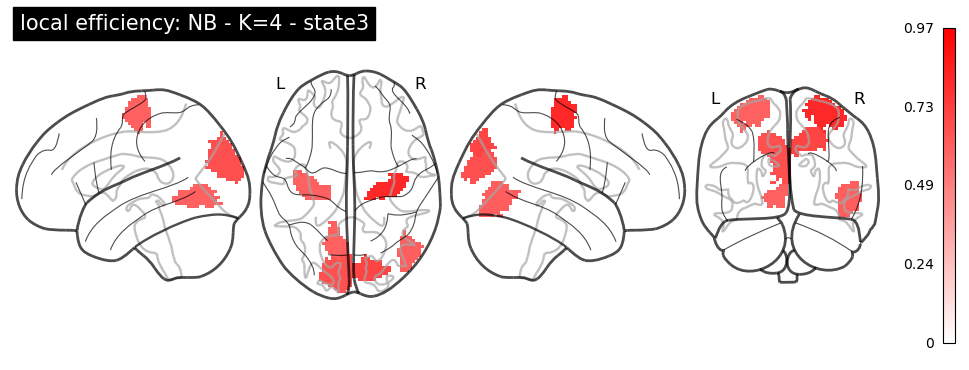

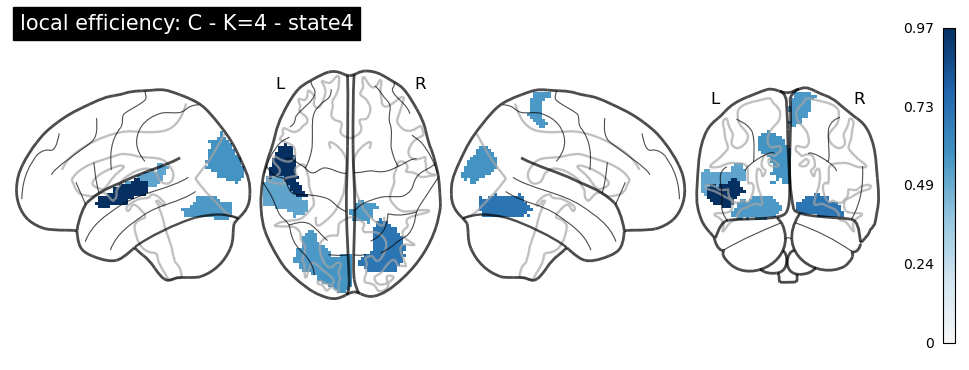

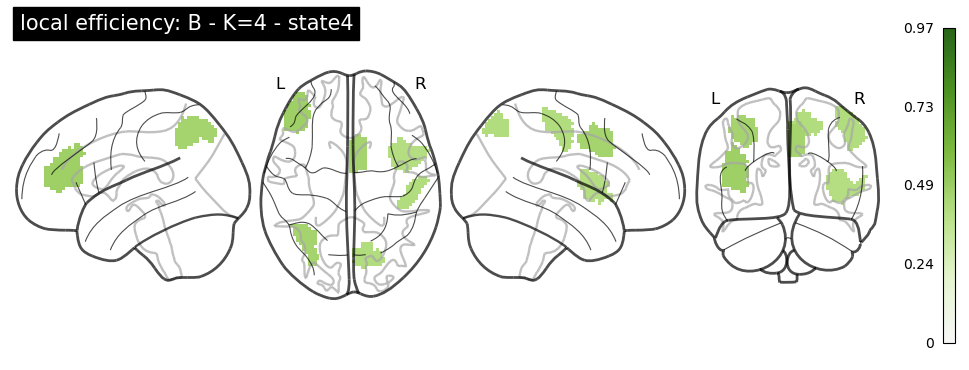

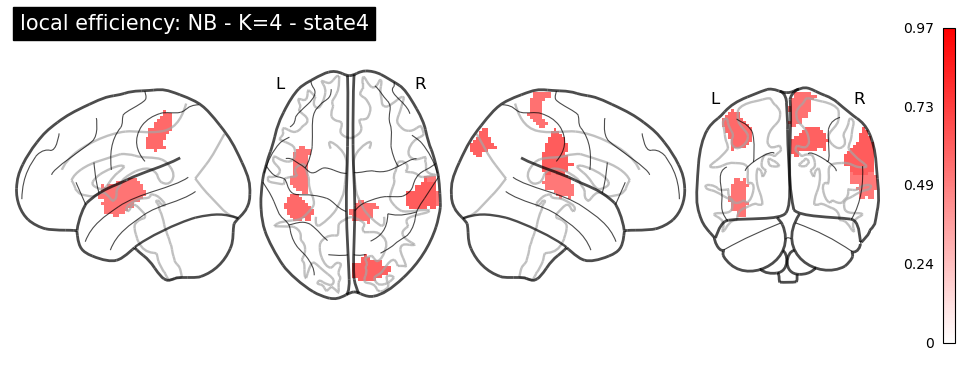

In [96]:
### PLOT ONLY THE FIRST 6 AREAS (WITH RESPECT TO THE LOCAL EFFICIENCY) ###

# PLOT LOCAL EFFICIENCY AND BETWEENESS OVER THE BRAIN - CERVELLINI
K = 4
for s in range(4): # Loop over states
    fig = plt.figure()
    # ax.set_title('state {}'.format(s+1))
    m__ = np.mean(metrics, axis=2)
    for g in range(3):
        m = np.mean(metrics[s][g], axis=0) # Local Eff/Betweeness centr for each node
        le_rank = np.argsort(m)[::-1]
        empty_brain = np.full(atlas.shape, np.nan)
        for a_idx in le_rank[:6]: # Loop over the areas
            m_a = m[a_idx]
            cord = np.where(atlas==a_idx+1)
            empty_brain[cord[0], cord[1], cord[2]] = m_a
        nii_brain = nib.Nifti1Image(empty_brain, affine=atlas_affine)
        plotting.plot_glass_brain(nii_brain, display_mode='lzry', cmap=cmaps[g], colorbar=True,
                                  vmin=0, vmax=m__.max(), symmetric_cbar=False, plot_abs=True,
                                  # symmetric_cbar=False, plot_abs=True,
                                  title=metriche_label[piero-1]+': '+labels[g]+' - K='+str(K)+' - state'+str(s+1))
    
        fig.tight_layout()
        plt.close(fig)
        plt.savefig('output/MD_05122023/K'+str(K)+'/Brain_'+labels[g]+' '+metrica+'_npick'+ \
                    str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                    dpi=200)
        # nib.save(nii_brain, 
        #          'output/MD_05122023/K'+str(K)+'/Brain_'+labels[g]+' '+metrica+'_npick'+ \
        #             str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.nii.gz')

In [101]:
# SEABORN BARPLOT # AREAS RANK - VERSION 3 -- DEFINITIVO
my_col = ['blue', 'green', 'red']
state_order = [s for s in range(1,K+1)]
groups_order = ['C', 'B', 'NB']
comparison = True

n = 6 # How many areas I want to show
# I want one color for macro area
## START COLOR STUFF ##

# Divide areas for macro areas
mas = np.unique(atlas_labels['super network'].values)
areas = atlas_labels['area'].values
networks = atlas_labels['network'].values
hemi = atlas_labels['hemisphere'].values

# mas_dic_count = [len(mas_dic[k]) for k in mas_dic.keys()]

cmap = plt.cm.jet  # define the colormap
cmaplist = [cmap(i) for i in range(cmap.N)]
# force the first color entry to be grey
cmaplist[0] = (.5, .5, .5, 1.0)
# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
       'Custom cmap', cmaplist, cmap.N)
# define the bins and normalize
bounds = np.linspace(0, len(mas_dic)-1, len(mas_dic))
norm = mpl.colors.BoundaryNorm(list(mas_dic.values()), cmap.N)

states_mas_color = []
mas_color = []
for k_i,k in enumerate(mas_dic.keys()):
    i_ = 0
    mas_color.append(cmap(k_i/len(mas_list)))
    for _ in mas_list[k]:
        states_mas_color.append(cmap(k_i/len(mas_list)))
        i_ += 1
## END COLOR STUFF ##     

df_metrics = []
ranks = []
for i in range(4): # states - ONE DATAFRAME FOR EACH STATE
    df_metrics_ = []
    ranks_ = []
    for j in range(3): # groups
        mmm = []
        ggg = []
        are = []
        rank = np.argsort(np.mean(metrics[i][j],axis=0))[::-1][:n] # area ranking based on the given metrics
        rankpp = np.sort(np.mean(metrics[i][j],axis=0))[::-1][:n]
        ranks_.append(rank)
        for jj in range(3): # groups
            for r in rank:
                lunghez = len(metrics[i][jj][:,r])

                mmm += metrics[i][jj][:,r].tolist() # metrics values
                ggg += [groups_order[jj]]*lunghez # group label
                are += [r]*lunghez # area
        # 'state' is node
        df_metrics_.append(pd.DataFrame(data = {metriche_label[piero-1]: mmm, 'groups': ggg, 'state':are}))
    ranks.append(ranks_)
    df_metrics.append(df_metrics_)


my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
#     annot_test =  'Brunner-Munze'
annot_test = 't-test_ind'

maps_states = []
for i in range(4): # states - ONE DATAFRAME FOR EACH STATE
    fig,axs = plt.subplots(1,3, figsize=(16,5))
    my_sup = plt.suptitle(metriche_label[piero-1]+' - state '+ str(i+1))
    
    maps_groups = []
    for j in range(3): # groups
        axs[j].set_title(groups_order[j], fontsize=18)
        pairs = [[(s,'C'),(s,'B')] for s in ranks[i][j]] + \
                 [[(s,'C'),(s,'NB')] for s in ranks[i][j]] + \
                 [[(s,'B'),(s,'NB')] for s in ranks[i][j]]

        hue_plot_params = {
            'data': df_metrics[i][j],
            'x': 'state',
            'y': metriche_label[piero-1],
            "order": ranks[i][j],
            "hue": 'groups',
#             "hue_order": groups_order,
            "palette": my_pal,
        }

        with sns.plotting_context("notebook", font_scale = 1.2):
            # Create new plot
        #     ax = get_log_ax()

            # Plot with seaborn
            sns.barplot(ax=axs[j],
                        **hue_plot_params)

            # Label and show
            axs[j].legend_.remove()
            plt.legend([], [], frameon=False)
            axs[j].set_xticklabels(hemi[ranks[i][j]]+'-'+networks[ranks[i][j]],rotation=45, fontsize=12)
            axs[j].set_xlabel('')
            
            
            
            pvalues = conf_int_pval(pairs, metriche_label[piero-1], df_metrics[i][j])
            # Add annotations
            annotator = Annotator(axs[j], pairs, **hue_plot_params)
            annotator.set_pvalues(pvalues)
            annotator.annotate()
        

    plt.tight_layout()    
    # plt.close(fig)
    plt.savefig('output/MD_05122023/K'+str(K)+'/NODERANK_'+metrica+'Rank_state'+str(i+1)+'_npick'+ \
                str(n_pick)+'_nsamp75minclust_K'+str(K)+'state'+str(s+1)+'.png',
                dpi=200, bbox_extra_artists=[my_sup])

AxisError: axis -1 is out of bounds for array of dimension 0




# STATE TRANSITIONS - Evaluate transition probability between states

In [26]:
import matplotlib
from itertools import combinations
import tqdm


In [27]:
# pip install seaborn==0.13.1

In [28]:
import seaborn as sns
sns.__version__

'0.11.2'

(14223,) 4.0
(6346,) (2991,) (2975,)
4
[[0.12961768 0.57696591 0.24348925 0.73363181]
 [0.95525942 0.25082351 0.93032859 0.0394693 ]
 [0.95439135 0.07798173 0.63902606 0.34628599]
 [0.9609754  0.89408733 0.64589679 0.93335912]]
[[-0.65299835  0.36169495  0.67520032  0.28089776]
 [ 0.23857677 -0.56550773  0.08053639  0.7773615 ]
 [ 0.26272695 -1.16899953 -0.1381322   0.47477793]
 [-0.33548103  0.35605746 -0.23168928 -0.22871634]]
[[0.71579356 0.61816305 0.88364068 0.27258327]
 [0.15483495 0.56441582 0.97902954 0.91932316]
 [0.73811274 0.68675821 0.15588818 0.41991429]
 [0.29673065 0.42804716 0.14272011 0.25554946]]
[[ 0.32048277 -0.36172897  0.16310689 -0.43007122]
 [ 0.58517912 -0.40017683 -0.01354941 -0.3425917 ]
 [ 0.31809544  0.12263025 -0.48387843  0.43127813]
 [-0.57455135  0.3545121  -0.76406757 -0.0677774 ]]
[[0.27430969 0.14994997 0.06178661 0.4202251 ]
 [0.17991249 0.49199779 0.96175916 0.19757207]
 [0.74285901 0.1096236  0.07465916 0.83961658]
 [0.69498626 0.73455492 0.320683

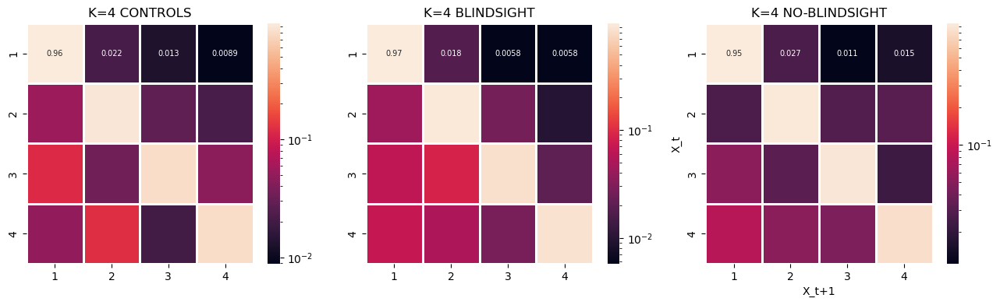

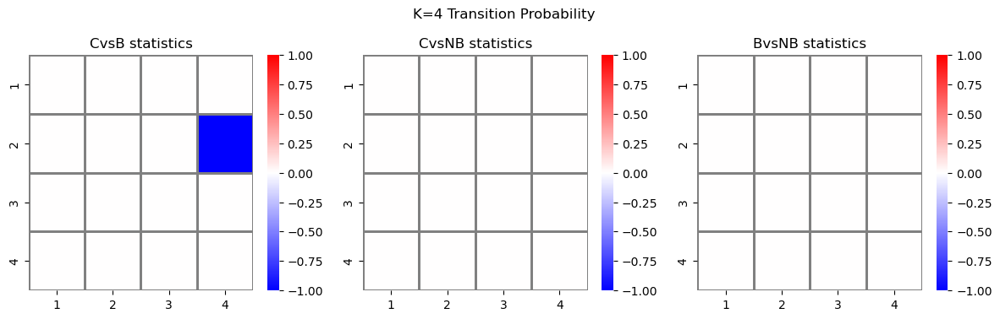

In [32]:
sub_idxs = [] # subject of each time point
for s in range(n_sub):
    sub_idxs += [s]*time_points
len(sub_idxs)
    
BASELINE = False # Consider or not the baseline as a state
baseline_fig_label = {True:'baseline', False:'NObaseline'}

prob_trans_list_allK = []
if BASELINE:
    ######################
    ## WITH BASELINE ##
    ######################
    for i,K in enumerate(range(2,10+1)): # Loop over K
        k = K - 2 # MD start to cluster from K=2
        # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
        state_labels = new_state_labels_sub_K[k]
        # print(state_labels.shape, state_labels.max())
        centroids = kmeans_leida[k]['C']
        # print(centroids.shape)
        
        
        # Divide states indexes by group
        groups_index = []
        for g in np.unique(group_labels):
            groups_index.append(np.where(group_labels==g)[0])
            
    
        # Define some stuff
        C_states = np.empty((0,))
        B_states = np.empty((0,))
        NB_states = np.empty((0,))
        
        for s,lab in zip(state_labels, group_labels):
            s = np.expand_dims(s, axis=0)
            if   lab==0: # C
                C_states = np.concatenate((C_states, s))
            elif lab==1: # B
                B_states = np.concatenate((B_states, s))
            else:        # NB
                NB_states = np.concatenate((NB_states, s))
                
        print(C_states.shape, B_states.shape, NB_states.shape)
    
        # COUNT THE TRANSITION BETWEEN EACH COUPLE OF STATES
        # subject-by-subject
        C = int(np.sum(group_labels==0)/time_points)
        B = int(np.sum(group_labels==1)/time_points)
        NB = int(np.sum(group_labels==2)/time_points)
        groups = [C_states, B_states, NB_states]
        groups_num = [C, B, NB]
    
    
        tot = []
        prob_trans_list = [] # I save all the prob transition matrices of each subject of each group in a list
        for g, g_num in zip(groups, groups_num):
            matrices = np.empty((0, K+1, K+1))
            # Loop over subjects
            to = 0
            for s in range(g_num): # Loop over subjects
                matrix = np.zeros((K+1, K+1))
                # count the number of transition within each possible couple of states
                prev = int(g[s*time_points])
                for t, tp in enumerate(g[(s*time_points)+1:(s+1)*time_points]): # Loop over the time points within the subject
                    tp = int(tp) 
        #             print(prev, tp)
                    matrix[prev, tp] += 1
                    if prev!=tp:
                        to += 1 # total number of transitions between different states
                    prev = tp
                tot.append(to)
                # matrix normalization to obtain probabilities
                for r,row in enumerate(matrix):
                    matrix[r] = matrix[r]/row.sum()
        #             matrix[r] = matrix[r]
                # Check nan values
                if np.isnan(matrix).any():
                    iid = np.where(np.isnan(matrix))
                    matrix[iid] = 0
                matrix = np.expand_dims(matrix, axis=0)
                matrices = np.concatenate((matrices, matrix))
        #         print(matrices.shape)
            prob_trans_list.append(matrices)
            
            
        state_names = [i for i in range(K+1)]
        groups_names = ['CONTROLS', 'BLINDSIGHT', 'NO-BLINDSIGHT']
        fig,axs = plt.subplots(1,3, figsize=(13,4))
        for i,ax in enumerate(axs.flat):
            ax.set_title('K='+str(K)+' '+groups_names[i])
        #     sns.heatmap(np.log(prob_trans_list[i].mean(axis=0)), linewidth=0.8, xticklabels=state_names, yticklabels=state_names)
            sns.heatmap(prob_trans_list[i].mean(axis=0), linewidth=0.8,
                        xticklabels=state_names, yticklabels=state_names, annot=True, annot_kws={'fontsize':7}, ax=ax)
            plt.xlabel('X_t+1')
            plt.ylabel('X_t')

        plt.tight_layout(pad=1.0)
        # plt.savefig('output/MD_05122023/K'+str(K)+'/TransProb_K'+str(K)+'_'+baseline_fig_label[BASELINE]+'.png',
        #             dpi=200)
            
    
        # # WITH NO DIAG
        # fig,axs = plt.subplots(1,3, figsize=(10,2.5))
        # for i,ax in enumerate(axs.flat):
        #     mat = prob_trans_list[i].mean(axis=0)
        #     for idx in range(K+1):
        #         mat[idx,idx] = np.nan
        #     ax.set_title('K='+str(K)+' '+groups_names[i])
        # #     sns.heatmap(np.log(prob_trans_list[i].mean(axis=0)), linewidth=0.8, xticklabels=state_names, yticklabels=state_names)
        #     sns.heatmap(mat, linewidth=0.8,
        #                 xticklabels=state_names, yticklabels=state_names,
        #                 annot=True, ax=ax)
        #     plt.xlabel('X_t+1')
        #     plt.ylabel('X_t')
            
            # plt.savefig('output/GraphAnal/'+DATE+'/K'+str(K)+'/'+'ProbTransition_NoDiag_'+groups_names[i]+ \
            #             '_'+DATE+'.png',
            #             dpi=200)
            
        # break
        prob_trans_list_allK.append(prob_trans_list)

    # Statistica tra gruppi - WITH BASELINE
    
    pairs = [(0,1),(0,2),(1,2)]
    pairs_tit = ['CvsB', 'CvsNB', 'BvsNB']
    nnn = ['C','B','NB']
    annot_test = 't-test_ind'
    
    
    for i,K in enumerate(range(2,10+1)): # Loop over K
        prob_trans_list = prob_trans_list_allK[i]
    
        state_names = [i for i in range(K+1)]
        matrice_ps = []
        fig, axs = plt.subplots(1,3, figsize=(12,3.8))
        for p_i, p in enumerate(pairs):
            matrice_s = np.empty((K+1,K+1))
            matrice_p = np.empty((K+1,K+1))
            for i in range(K+1):
                for j in range(K+1):
                    matrice_s[i,j] = ttest_ind(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j])[0]
                    matrice_p[i,j] = ttest_ind(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j])[1]
            matrice_ps.append(matrice_p)
            
            my_sup = plt.suptitle('K='+str(K)+' Transition Probability')
            # display only significative values
            for i in range(K):
                for j in range(K):
                    if matrice_p[i][j]>=0.05:
                        matrice_s[i][j]=0
                        
            sns.heatmap(matrice_s, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='bwr', annot=True,
                        ax=axs[p_i], vmin=-1, vmax=1, annot_kws={'fontsize':7}, linecolor='grey')
            for t in axs[p_i].texts:
                if float(t.get_text())!=0:
                    t.set_text(t.get_text()) #if the value is greater than 0.4 then I set the text 
                else:
                    t.set_text("") # if not it sets an empty text
            axs[p_i].set_title(pairs_tit[p_i]+' statistics')
            
        #     sns.heatmap(matrice_p, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='Greens_r', annot=True,
        #                 ax=axs[1], vmax=0.05)
        #     axs[1].set_title('p-values')
            
        fig.tight_layout(pad=1.0)
        # plt.savefig('output/MD_05122023/K'+str(K)+'/TranProb_statistics_K'+str(K)+'_'+baseline_fig_label[BASELINE]+'.png',
        #             dpi=200, bbox_extra_artists=[my_sup])
            
        # for i in range(3):
        #     reject, pvals_corr = pg.multicomp(matrice_ps[i], method='fdr_bh')
        #     print(reject)

elif not BASELINE:
    ######################
    ## WITH NO BASELINE ##
    ######################
    for i,K in enumerate(range(2,10+1)): # Loop over K
        prob_trans_list = [] # I save all the prob transition matrices of each subject of each group in a list
        if K ==4:
            k = K - 2 # MD start to cluster from K=2
            # Keys: IDX: state index for each time point, C: centroids coordinates, SUMD: buh, D: buh
            state_labels = new_state_labels_sub_K[k]
            print(state_labels.shape, state_labels.max())
            centroids = kmeans_leida[k]['C']
            # print(centroids.shape)
            
            # time points belonging to each state [state x time points]
            states_index = []
            for s in np.unique(state_labels)[1:]: # Remove the baseline state !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
                states_index.append(np.where(state_labels==s))
            # print(len(states_index))
            
            # Divide states indexes by group
            groups_index = []
            for g in np.unique(group_labels):
                groups_index.append(np.where(group_labels==g)[0])
                
            states_index_groups = [] # [state 1, state2, state 3]
            for s in states_index:
                groupz = {0:[], 1:[], 2:[]}
                for t in s[0]:
                    groupz[group_labels[t][0]].append(t)
                states_index_groups.append(groupz)
        
            # Define some stuff
            C_states = np.empty((0,))
            B_states = np.empty((0,))
            NB_states = np.empty((0,))
        
            C_subs = []
            B_subs = []
            NB_subs = []
        
            count = 0
            for s,lab in zip(state_labels, group_labels):
                if s!=0: # Ignore the baseline state
                    s = np.expand_dims(s, axis=0)
                    if   lab==0: # C
                        C_states = np.concatenate((C_states, s))
                        C_subs += [sub_idxs[count]]
                    elif lab==1: # B
                        B_states = np.concatenate((B_states, s))
                        B_subs += [sub_idxs[count]]
                    else:        # NB
                        NB_states = np.concatenate((NB_states, s))
                        NB_subs += [sub_idxs[count]]
                count += 1
                
            
            print(C_states.shape, B_states.shape, NB_states.shape)
        
            # COUNT THE TRANSITION BETWEEN EACH COUPLE OF STATES
            # subject-by-subject
            groups = [C_states, B_states, NB_states]
            groups_subs_idx = [C_subs, B_subs, NB_subs]
        
        
            tot = []
            for g, g_subs in zip(groups, groups_subs_idx):
                matrices = np.empty((0, K, K))
                # Loop over subjects
                to = 0
                for s in np.unique(g_subs): # Loop over subject
                    matrix = np.zeros((K, K))
                    # count the number of transition between each possible couple of states (no baseline state)
                    cacco = g[np.where(g_subs==s)] # all the time points belonging to the current subject
                    prev = int(cacco[0]) - 1 # The state state of the first time point
                    for t, tp in enumerate(cacco[1:]):
                        tp = int(tp) - 1 
                        matrix[prev, tp] += 1
                        if prev!=tp:
                            to += 1 # total number of transitions between different states
                        prev = tp
                    tot.append(to)
                    # matrix normalization to obtain probabilities
                    for r,row in enumerate(matrix):
                        matrix[r] = matrix[r]/row.sum()
            #             matrix[r] = matrix[r]
                    # Check nan values
                    if np.isnan(matrix).any():
                        iid = np.where(np.isnan(matrix))
                        matrix[iid] = 0
                    matrix = np.expand_dims(matrix, axis=0)
                    matrices = np.concatenate((matrices, matrix))
            #         print(matrices.shape)
                prob_trans_list.append(matrices)
                
                
            state_names = [i+1 for i in range(K)]
            groups_names = ['CONTROLS', 'BLINDSIGHT', 'NO-BLINDSIGHT']
            fig,axs = plt.subplots(1,3, figsize=(13,4))
            for i,ax in enumerate(axs.flat):
                ax.set_title('K='+str(K)+' '+groups_names[i])
            #     sns.heatmap(np.log(prob_trans_list[i].mean(axis=0)), linewidth=0.8, xticklabels=state_names, yticklabels=state_names)
                sns.heatmap(prob_trans_list[i].mean(axis=0), linewidth=0.8,
                            xticklabels=state_names, yticklabels=state_names, annot=True, annot_kws={'fontsize':7}, ax=ax,
                            norm=matplotlib.colors.LogNorm())
                plt.xlabel('X_t+1')
                plt.ylabel('X_t')
    
            plt.tight_layout(pad=1.0)
                
            plt.savefig('output/AB_15052024/K'+str(K)+'/TransProb_K'+str(K)+'_'+baseline_fig_label[BASELINE]+'.png',
                        dpi=200)
        
            # # WITH NO DIAG
            # fig,axs = plt.subplots(1,3, figsize=(10,2.5))
            # for i,ax in enumerate(axs.flat):
            #     mat = prob_trans_list[i].mean(axis=0)
            #     for idx in range(K):
            #         mat[idx,idx] = np.nan
            #     ax.set_title('K='+str(K)+' '+groups_names[i])
            # #     sns.heatmap(np.log(prob_trans_list[i].mean(axis=0)), linewidth=0.8, xticklabels=state_names, yticklabels=state_names)
            #     sns.heatmap(mat, linewidth=0.8,
            #                 xticklabels=state_names, yticklabels=state_names,
            #                 annot=True, ax=ax)
            #     plt.xlabel('X_t+1')
            #     plt.ylabel('X_t')
                
                # plt.savefig('output/GraphAnal/'+DATE+'/K'+str(K)+'/'+'ProbTransition_NoDiag_'+groups_names[i]+ \
                #             '_'+DATE+'.png',
                #             dpi=200)
                
        prob_trans_list_allK.append(prob_trans_list)
    
    # Statistica tra gruppi
    
    pairs = [(0,1),(0,2),(1,2)]
    pairs_tit = ['CvsB', 'CvsNB', 'BvsNB']
    # pairs = [(1,2)]
    # pairs_tit = ['BvsNB']
    nnn = ['C','B','NB']
    annot_test = 't-test_ind'
    
    
    for i,K in enumerate(range(2,10+1)): # Loop over K
        if K==4:
            prob_trans_list = prob_trans_list_allK[i]
            state_names = [i+1 for i in range(K)]
            matrice_ps = []
            matrice_ss = []
            fig, axs = plt.subplots(1,3, figsize=(12,3.8))
            print(K)
            for p_i, p in enumerate(pairs):
                matrice_s = np.empty((K,K))
                matrice_p = np.empty((K,K))
                matrice_eff = np.empty((K,K))
                for i in range(K):
                    for j in range(K):
                        # matrice_s[i,j] = ttest_ind(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j])[0]
                        # matrice_p[i,j] = ttest_ind(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j])[1]
                        matrice_eff[i,j] = pg.compute_effsize(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j],paired=False, eftype='cohen')
                        matrice_s[i,j] = scipy.stats.brunnermunzel(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j])[0]
                        matrice_p[i,j] = scipy.stats.brunnermunzel(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j])[1]
                        # Generate all possible permutations
                        all_permutations = list(combinations(range(16), 8))
                        n_permutations = len(all_permutations)
                        count = 0
                        combined = np.concatenate([prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j]])
                        # Permutation test
                        # for perm in tqdm.tqdm(all_permutations):
                        #     permuted_group1 = combined[list(perm)]
                        #     permuted_group2 = combined[list(set(range(16)) - set(perm))]
                        #     _stat, _ = scipy.stats.brunnermunzel(permuted_group1, permuted_group2)
                            
                        #     if np.abs(_stat) >= np.abs(matrice_s[i,j]):
                        #         count += 1
    
                        # # Calculate the p-value
                        # matrice_p[i,j] = count / n_permutations

                        # Boostrapped version
                        # b_dis_0 = bootstrap((prob_trans_list[p[0]][:,i,j],), np.std, n_resamples=10000).bootstrap_distribution
                        # b_dis_1 = bootstrap((prob_trans_list[p[1]][:,i,j],), np.std, n_resamples=10000).bootstrap_distribution
                        # matrice_s[i,j], matrice_p[i,j] = conf_int_pval_pair(b_dis_0,b_dis_1, conf_level=97.5)
                print(matrice_p)
                            
                matrice_ps.append(matrice_p)
                matrice_ss.append(matrice_s)
                
                my_sup = plt.suptitle('K='+str(K)+' Transition Probability')
                # display only significative values
                for i in range(K):
                    for j in range(K):
                        if matrice_p[i][j]>0.05:
                            matrice_s[i][j]=0
                            
                sns.heatmap(matrice_s, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='bwr', annot=True,
                            ax=axs[p_i], vmin=-1, vmax=1, annot_kws={'fontsize':7}, linecolor='grey')
                for t in axs[p_i].texts:
                    if float(t.get_text())!=0:
                        t.set_text(t.get_text()) #if the value is greater than 0.4 then I set the text 
                    else:
                        t.set_text("") # if not it sets an empty text
                axs[p_i].set_title(pairs_tit[p_i]+' statistics')
                # print(matrice_p)
                print(matrice_eff)
                
            #     sns.heatmap(matrice_p, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='Greens_r', annot=True,
            #                 ax=axs[1], vmax=0.05)
            #     axs[1].set_title('p-values')
                
            fig.tight_layout(pad=1.0)
            # plt.savefig('output/AB_15052024/K'+str(K)+'/TransProb_statistics_K'+str(K)+'_'+baseline_fig_label[BASELINE]+'.png',
            #             dpi=200, bbox_extra_artists=[my_sup])
                
        # for i in range(3):
        #     reject, pvals_corr = pg.multicomp(matrice_ps[i], method='fdr_bh')
        #     print(reject)

## Groups comparison with a null model

In [41]:
# # Statistica tra gruppi - with null model

# pairs = [(0,1),(0,2),(1,2)]
# pairs_tit = ['CvsB', 'CvsNB', 'BvsNB']
# nnn = ['C','B','NB']
# annot_test = 't-test_ind'
# n_rep = 500

# for i,K in enumerate(range(2,10+1)): # Loop over K
#     prob_trans_list = prob_trans_list_allK[i]
    
#     state_names = [i+1 for i in range(K)]
#     matrice_ps = []
    
#     fig, axs = plt.subplots(1,3, figsize=(9.5,3), gridspec_kw={'width_ratios': [1,1,1]})
#     # Compute null model for each group comparison
#     matrice_ps = []
#     for p_i, p in enumerate(pairs):
#         s_1 = prob_trans_list[p[0]].shape[0] # size of the first group
#         # Concatenate the matrices of the two groups in order two shuffle
#         prob_trans_all = np.concatenate((prob_trans_list[p[0]], prob_trans_list[p[1]])) 
#         # print(prob_trans_all.shape)
#         # Chose random indexes for the two groups
#         n = prob_trans_all.shape[0]
#         matrice_ss = []
#         for _ in range(n_rep):
#             indexes = random.sample([i for i in range(n)], s_1)
#             not_indexes = [i for i in range(n) if i not in indexes]
#             # print(len(indexes), len(not_indexes))
#             matrice_s = np.empty((K,K))
#             for i in range(K):
#                 for j in range(K):
#                     matrice_s[i,j] = ttest_ind(prob_trans_all[indexes,i,j], prob_trans_all[not_indexes,i,j])[0]
#             matrice_ss.append(np.max(matrice_s))
#         print(len(matrice_ss))
        
#         # Compute real statistics
#         matrice_s = np.empty((K,K))
#         matrice_p = np.empty((K,K))
#         p_crit = np.percentile(matrice_ss, 99)
#         for i in range(K):
#             for j in range(K):
#                 matrice_s[i,j] = ttest_ind(prob_trans_list[p[0]][:,i,j], prob_trans_list[p[1]][:,i,j])[0]
#                 # matrice_p[i,j] = p_val
#         matrice_ps.append(matrice_s)

#         my_sup = plt.suptitle('K='+str(K)+' Transition Probability - '+pairs_tit[p_i])
#         # display only significative values
#         for i in range(K):
#             for j in range(K):
#                 if matrice_s[i][j]<p_crit:
#                     matrice_s[i][j]=0
                    
#         sns.heatmap(matrice_s, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='bwr', annot=True,
#                     ax=axs[p_i], vmin=-1, vmax=1)
#         for t in axs[p_i].texts:
#             if float(t.get_text())!=0:
#                 t.set_text(t.get_text()) #if the value is greater than 0.4 then I set the text 
#             else:
#                 t.set_text("") # if not it sets an empty text
#         axs[p_i].set_title(pairs_tit[p_i]+' statistics')
        
#     #     sns.heatmap(matrice_p, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='Greens_r', annot=True,
#     #                 ax=axs[1], vmax=0.05)
#     #     axs[1].set_title('p-values')
        
#         fig.tight_layout(pad=1.0)

    

### Entropy production rate

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

C vs. B: Brunner-Munzel test, P_val:7.651e-01 W=-3.028e-01
B vs. NB: Brunner-Munzel test, P_val:7.774e-01 W=2.898e-01
C vs. NB: Brunner-Munzel test, P_val:9.600e-01 W=5.133e-02
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

C vs. B: Brunner-Munzel test, P_val:9.591e-01 W=-5.246e-02
B vs. NB: Brunner-Munzel test, P_val:4.290e-01 W=-8.165e-01
C vs. NB: Brunner-Munzel test, P_val:2.478e-01 W=-1.192e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

C vs. B: Brunner-Munzel test, P_val:9.567e-01 W=-5.519e-02
B vs. NB: Brunner-Munzel test, P_val:9.236

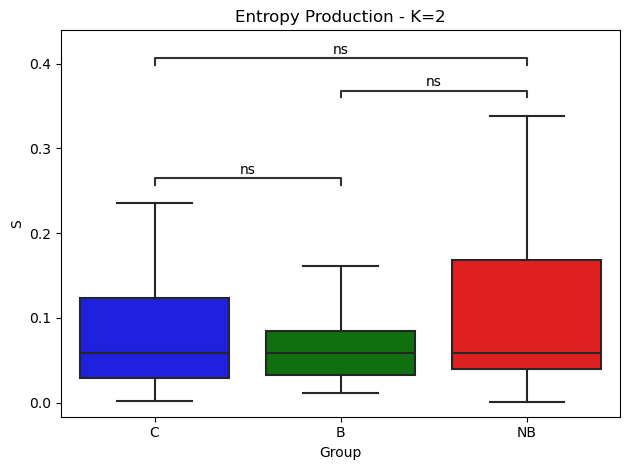

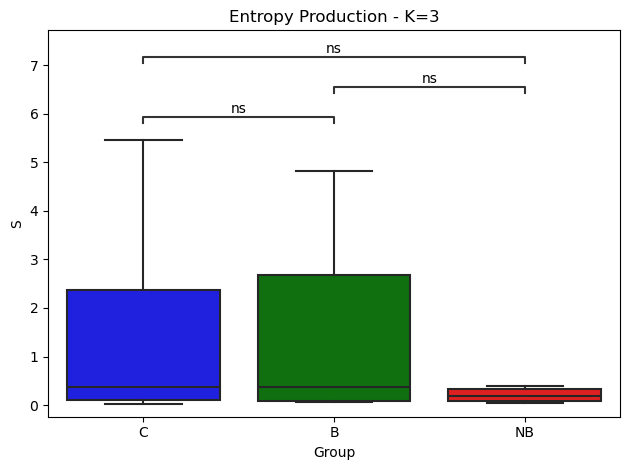

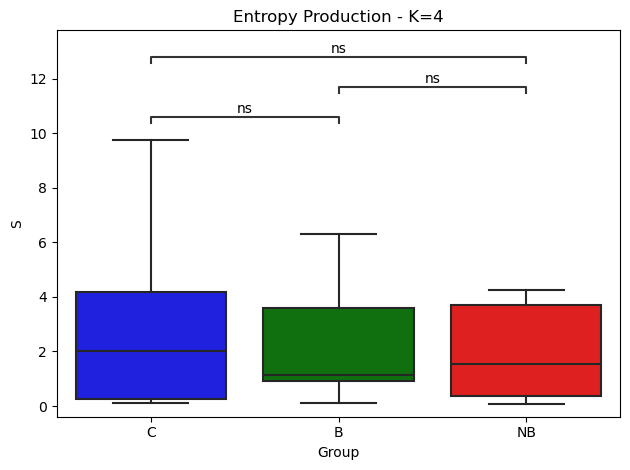

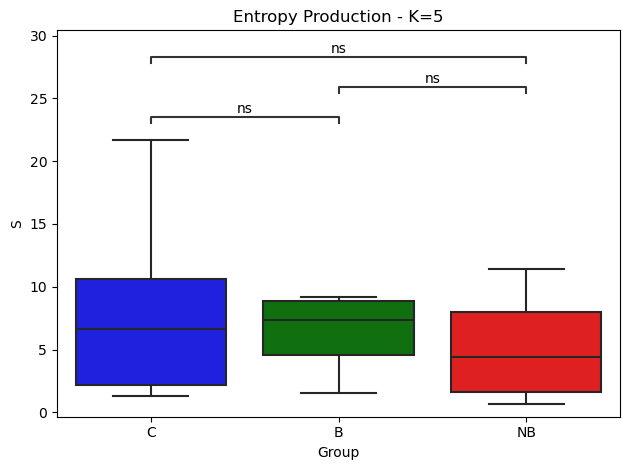

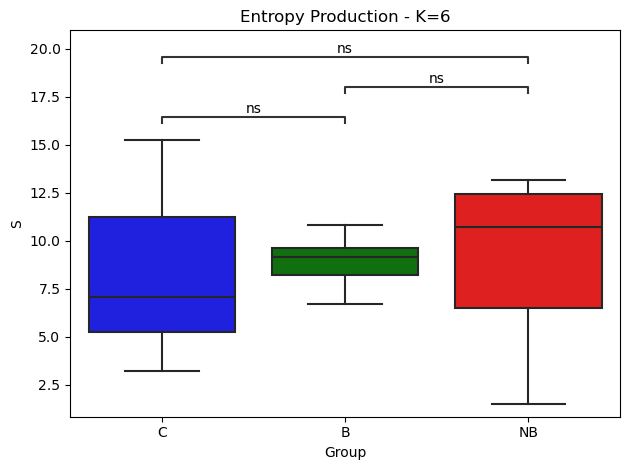

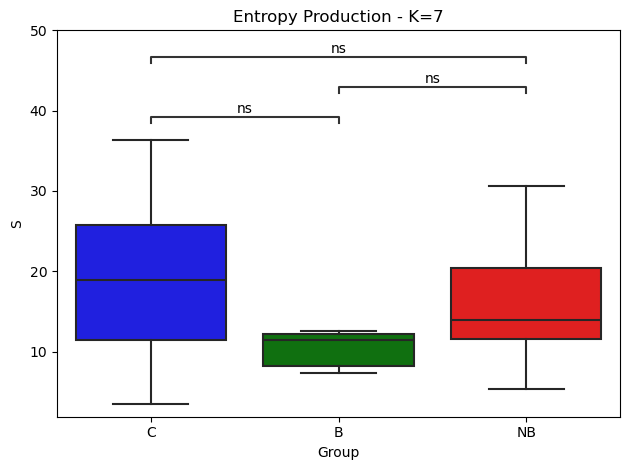

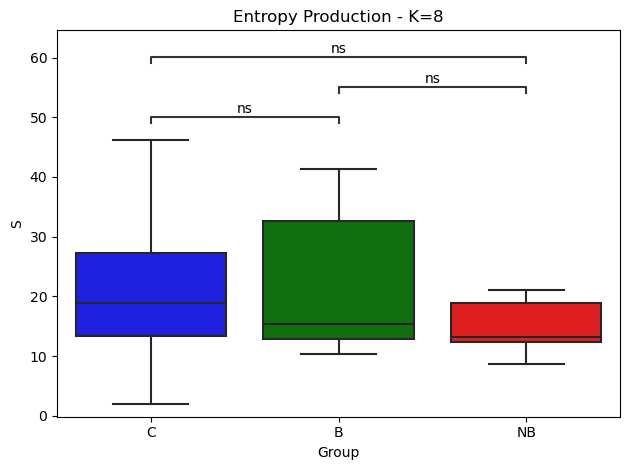

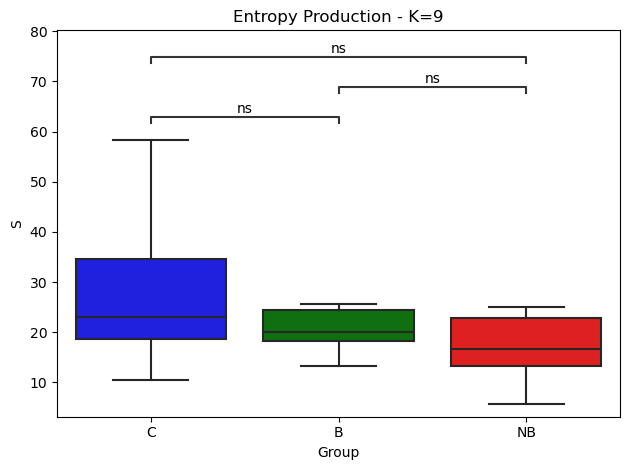

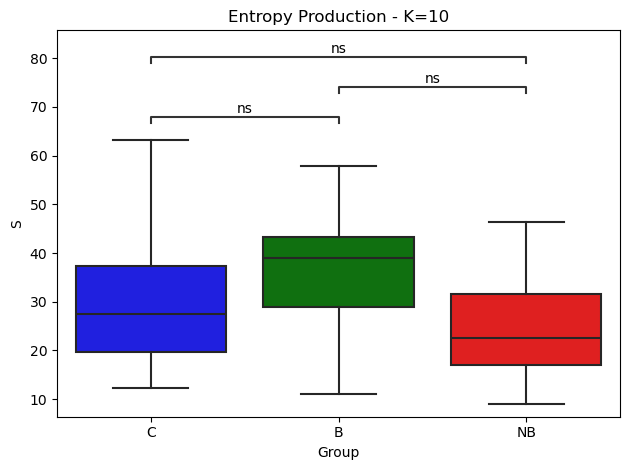

In [36]:
# COMPUTE ENTROPY PRODUCTION RATE

# today = date.today()
# DATE = today.strftime("%d%m%Y")
# # checking if the directory exists or not
# if not os.path.exists('output/GraphAnal/'+DATE+'/K'+str(K)):
      
#     # if the demo_folder directory is not present 
#     # then create it.
#     os.makedirs('output/GraphAnal/'+DATE+'/K'+str(K))


#############
## FORWARD ##
#############

for i,K in enumerate(range(2,10+1)): # Loop over K
    prob_trans_list = prob_trans_list_allK[i]

    # Controls , Blindsight, No-blindsight
    eps = 0.00000000001
    Ss_for = []
    for ms in prob_trans_list:
        S = []
        for m in ms:
            m = m+eps
            s = 0
            for i in range(m.shape[0]):
                for j in range(m.shape[1]):
                    if i!=j: # Remove loop transition when compute transition probability
                        s_ = m[i,j]*np.log(m[i,j]/m[j,i])
                        s += s_
    #         print(s)
            S.append(s)
        Ss_for.append(S)
        
        
    ## METTERE TUTTO IN UN MINCHIA DI DATAFRAME    
    datacane = pd.DataFrame({'S':Ss_for[0]+Ss_for[1]+Ss_for[2],
                             'Group':['C']*len(Ss_for[0])+['B']*len(Ss_for[1])+['NB']*len(Ss_for[2])})

    my_pal = {'C':'blue', 'B':'g', 'NB':'r'}
    hue_plot_params = {
        'data': datacane,
        'x': 'Group',
        'y': 'S',
        "palette": my_pal,
    }
        
    fig, ax = plt.subplots(1,1)
    plt.title('Entropy Production - K='+str(K))
    bp = sns.boxplot(ax=ax, **hue_plot_params, showfliers=False)
    
    # Add annotations
    pairs= [('C','B'), ('C','NB'), ('B','NB')]
    annotator = Annotator(ax, pairs, **hue_plot_params)
    annamobbene = annotator.configure(test=annot_test).apply_and_annotate()
    plt.tight_layout()
    plt.savefig('output/MD_05122023/K'+str(K)+'/'+'Entropy_prod_rate_K'+str(K)+'.png',
                dpi=200)
    
    # ##############
    # ## BACKWARD ##
    # ##############
    
    # # Controls , Blindsight, No-blindsight
    # eps = 0.00000000001
    # Ss_back = []
    # for ms in prob_trans_list_back:
    #     S = []
    #     for m in ms:
    #         m = m+eps
    #         s = 0
    #         for i in range(m.shape[0]):
    #             for j in range(m.shape[1]):
    #                 if i!=j: # Remove loop transition when compute transition probability
    #                     s_ = m[i,j]*np.log(m[i,j]/m[j,i])
    #                     s += s_
    # #         print(s)
    #         S.append(s)
    #     Ss_back.append(S)
        
    # fig = plt.figure()
    # plt.title('Entropy Production - Backward')
    # bp = plt.boxplot(Ss_back,
    #                  patch_artist=True,
    #                  labels=['C', 'B', 'NB'],
    #                  showfliers=False)
    # bp['boxes'][0].set_facecolor('blue')
    # bp['boxes'][1].set_facecolor('green')
    # bp['boxes'][2].set_facecolor('red')
    
    # # t-tests 
    # print(ttest_ind(Ss_back[0], Ss_back[1]))
    # print(ttest_ind(Ss_back[0], Ss_back[2]))
    # print(ttest_ind(Ss_back[1], Ss_back[2]))
    # print('\n')
        
    # plt.legend([bp["boxes"][0], bp["boxes"][1], bp["boxes"][2]], 
    #            ['Controls','Blindsight','No-Blindsight'], 
    #            loc='upper right')
    
    
    # # Subject-wise different between entropy productions
    # #Loop over groups
    # Ss_diff = []
    # for i in range(len(Ss_for)):
    #     group = []
    #     for f,b in zip(Ss_for[i],Ss_back[i]):
    #         group.append(np.abs(f-b))
    #     Ss_diff.append(group)
    
    # fig = plt.figure()
    # plt.title('Irreversibility rate')
    # bp = plt.boxplot(Ss_diff,
    #                  patch_artist=True,
    #                  labels=['C', 'B', 'NB'])
    # bp['boxes'][0].set_facecolor('blue')
    # bp['boxes'][1].set_facecolor('green')
    # bp['boxes'][2].set_facecolor('red')
    
    # # t-tests 
    # print(ttest_ind(Ss_diff[0], Ss_diff[1]))
    # print(ttest_ind(Ss_diff[0], Ss_diff[2]))
    # print(ttest_ind(Ss_diff[1], Ss_diff[2]))
    # print('\n')
        
    # plt.legend([bp["boxes"][0], bp["boxes"][1], bp["boxes"][2]], 
    #            ['Controls','Blindsight','No-Blindsight'], 
    #            loc='upper right')
    # break

# Correlation with behavioral data (with covariates)

In [33]:
import pingouin as pg
from pingouin.effsize import compute_esci
from pingouin.utils import remove_na, _perm_pval, _postprocess_dataframe
from pingouin.bayesian import bayesfactor_pearson

def _correl_pvalue(r, n, k=0, alternative="two-sided"):
    """Compute the p-value of a correlation coefficient.

    https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.pearsonr.html
    https://en.wikipedia.org/wiki/Pearson_correlation_coefficient#Using_the_exact_distribution

    See also scipy.stats._ttest_finish

    Parameters
    ----------
    r : float
        Correlation coefficient.
    n : int
        Sample size
    k : int
        Number of covariates for (semi)-partial correlation.
    alternative : string
        Tail of the test.

    Returns
    -------
    pval : float
        p-value.

    Notes
    -----
    This uses the same approach as :py:func:`scipy.stats.pearsonr` to calculate
    the p-value (i.e. using a beta distribution)
    """
    from scipy.stats import t

    assert alternative in [
        "two-sided",
        "greater",
        "less",
    ], "Alternative must be one of 'two-sided' (default), 'greater' or 'less'."

    # Method 1: using a student T distribution
    dof = n - k - 2
    tval = r * np.sqrt(dof / (1 - r**2))
    if alternative == "less":
        pval = t.cdf(tval, dof)
    elif alternative == "greater":
        pval = t.sf(tval, dof)
    elif alternative == "two-sided":
        pval = 2 * t.sf(np.abs(tval), dof)

    # Method 2: beta distribution (similar to scipy.stats.pearsonr, faster)
    # from scipy.special import btdtr
    # ab = (n - k) / 2 - 1
    # pval = 2 * btdtr(ab, ab, 0.5 * (1 - abs(np.float64(r))))
    return pval

In [34]:
def partial_corr(
    data=None,
    x=None,
    y=None,
    covar=None,
    x_covar=None,
    y_covar=None,
    alternative="two-sided",
    method="pearson",
):

    from pingouin.utils import _flatten_list

    # Safety check
    assert alternative in [
        "two-sided",
        "greater",
        "less",
    ], "Alternative must be one of 'two-sided' (default), 'greater' or 'less'."
    assert method in [
        "pearson",
        "spearman",
    ], 'only "pearson" and "spearman" are supported for partial correlation.'
    assert isinstance(data, pd.DataFrame), "data must be a pandas DataFrame."
    assert data.shape[0] > 2, "Data must have at least 3 samples."
    if covar is not None and (x_covar is not None or y_covar is not None):
        raise ValueError("Cannot specify both covar and {x,y}_covar.")
    if x_covar is not None and y_covar is not None:
        raise ValueError("Cannot specify both x_covar and y_covar.")
    assert x != y, "x and y must be independent"
    if isinstance(covar, list):
        assert x not in covar, "x and covar must be independent"
        assert y not in covar, "y and covar must be independent"
    else:
        assert x != covar, "x and covar must be independent"
        assert y != covar, "y and covar must be independent"
    # Check that columns exist
    col = _flatten_list([x, y, covar])
    assert all([c in data for c in col]), "columns are not in dataframe."
    # Check that columns are numeric
    assert all([data[c].dtype.kind in "bfiu" for c in col])

    # Drop rows with NaN
    data = data[col].dropna()
    n = data.shape[0]  # Number of samples
    k = data.shape[1] - 2  # Number of covariates
    assert n > 2, "Data must have at least 3 non-NAN samples."

    # Calculate the partial corrrelation matrix - similar to pingouin.pcorr()
    if method == "spearman":
        # Convert the data to rank, similar to R cov()
        V = data.rank(na_option="keep").cov(numeric_only=True)
    else:
        V = data.cov(numeric_only=True)
    Vi = np.linalg.pinv(V, hermitian=True)  # Inverse covariance matrix
    Vi_diag = Vi.diagonal()
    D = np.diag(np.sqrt(1 / Vi_diag))
    pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix

    if covar is not None:
        r = pcor[0, 1]
    else:
        # Semi-partial correlation matrix
        with np.errstate(divide="ignore"):
            spcor = (
                pcor
                / np.sqrt(np.diag(V))[..., None]
                / np.sqrt(np.abs(Vi_diag - Vi**2 / Vi_diag[..., None])).T
            )
        if y_covar is not None:
            r = spcor[0, 1]  # y_covar is removed from y
        else:
            r = spcor[1, 0]  # x_covar is removed from x

    if np.isnan(r):
        # Correlation failed. Return NaN. When would this happen?
        return pd.DataFrame({"n": n, "r": np.nan, "CI95%": np.nan, "p-val": np.nan}, index=[method])

    # Compute the two-sided p-value and confidence intervals
    # https://online.stat.psu.edu/stat505/lesson/6/6.3
    pval = _correl_pvalue(r, n, k, alternative)
    ci = compute_esci(
        stat=r, nx=(n - k), ny=(n - k), eftype="r", decimals=6, alternative=alternative
    )

    # Create dictionnary
    stats = {
        "n": n,
        "r": r,
        "CI95%": [ci],
        "p-val": pval,
    }

    # Convert to DataFrame
    stats = pd.DataFrame(stats, index=[method])

    # Define order
    col_keep = ["n", "r", "CI95%", "p-val"]
    col_order = [k for k in col_keep if k in stats.keys().tolist()]
    return _postprocess_dataframe(stats)[col_order]


In [35]:
# Multiple dim partial correlation from scratch. 
# Ref: https://en.wikipedia.org/wiki/Partial_correlation ; https://datatab.net/tutorial/partial-correlation
from scipy.stats import zscore
from scipy.stats import norm # to compute p-value
from sklearn.utils import shuffle

def compute_res(var1, var2):
    var1 = sm.add_constant(var1)  # adding a constant
    model = sm.OLS(var1, var2).fit()
    # print(model.resid[:,1])
    return model.resid[:,1]

def one_dim_par_cor(X, Y, Z):
    e_X = compute_res(X, Z)
    e_Y = compute_res(Y, Z)
    return pearsonr(e_X, e_Y)[0]

def null_model_distrib(X, Y, Z1, Z2, n_rep):
    # just shuffle everything and compute a distribution of statistics
    r_xy_Z_dist = []
    for _ in range(n_rep):
        X_r = shuffle(np.copy(X))
        Y_r = shuffle(np.copy(Y))
        Z1_r = shuffle(np.copy(Z1))
        Z2_r = shuffle(np.copy(Z2))

        r_xy_z2 = one_dim_par_cor(X_r, Y_r, Z2_r)
        r_xz1_z2 = one_dim_par_cor(X_r, Z1_r, Z2_r)
        r_z1y_z2 = one_dim_par_cor(Z1_r, Y_r, Z2_r)

        r = (r_xy_z2 - r_xz1_z2*r_z1y_z2)/(np.sqrt(1-r_xz1_z2**2)*np.sqrt(1-r_z1y_z2**2))    
        r_xy_Z_dist.append( r )
    return r_xy_Z_dist
    

def two_dim_par_corr(X, Y, Z1, Z2):
    # print(X, Y, Z1, Z2)
    r_xy_z2 = one_dim_par_cor(X,Y,Z2)
    r_xz1_z2 = one_dim_par_cor(X,Z1,Z2)
    r_z1y_z2 = one_dim_par_cor(Z1,Y,Z2)

    r_xy_Z = (r_xy_z2 - r_xz1_z2*r_z1y_z2)/(np.sqrt(1-r_xz1_z2**2)*np.sqrt(1-r_z1y_z2**2))

    return r_xy_Z    

def two_dim_par_corr_fullstat(X, Y, Z1, Z2, n_rep):
    dist = null_model_distrib(X, Y, Z1, Z2, n_rep)
    # print(dist)
    stat = two_dim_par_corr(X, Y, Z1, Z2)
    dist = dist + [stat] 
    # print(dist)
    # print(zscore(dist))
    zs_stat = zscore(dist)[-1]
    p_val = norm.sf(abs(zs_stat))*2
    

    return zs_stat, p_val

# stats = []
# p_vals = []
# for _ in range(10):
#     res = two_dim_par_corr_fullstat(my_df['behav'].values, my_df['prob'].values, my_df['age'].values, my_df['tstroke'].values, 5000)
#     stats.append(res[0])
#     p_vals.append(res[1])

In [36]:
import statsmodels.api as sm

ahahha
STATE 4
(16, 4, 4)
[[ 0.355 -0.389 -0.472 -0.324]
 [ 0.276  0.263  0.19  -0.521]
 [-0.01   0.338 -0.29  -0.059]
 [-0.009  0.076 -0.227  0.044]]
[[0.194 0.152 0.076 0.239]
 [0.319 0.343 0.497 0.047]
 [0.972 0.218 0.294 0.834]
 [0.973 0.787 0.417 0.877]]
CPU times: user 355 ms, sys: 364 ms, total: 719 ms
Wall time: 278 ms


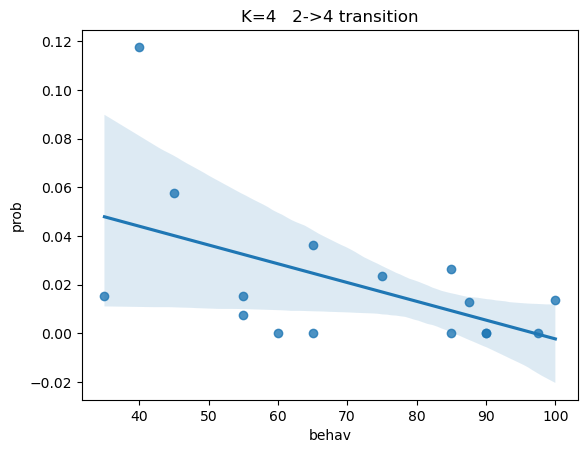

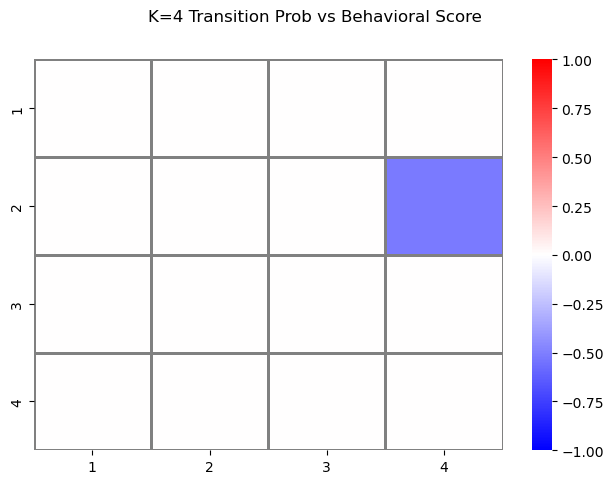

In [37]:
%%time

n_rep= 5000

cov_df = pd.read_csv("../data/covariates/covariates.csv",delimiter=",")
age_B = cov_df.loc[classif.loc[classif['CLASS']=='B'].index]['Age'].values
age_NB = cov_df.loc[classif.loc[classif['CLASS']=='NB'].index]['Age'].values
tstroke_B = cov_df.loc[classif.loc[classif['CLASS']=='B'].index]['Time since stroke (months)'].values
tstroke_NB = cov_df.loc[classif.loc[classif['CLASS']=='NB'].index]['Time since stroke (months)'].values
# age_B, age_NB, tstroke_B, tstroke_NB


B_behav = []
NB_behav = []
print('ahahha')
class_vals = classif['CLASS'].values
Behav = classif['CLASS'].values

res = classif['Average % correct task'].values[:19]
res = [float(r) for r in res]
for i,r in enumerate(res):
    if class_vals[i]=='B': 
        B_behav.append(r)
    elif class_vals[i]=='NB':
        NB_behav.append(r)

behav = []
behav.append(B_behav)
behav.append(NB_behav)

behavs = behav[0] + behav[1]
age = list(age_B) + list(age_NB)
tstroke = list(tstroke_B) + list(tstroke_NB)



for i,K in enumerate(range(2,10+1)): # Loop over K
    if K==4:
        print('STATE '+str(K))
        state_names = [i+1 for i in range(K)]
        prob_trans_list = prob_trans_list_allK[i]
    
        pat_prob_trans = np.concatenate((prob_trans_list[1], prob_trans_list[2])) # Only patients, no controls
        print(pat_prob_trans.shape)
        
        corr_matrix = np.zeros(pat_prob_trans.shape[1:])
        p_matrix = np.zeros(pat_prob_trans.shape[1:])
        x = B_behav + NB_behav
    
        for i in range(K):
            for j in range(K):
                y = pat_prob_trans[:,i,j]
                my_df = pd.DataFrame.from_dict({'behav':x, 'prob':pat_prob_trans[:,i,j], 'age':age, 'tstroke':tstroke})
                pc = partial_corr(data=my_df, x='behav', y='prob', covar=['tstroke'],method="spearman").round(3)
                # pc = pg.corr(x=my_df['behav'], y=my_df['prob'], method="spearman").round(3)
    
                stat = pc['r'].values[0]
                p_val = pc['p-val'].values[0]
                corr_matrix[i,j] = stat
                p_matrix[i,j] = p_val
    
                # Plot the regression
                if p_val<=0.05:
                    fig = plt.figure()
                    sns.regplot(data=my_df, x='behav', y='prob')
                    plt.title('K='+str(K)+'   '+str(i+1)+'->'+str(j+1)+' transition')
                    plt.savefig('output/AB_15052024/K'+str(K)+'/TransProbVsBehav_reg_K'+str(K)+'_nrep_test_'+str(n_rep)+'_'+baseline_fig_label[BASELINE]+'.png',
                            dpi=200)
                    
        print(corr_matrix)   
        print(p_matrix)
                
        fig, ax = plt.subplots(1)
        my_sup = plt.suptitle('K='+str(K)+' Transition Prob vs Behavioral Score', y=1)
        
        # display only significative values
        for i in range(K):
            for j in range(K):
                if p_matrix[i][j]>=0.05:
                    corr_matrix[i][j]=0
        
        sns.heatmap(corr_matrix, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='bwr', annot=True,
                    ax=ax, vmin=-1, vmax=1, linecolor='grey');
        for t in ax.texts:
            if float(t.get_text())!=0:
                t.set_text(t.get_text()) #if the value is greater than 0.4 then I set the text 
            else:
                t.set_text("") # if not it sets an empty text
        
        plt.tight_layout()
    
        plt.savefig('output/AB_15052024/K'+str(K)+'/TransProbVsBehav_Cov_K'+str(K)+'_nrep_test_'+str(n_rep)+'_'+baseline_fig_label[BASELINE]+'.png',
                dpi=200)

# Correlation with behavioral data (old)

[[-0.03238138]]
PEARSON PearsonRResult(statistic=-0.1023216937666043, pvalue=0.7061152539642324)


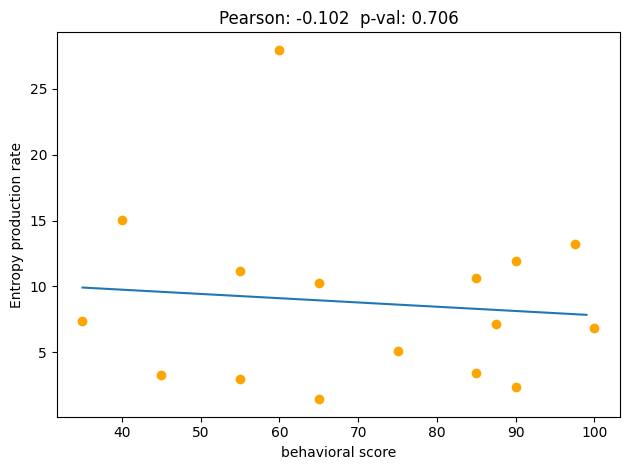

In [124]:
# PLOT ENTROPY PRODUCTION RATE WITH RESPECT TO BEAHVIORAL DATA
# Load beahvioral data

# today = date.today()
# DATE = today.strftime("%d%m%Y")
# # checking if the directory exists or not
# if not os.path.exists('output/GraphAnal/'+DATE+'/K'+str(K)):
      
#     # if the demo_folder directory is not present 
#     # then create it.
#     os.makedirs('output/GraphAnal/'+DATE+'/K'+str(K))


B_behav = []
NB_behav = []

class_vals = classif['CLASS'].values
Behav = classif['CLASS'].values

res = classif['Average % correct task'].values[:19]
res = [float(r) for r in res]
for i,r in enumerate(res):
    if class_vals[i]=='B': 
        B_behav.append(r)
    elif class_vals[i]=='NB':
        NB_behav.append(r)

behav = []
behav.append(B_behav)
behav.append(NB_behav)


fig = plt.figure()
behavs = behav[0] + behav[1]
Ss = []
for i,S in enumerate(Ss_for[1:]):
    plt.xlabel('behavioral score')
    plt.ylabel('Entropy production rate')
    Ss = Ss + S
    plt.scatter(behav[i], S, color='orange')
# plt.grid();

# Linear regresison
# reg = sm.OLS(behavs, Ss)
# reg_fit = reg.fit(behavs, Ss)
# p_values = reg_fit.summary2().tables[1]['P>|t|']
# # print(reg_fit.summary2())
# print(p_values)

regressor = LinearRegression() 
regressor.fit(np.asarray(behavs).reshape(-1, 1), np.asarray(Ss).reshape(-1, 1))
y_pred = regressor.predict(np.arange(np.min(behavs),np.max(behavs)).reshape(-1, 1))
plt.plot(np.arange(np.min(behavs),np.max(behavs)), y_pred[:,0])
print(regressor.coef_)
pirso = pearsonr(behavs, Ss)
print('PEARSON', pirso)
plt.title('Pearson: {}  p-val: {}'.format(round(pirso[0], 3), round(pirso[1], 3)))


# PLOT LIFETIME WITH RESPECT TO BEAHVIORAL DATA
plt.tight_layout()
# plt.savefig('output/GraphAnal/'+DATE+'/K'+str(K)+'/'+'EntropyVSbehavioral_'+ \
#             '_npick'+str(n_pick)+'_nsamp'+str(n_samp)+'_'+DATE+'.png',
#             dpi=200)

(16, 3, 3)
(16, 4, 4)
(16, 5, 5)


/home/alessio/miniconda3/envs/bs_laido/lib/python3.12/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


(16, 6, 6)


/home/alessio/miniconda3/envs/bs_laido/lib/python3.12/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


(16, 7, 7)


/home/alessio/miniconda3/envs/bs_laido/lib/python3.12/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


(16, 8, 8)


/home/alessio/miniconda3/envs/bs_laido/lib/python3.12/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


(16, 9, 9)


/home/alessio/miniconda3/envs/bs_laido/lib/python3.12/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


(16, 10, 10)


/home/alessio/miniconda3/envs/bs_laido/lib/python3.12/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


(16, 11, 11)


/home/alessio/miniconda3/envs/bs_laido/lib/python3.12/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


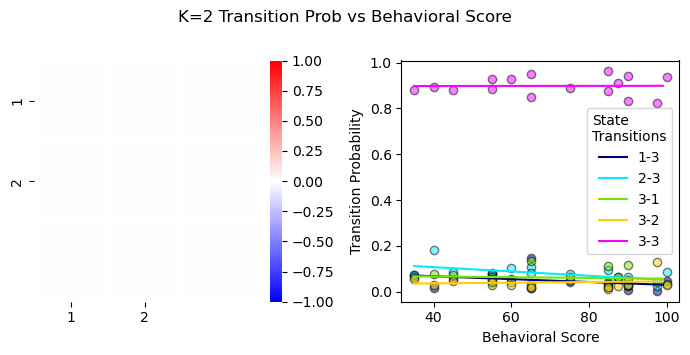

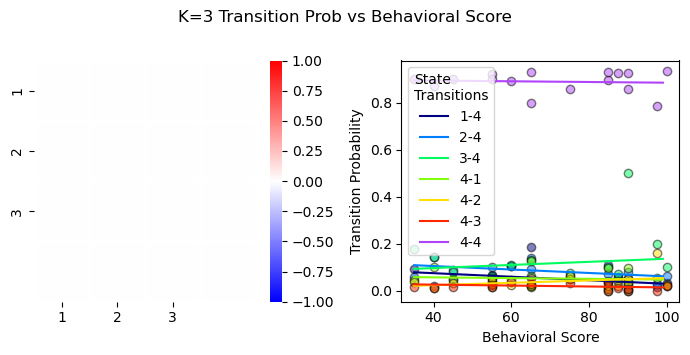

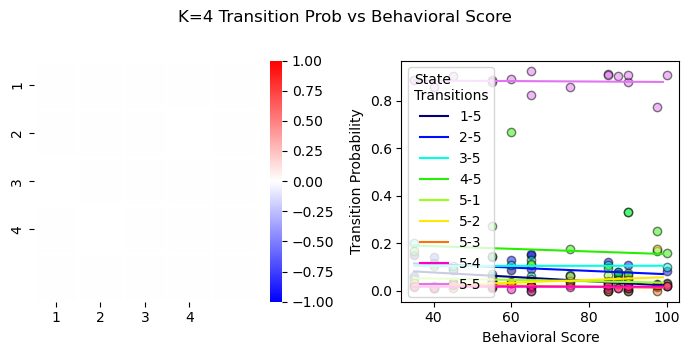

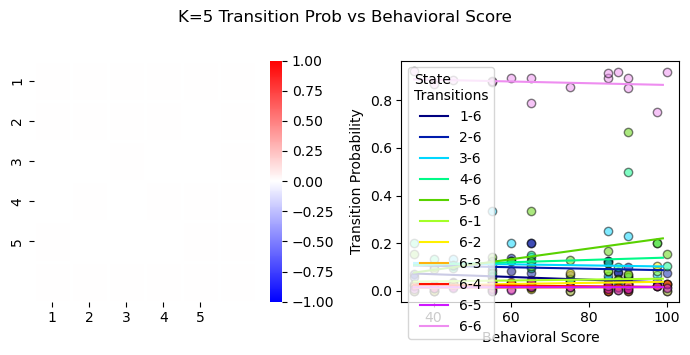

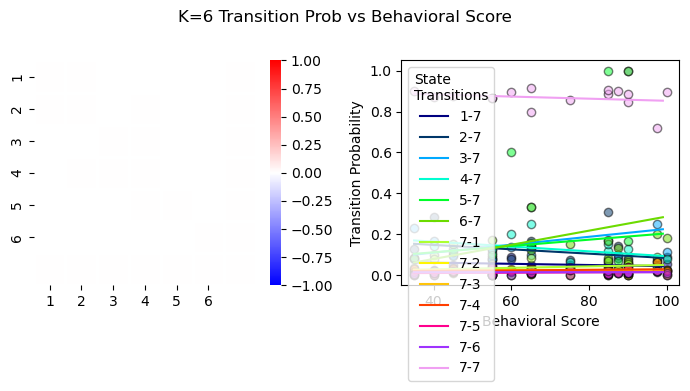

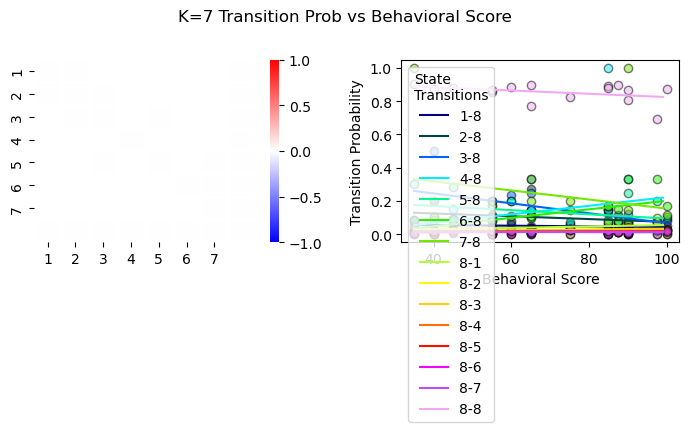

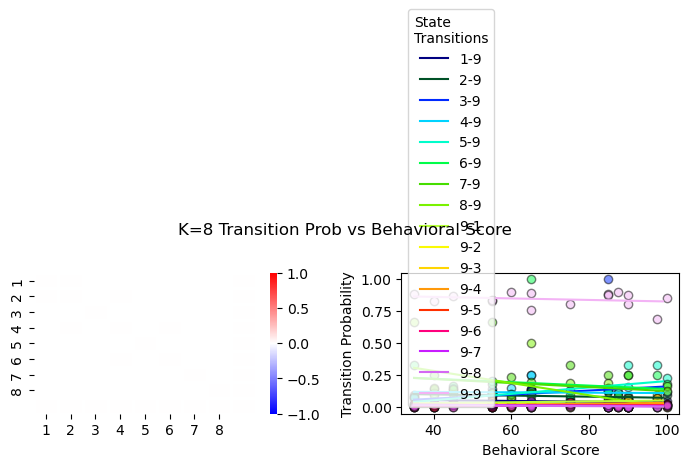

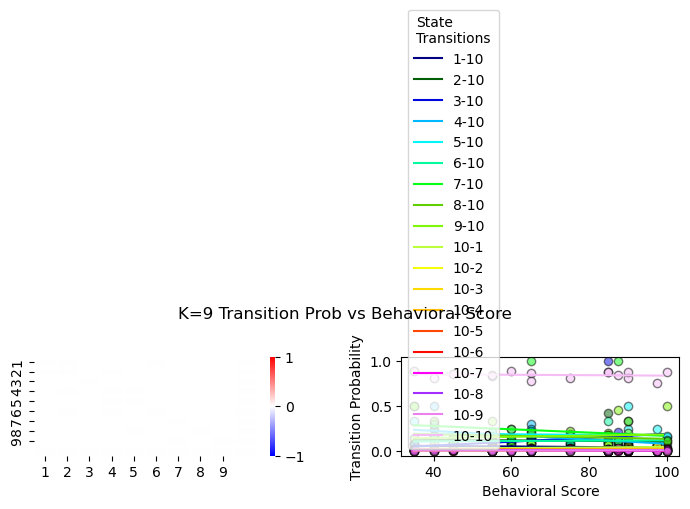

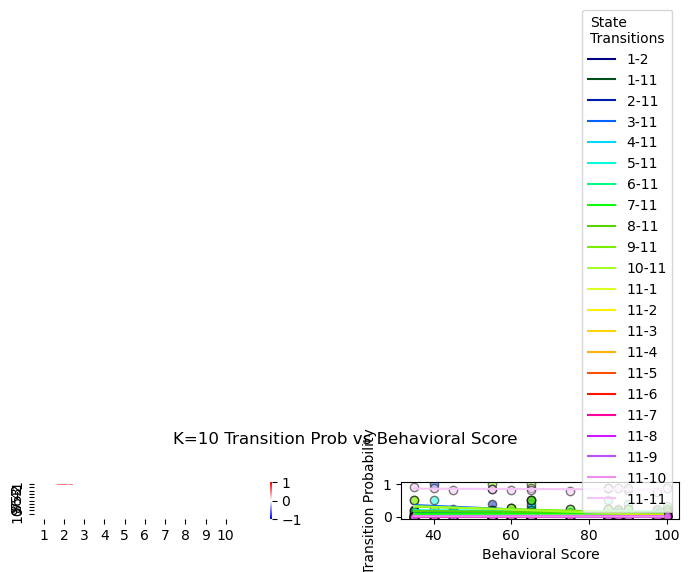

In [58]:
# TRANSITION PROBABILITIES with respect to behavioral data

# today = date.today()
# DATE = today.strftime("%d%m%Y")
# # checking if the directory exists or not
# if not os.path.exists('output/GraphAnal/'+DATE+'/K'+str(K)):
      
#     # if the demo_folder directory is not present 
#     # then create it.
#     os.makedirs('output/GraphAnal/'+DATE+'/K'+str(K))
import pingouin as pg
B_behav = []
NB_behav = []

class_vals = classif['CLASS'].values
Behav = classif['CLASS'].values

res = classif['Average % correct task'].values[:19]
res = [float(r) for r in res]
for i,r in enumerate(res):
    if class_vals[i]=='B': 
        B_behav.append(r)
    elif class_vals[i]=='NB':
        NB_behav.append(r)

behav = []
behav.append(B_behav)
behav.append(NB_behav)

behavs = behav[0] + behav[1]



for i,K in enumerate(range(2,10+1)): # Loop over K
    state_names = [i+1 for i in range(K)]
    prob_trans_list = prob_trans_list_allK[i]

    pat_prob_trans = np.concatenate((prob_trans_list[1], prob_trans_list[2])) # Only patients, no controls
    print(pat_prob_trans.shape)
    
    corr_matrix = np.zeros(pat_prob_trans.shape[1:])
    p_matrix = np.zeros(pat_prob_trans.shape[1:])
    x = B_behav + NB_behav
    # fig = plt.figure()
    # plt.title('')
    for i in range(K):
        for j in range(K):
            y = pat_prob_trans[:,i,j]
    #         plt.scatter(x, y)
    #         plt.xlabel('behavioral score')
    #         plt.ylabel('Transition Probability')
    #         # LINEAR REGRESSION
    #         reg = sm.OLS(x, y)
    #         reg_fit = reg.fit()
    #         p_value = reg_fit.summary2().tables[1]['P>|t|']
            
    #         regressor = LinearRegression() 
    #         regressor.fit(np.asarray(x).reshape(-1, 1), np.asarray(y).reshape(-1, 1))
    #         y_pred = regressor.predict(np.asarray(x).reshape(-1, 1))
    #         corr_matrix[i,j] = regressor.coef_
    
            # PEARSON CORRELATION
    #         print(x)
    #         print(pearsonr(x,y))
    #         if pearsonr(x,y)[1]<=0.1:
            corr_matrix[i,j] = pearsonr(x,y)[0]
            p_matrix[i,j] = pearsonr(x,y)[1]
            
    #         plt.plot(x, y_pred[:,0], color=colors[i], label='State '+str(i+1))
    #         print(p_value)
    #         print(regressor.coef_)
    #         print('\n')
    fig, axs = plt.subplots(1,2, figsize=(7,3.5))
    my_sup = plt.suptitle('K='+str(K)+' Transition Prob vs Behavioral Score', y=1)
    
    # display only significative values
    for i in range(K):
        for j in range(K):
            if p_matrix[i][j]>=0.05:
                corr_matrix[i][j]=0
    
    sns.heatmap(corr_matrix, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='bwr', annot=True,
                ax=axs[0], vmin=-1, vmax=1);
    for t in axs[0].texts:
        if float(t.get_text())!=0:
            t.set_text(t.get_text()) #if the value is greater than 0.4 then I set the text 
        else:
            t.set_text("") # if not it sets an empty text
    
    # sns.heatmap(p_matrix, linewidth=0.8, xticklabels=state_names, yticklabels=state_names, cmap='Greens_r',
    #             annot=True, vmax=0.05, ax=axs[1])
    plt.tight_layout()
    # plt.savefig('output/GraphAnal/'+DATE+'/K'+str(K)+'/TransProbVSbehavioral_Heat_'+ \
    #             '_npick'+str(n_pick)+'_nsamp'+str(n_samp)+'_'+DATE+'.png',
    #             dpi=200, bbox_extra_artists=[my_sup], bbox_inches='tight')
    
    
    cord = np.where(p_matrix<0.05)
    cmap = plt.cm.gist_ncar  # define the colormap
    plt.style.use('default')
    # plt.style.use('ggplot')
    en = 0
    for i,j in zip(cord[0], cord[1]):
        y = pat_prob_trans[:,i,j]
        ols = linear_model.LinearRegression()
        model = ols.fit(np.expand_dims(x,axis=1), np.expand_dims(y,axis=1))
        response = model.predict(np.expand_dims(np.arange(np.min(x),np.max(x),1), axis=1))
        axs[1].scatter(x,y, edgecolor='k', facecolor=cmap(en/cord[0].shape[0]),
                   alpha=0.5)
        ci = pg.compute_bootci(x,y, func='pearson', paired=True)
        
        plt.plot(np.expand_dims(np.arange(np.min(x),np.max(x),1), axis=1), response,
                 color=cmap(en/cord[0].shape[0]), label=str(i+1)+'-'+str(j+1),
                 alpha=1)
        plt.xlabel('Behavioral Score')
        plt.ylabel('Transition Probability')
        plt.legend(title='State\nTransitions')
        
        en += 1
    plt.tight_layout()
    # plt.savefig('output/GraphAnal/'+DATE+'/K'+str(K)+'/'+'TransProbVSbehavioral_Slope_'+ \
    #         '_npick'+str(n_pick)+'_nsamp'+str(n_samp)+'_'+DATE+'.png',
    #         dpi=200)
    break